 # Smote demo
 # Credit Card Fraud Detection
 # - by Uddesh Soman
 The AI Club by Shailendra Kadre
 


# Content Introduction
The dataset contains transactions made by credit cards in September 2013 by European cardholders.
This dataset presents transactions that occurred in two days, where we have 492 frauds out of 284,807 transactions. The dataset is highly unbalanced, the positive class (frauds) account for 0.172% of all transactions.

It contains only numerical input variables which are the result of a PCA transformation. Unfortunately, due to confidentiality issues, we cannot provide the original features and more background information about the data. Features V1, V2, … V28 are the principal components obtained with PCA, the only features which have not been transformed with PCA are 'Time' and 'Amount'. Feature 'Time' contains the seconds elapsed between each transaction and the first transaction in the dataset. The feature 'Amount' is the transaction Amount, this feature can be used for example-dependant cost-sensitive learning. Feature 'Class' is the response variable and it takes value 1 in case of fraud and 0 otherwise.

Given the class imbalance ratio, we recommend measuring the accuracy using the Area Under the Precision-Recall Curve (AUPRC). Confusion matrix accuracy is not meaningful for unbalanced classification.

# General Description
Source : https://www.kaggle.com/mlg-ulb/creditcardfraud

Data : Credit Card Fraud Data

Problem type : Classification (binary)

Models : Logistic Regressor, Decision Tree Classifier, RandomForest Classifier, K-nearest Neighbour, XGBClassifier, SVM-Classifier


# Steps involved in the Project Development
# 1. Analysis of data
1. Analysing the properties of dataset.
2. Preparing the data (Filling nulls, Creating New features, etc).
3. Analysing te statistical parameters of data.

# 2. Exploratory Data Analysis
1. Individual analysis of features and their effect on target attribute.
2. Bivariate analysis of features to understand inter-dependencies.
3. Distribution with respect to target attribute.



In [1]:
# import required libraries
# numpy to deal with array operations
# pandas to create and manage Dataframes
# matplotlib and seaborn to visualize the data 
import numpy as np, pandas as pd, matplotlib.pyplot as plt, seaborn as sns
%matplotlib inline

# following code will prevent unnecessary warnings
import warnings
warnings.filterwarnings('ignore')

In [2]:
# importing the dataset
creditcard = pd.read_csv('creditcard.csv')
# seeing the first 5 columns to see the data.
creditcard.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [3]:
# seeing the Time column
creditcard.Time

0              0.0
1              0.0
2              1.0
3              1.0
4              2.0
            ...   
284802    172786.0
284803    172787.0
284804    172788.0
284805    172788.0
284806    172792.0
Name: Time, Length: 284807, dtype: float64

Here time attribute is time elapsed since first transaction. 

All other features are PCA transformed so no meaningful features can be derived from it.

Amount feature is amount of each transaction but due to lack of other features we cant derieve new feature from it.

In [4]:
# getting the head of data
creditcard.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [5]:
creditcard.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

All the input features in our dataset are continuous numerical and target attribut Class is discrete data with 0 for negative and 1 for positive.

In [6]:
creditcard.isnull().sum()

Time      0
V1        0
V2        0
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
Amount    0
Class     0
dtype: int64

In [7]:
# getting statistical overview of the data
creditcard.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Time,284807.0,9.481386e+04,47488.145955,0.000000,54201.500000,84692.000000,139320.500000,172792.000000
V1,284807.0,3.918649e-15,1.958696,-56.407510,-0.920373,0.018109,1.315642,2.454930
V2,284807.0,5.682686e-16,1.651309,-72.715728,-0.598550,0.065486,0.803724,22.057729
V3,284807.0,-8.761736e-15,1.516255,-48.325589,-0.890365,0.179846,1.027196,9.382558
V4,284807.0,2.811118e-15,1.415869,-5.683171,-0.848640,-0.019847,0.743341,16.875344
V5,284807.0,-1.552103e-15,1.380247,-113.743307,-0.691597,-0.054336,0.611926,34.801666
V6,284807.0,2.040130e-15,1.332271,-26.160506,-0.768296,-0.274187,0.398565,73.301626
V7,284807.0,-1.698953e-15,1.237094,-43.557242,-0.554076,0.040103,0.570436,120.589494
V8,284807.0,-1.893285e-16,1.194353,-73.216718,-0.208630,0.022358,0.327346,20.007208
V9,284807.0,-3.147640e-15,1.098632,-13.434066,-0.643098,-0.051429,0.597139,15.594995


The mean value of most of the features is far away from the mean value, also the min and max values of features are far from 25 percentile and 75 percentile values. Both these observations suggest that our data has outliers we will explore them in EDA section of this project.

In [3]:
#checking the prercentage of each target class in our dataset.
imb = creditcard[creditcard['Class'] == 1].shape[0]/creditcard.shape[0]
print(f'Percentage of dataset for target class <1> is {round(imb * 100, 4)} %')
print(f'Percentage of dataset for target class <0> is {round((1-imb)*100, 4)} %')

Percentage of dataset for target class <1> is 0.1727 %
Percentage of dataset for target class <0> is 99.8273 %


The dataset is extremely imbalanced.

Null accuracy means the accuracy score we will achieve even if all our predictions are made as negative class<0>. The accuracy of model needs to be better than this to even consider the model for prediction purpose.

Given the high imbalance in our dataset the null accuracy is 99.8273%. This makes the accuracy score meaningless. So we will use Evaluation tools such as Precision, Recall and AUC-ROC. As we will move to deal with the imbalanced dataset, we will encounter precision-recall tradeoff. We will use f-beta instead of f-1 as according to type of situation, effect of type 2 errors is important which we will see through recall score. Hence we will give more weight to recall while using f-beta scoring.



# Exploratory Data analysis

In [9]:
# all our varaibles are nunerical so lets get their histplot. and separate histplots for target Class variable
# function to make above mentioned plots.
sns.set_style('whitegrid')
ones = creditcard[creditcard['Class'] == 1]
zeros = creditcard[creditcard['Class'] == 0]
def histogram(col, data = creditcard, ones = ones, zeros= zeros):
    fig, ax = plt.subplots(1,3, figsize = (18,6))
    fig.suptitle(f'Distribution of {col}', fontsize = 20)
    ax[0].set_title('Distribution of {col}')
    sns.histplot(data[col], kde = True, ax = ax[0], color = '#09DE46')
    ax[1].set_title('Distribution for Positive class')
    sns.histplot(ones[col],bins = 50, kde = True, ax = ax[1], color = '#FCC20F')
    ax[2].set_title('Distribution for Negative class')
    sns.histplot(zeros[col], kde = True, ax = ax[2], color = '#DE3AF4')
    plt.tight_layout()
    plt.show()

In [10]:
# Scatter plot would give us meaningful insights about relation among the variables 
# we will see scatterplot of Time and Amount Attribute With target class as hue
# As the rest of features are PCA transformed , 
#seeing their distribution with respect to Time Elapsed would Be sufficient
def scatter(attrib):
    fig = plt.figure(figsize = (15, 15))
    plt.title(f'Scatterplot for Time vs {attrib}', fontsize = 20)
    sns.scatterplot(x = creditcard['Time'], y = creditcard[attrib], hue = creditcard['Class'])

In [11]:
# We need boxplots to get  factor statistical overview of the data. most importantly see the outliers

def box(attrib):
    fig = plt.figure(figsize = (10, 5))
    plt.title(f'Box plot for {attrib}', fontsize = 20)
    sns.boxplot(creditcard[attrib])

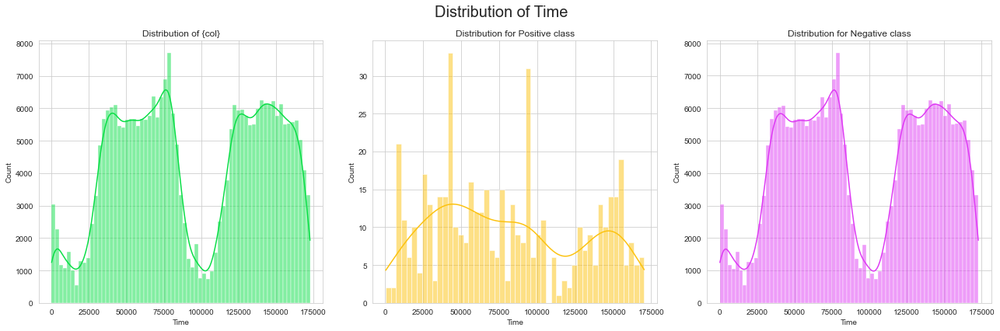

In [12]:
histogram('Time')

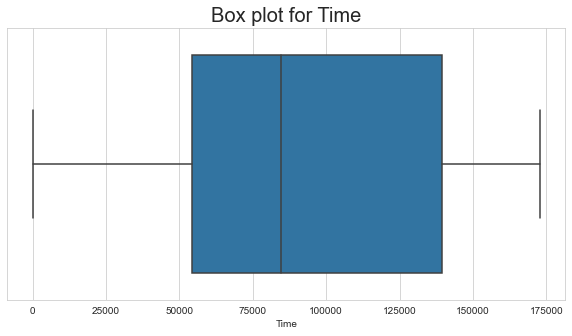

In [13]:
box('Time')

No outliers in Time

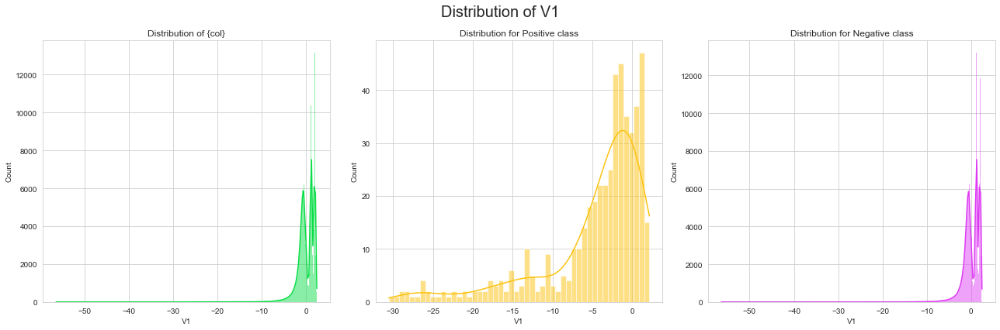

In [14]:
histogram('V1')

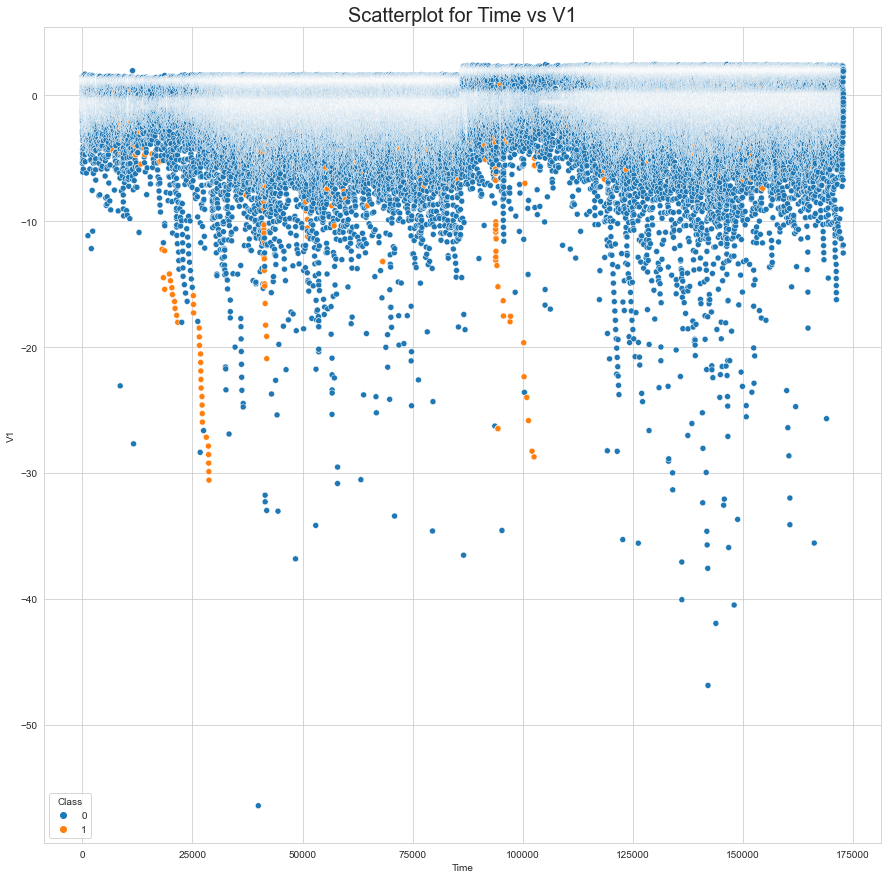

In [15]:
scatter('V1')

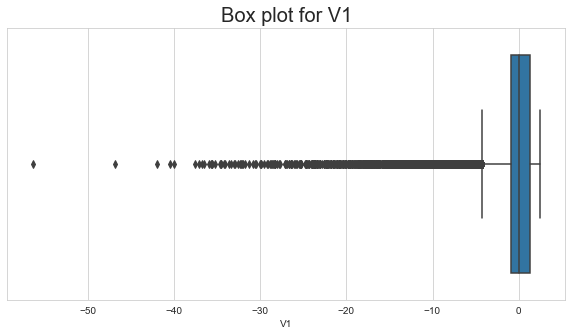

In [16]:
box('V1')

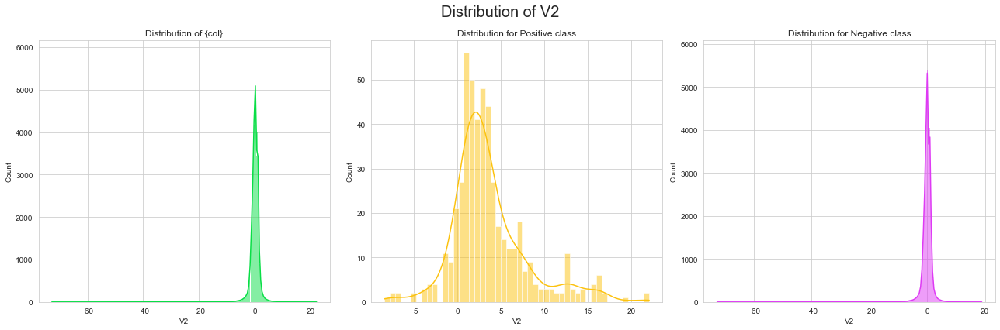

In [17]:
histogram('V2')

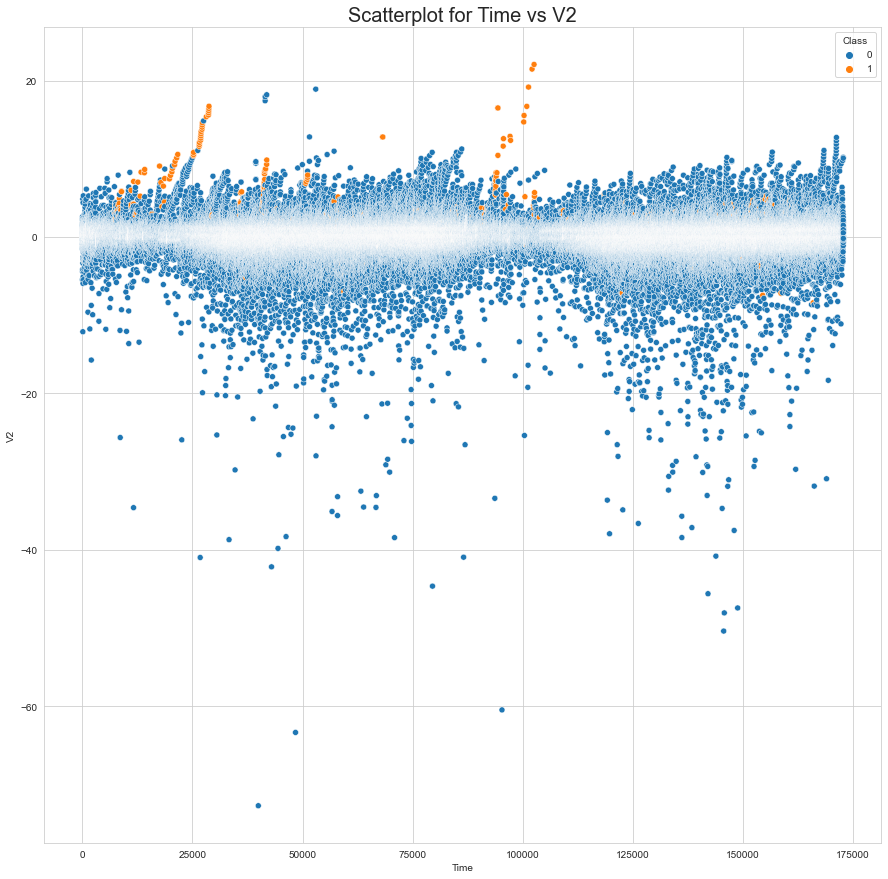

In [18]:
scatter('V2')

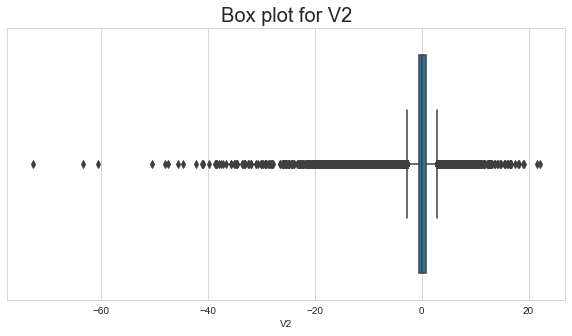

In [19]:
box('V2')

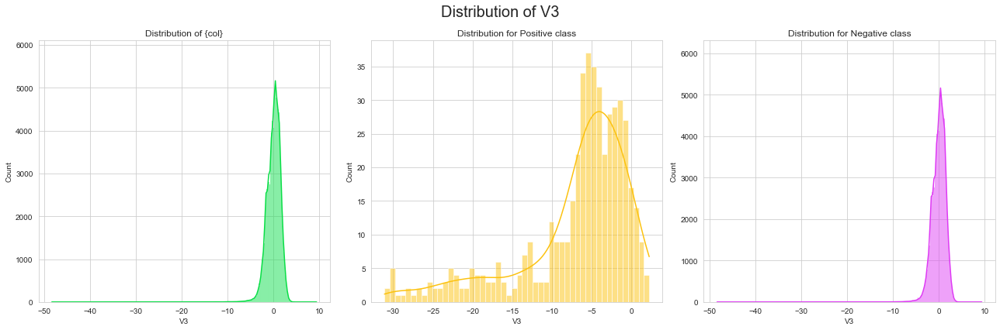

In [20]:
histogram('V3')

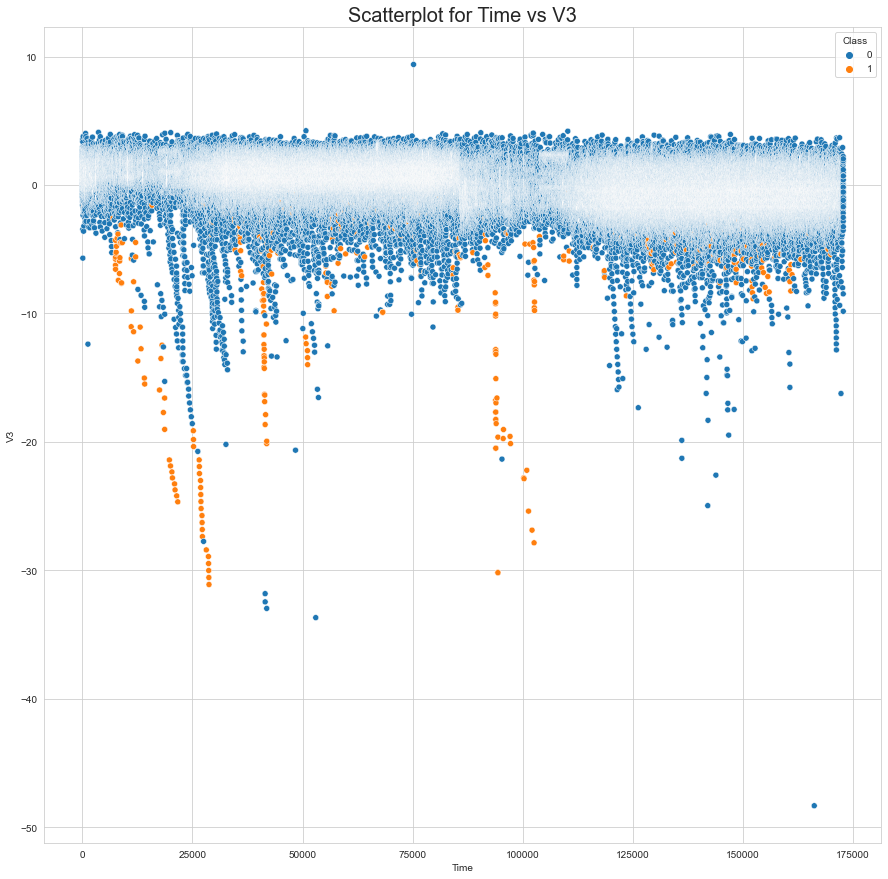

In [21]:
scatter('V3')

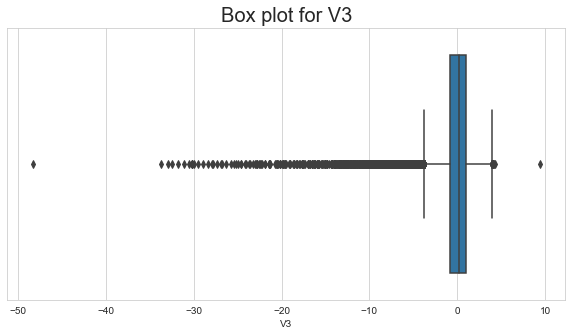

In [22]:
box('V3')

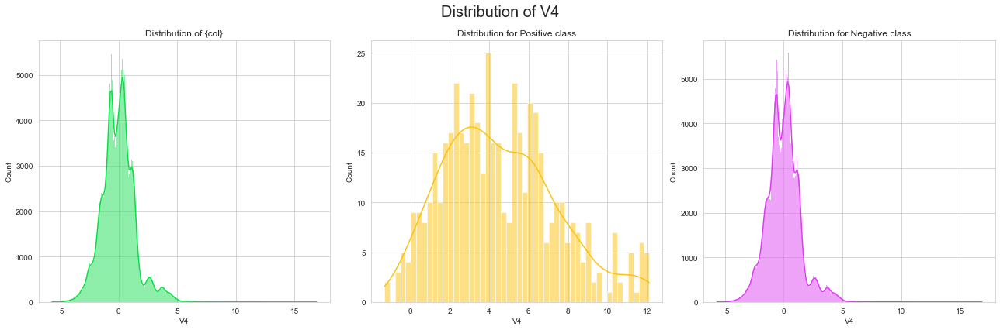

In [23]:
histogram('V4')

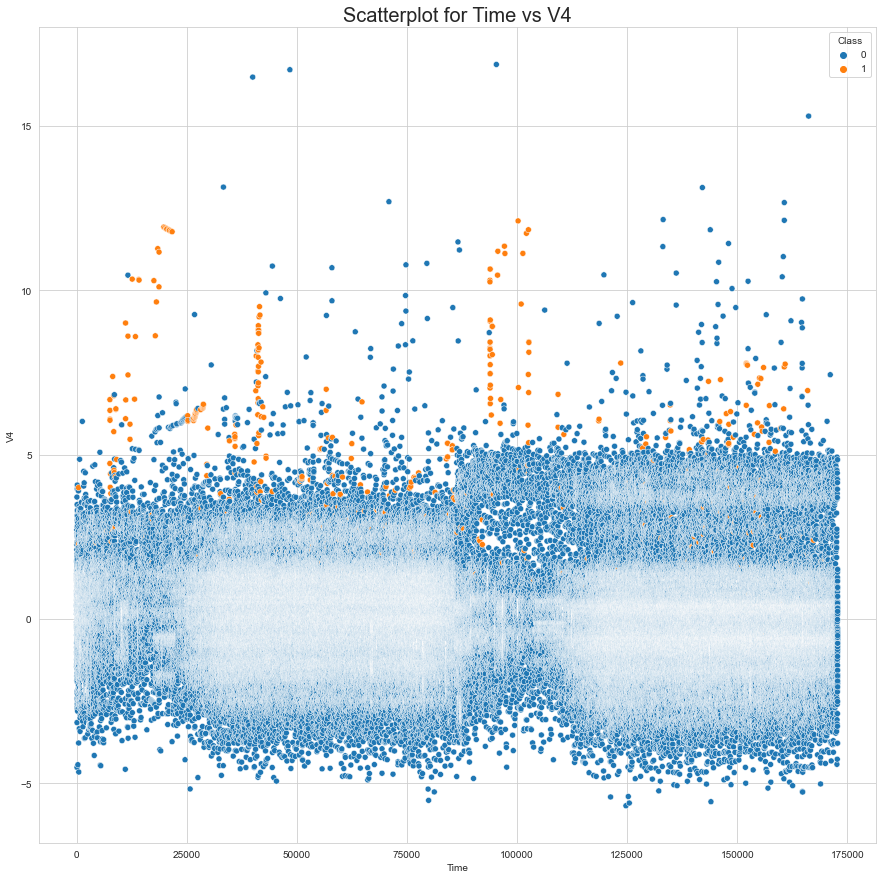

In [24]:
scatter('V4')

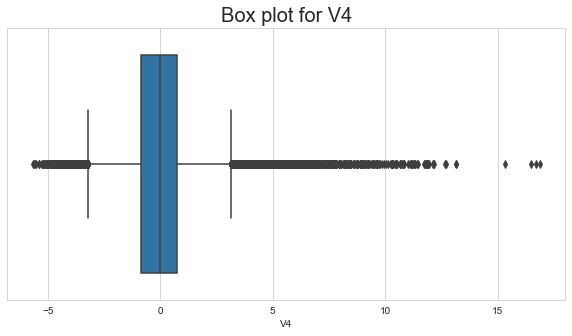

In [25]:
box('V4')

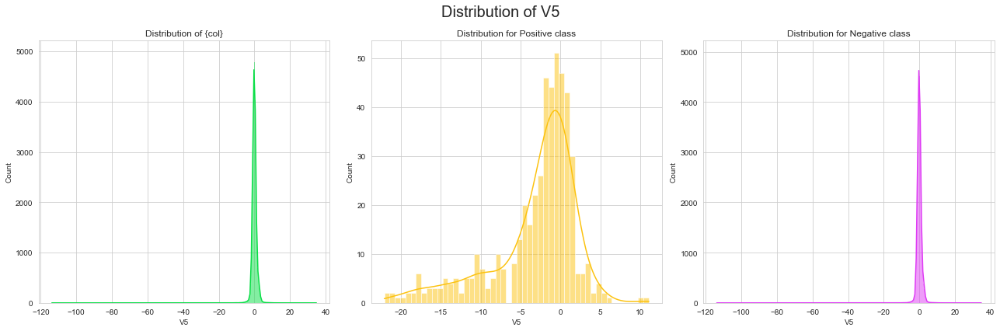

In [26]:
histogram('V5')

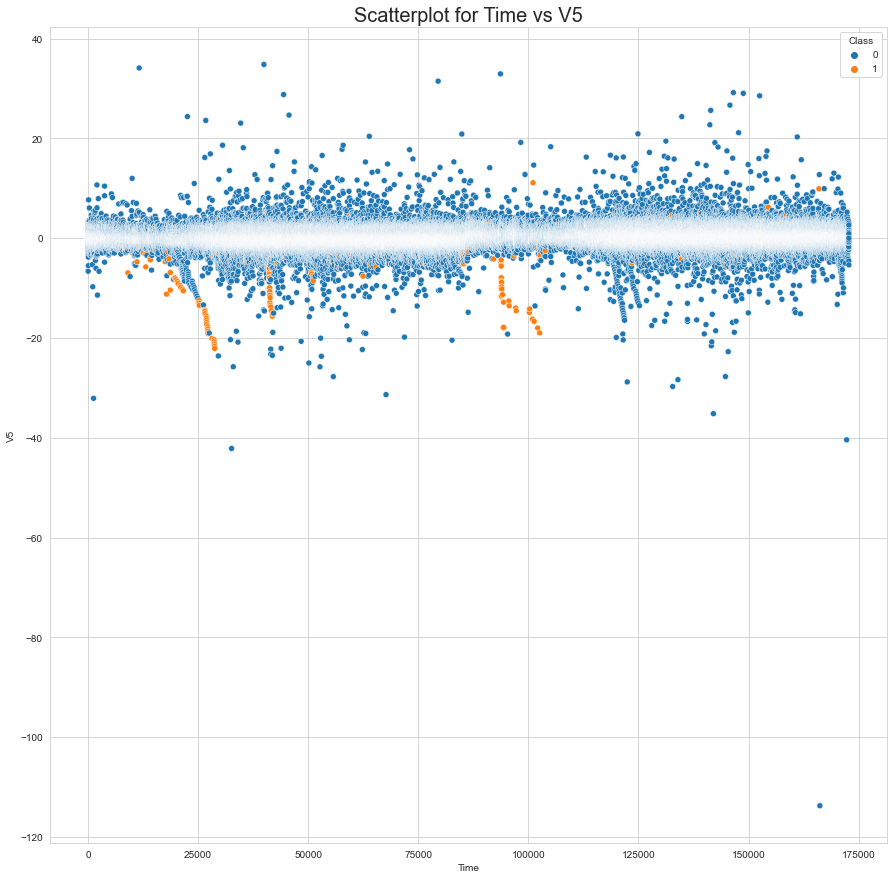

In [27]:
scatter('V5')

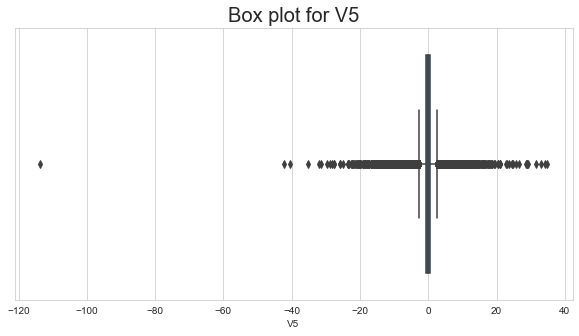

In [28]:
box('V5')

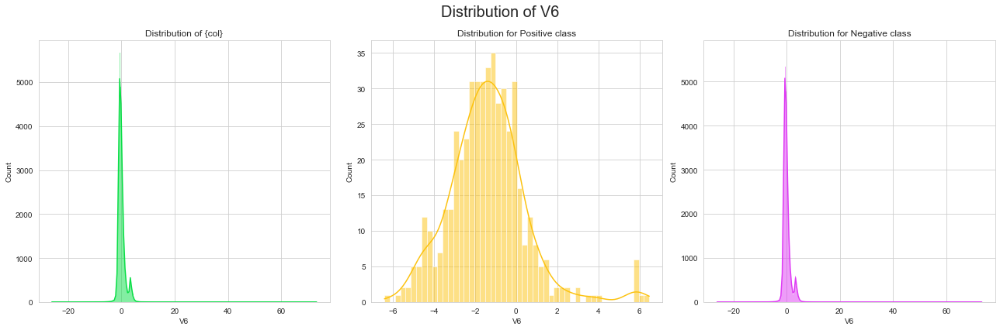

In [29]:
histogram('V6')

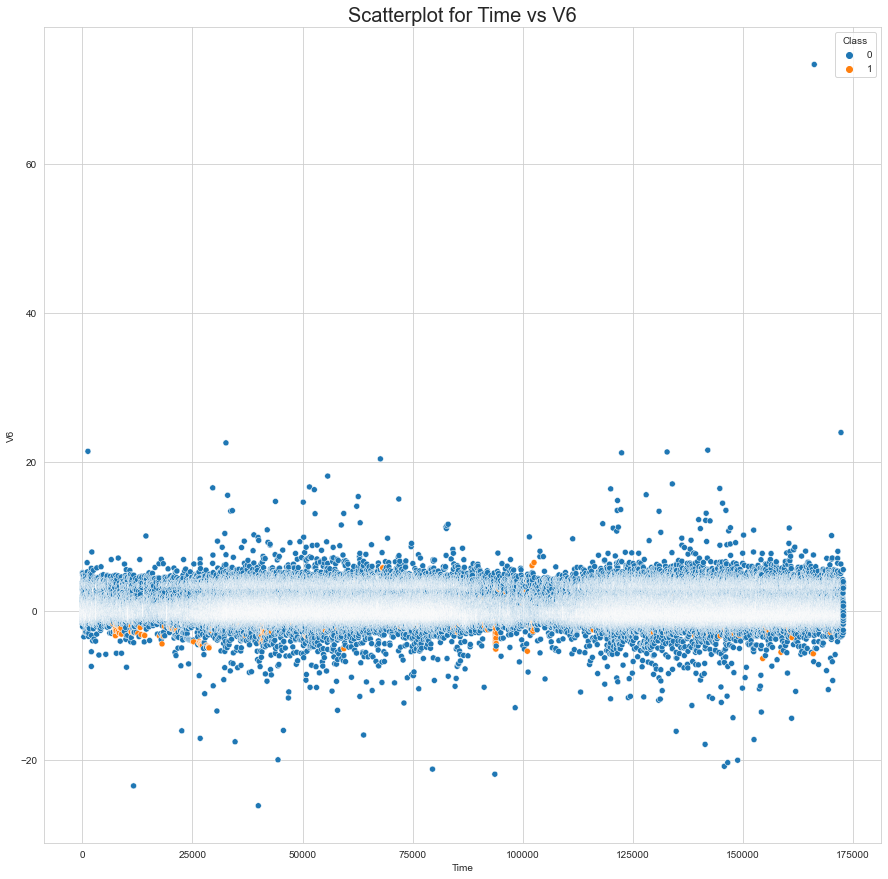

In [30]:
scatter('V6')

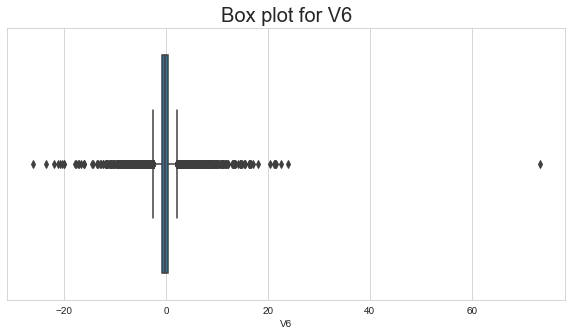

In [31]:
box('V6')

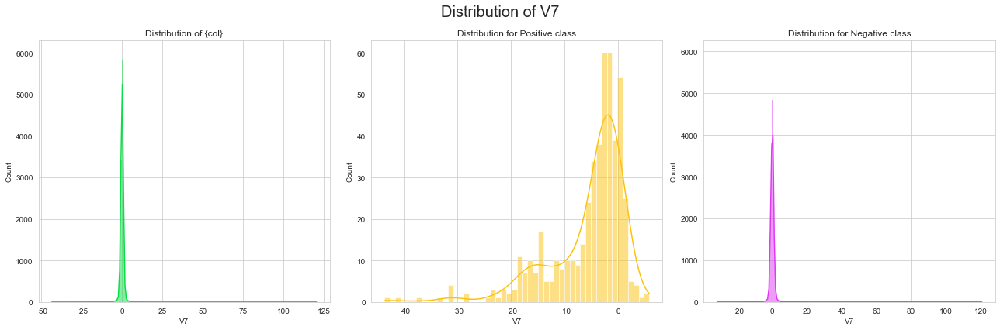

In [32]:
histogram('V7')

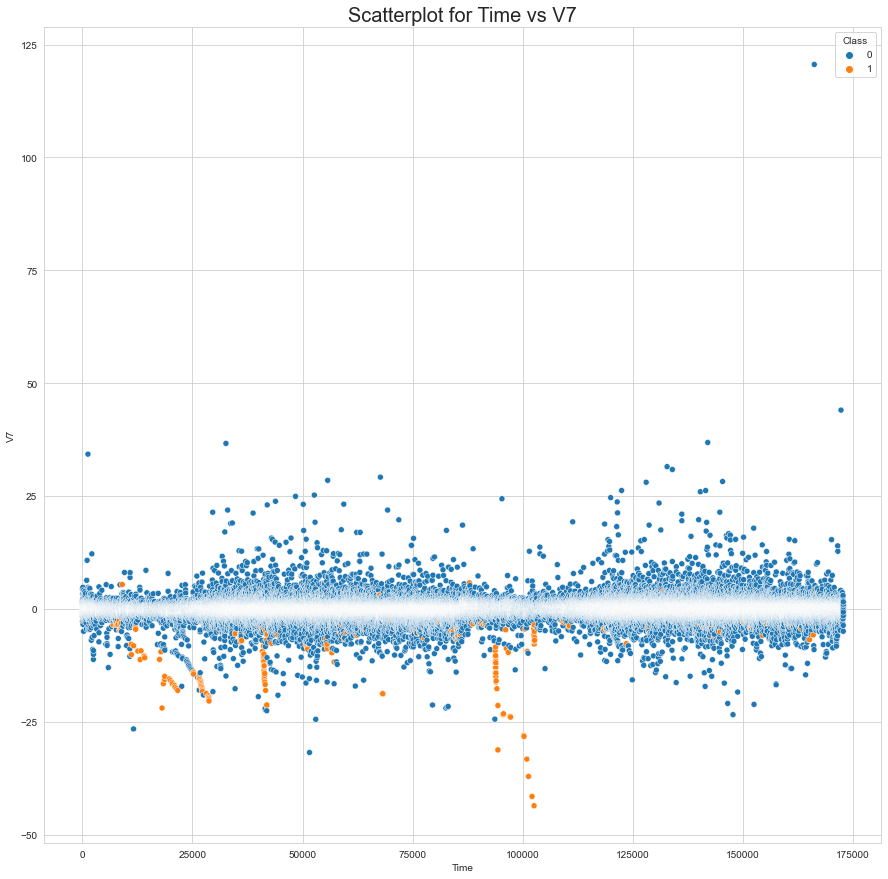

In [33]:
scatter('V7')

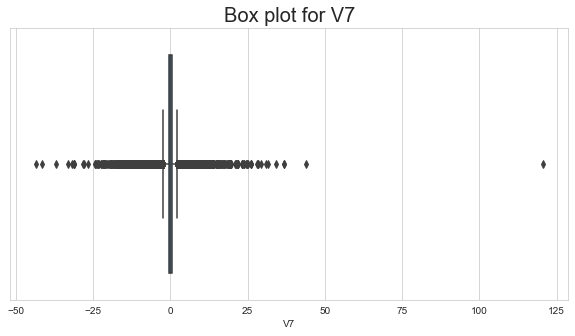

In [34]:
box('V7')

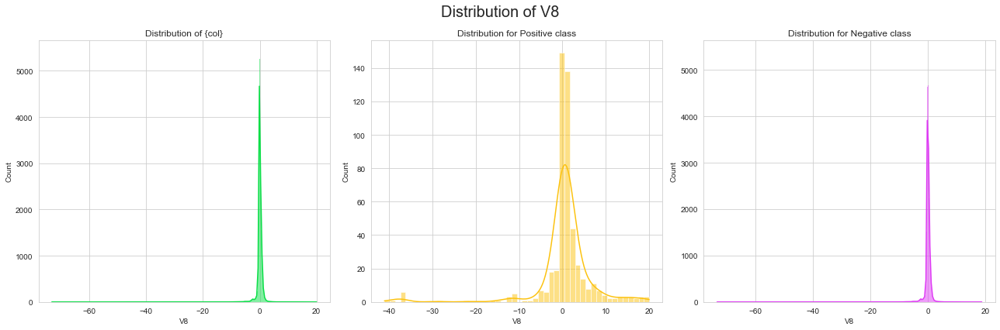

In [35]:
histogram('V8')

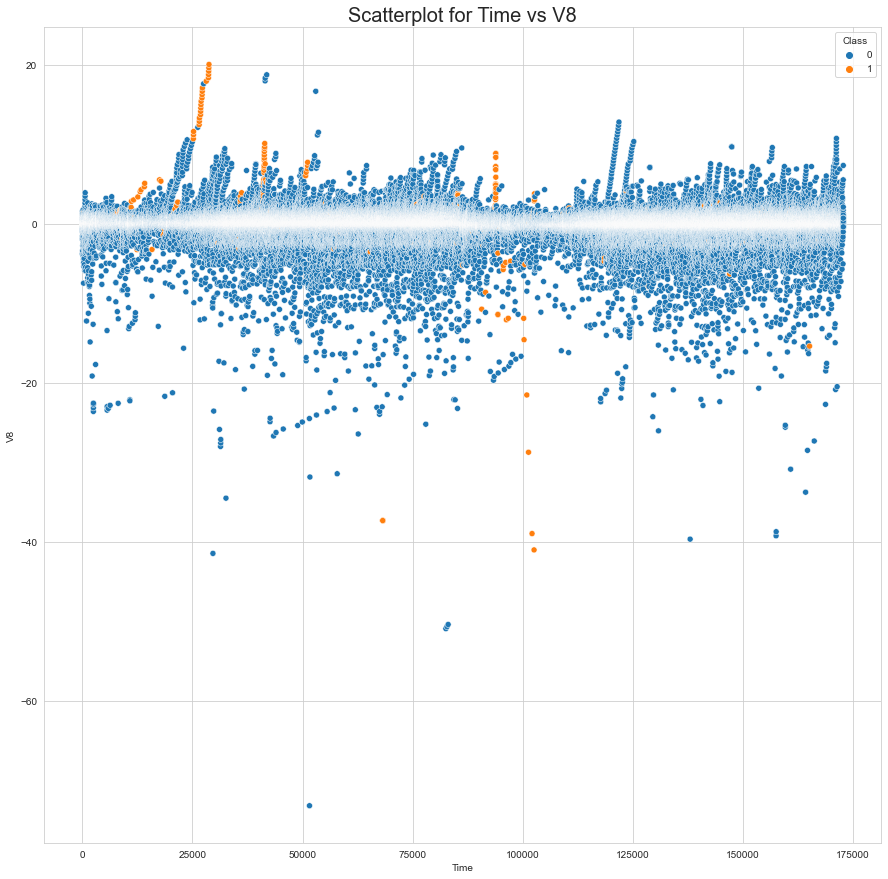

In [36]:
scatter('V8')

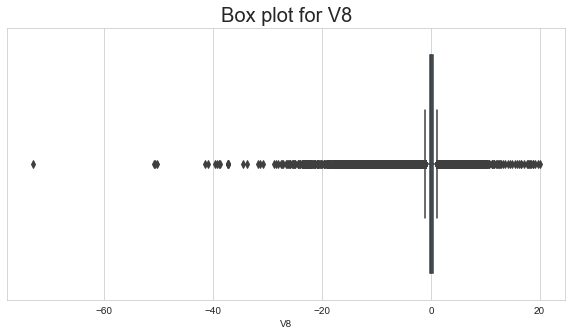

In [37]:
box('V8')

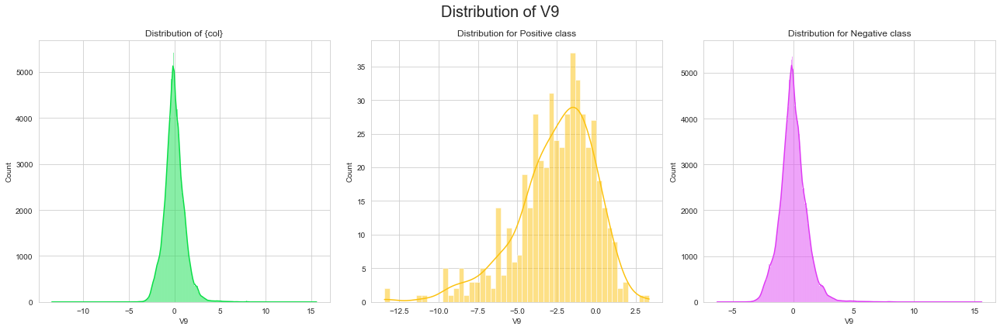

In [38]:
histogram('V9')

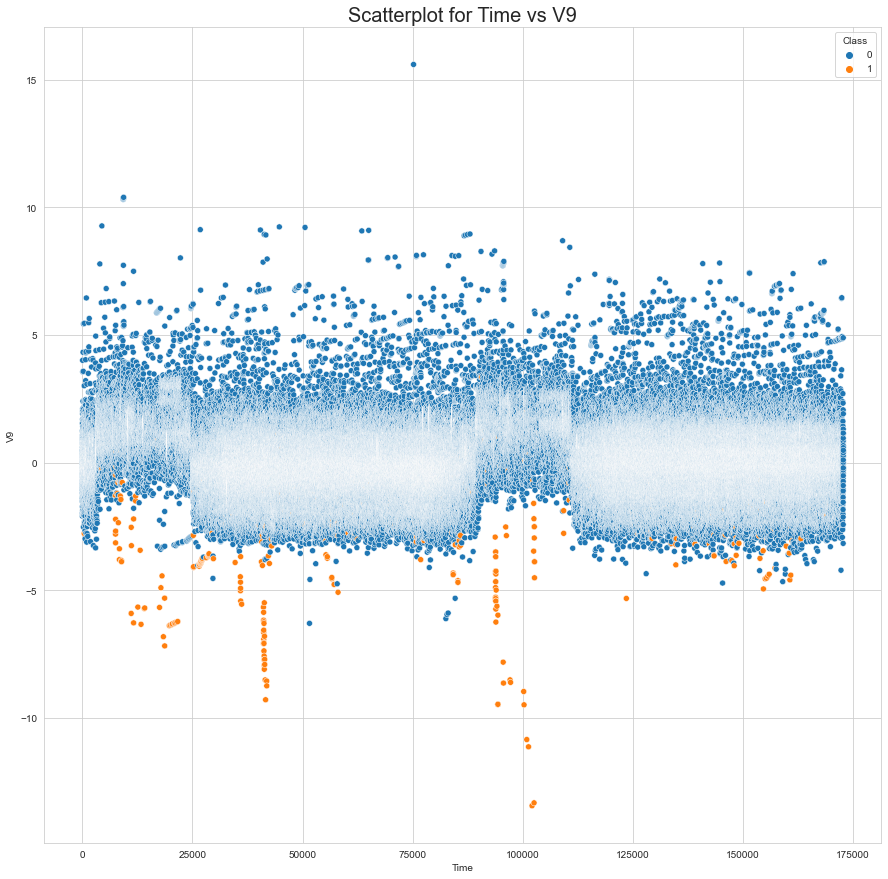

In [39]:
scatter('V9')

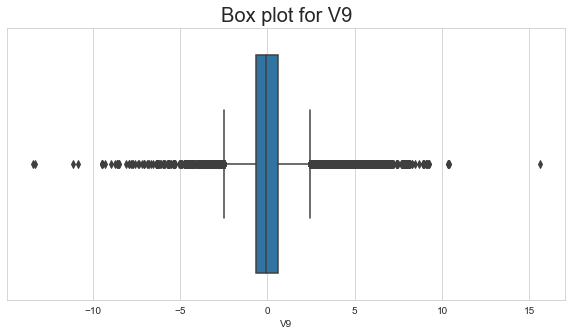

In [40]:
box('V9')

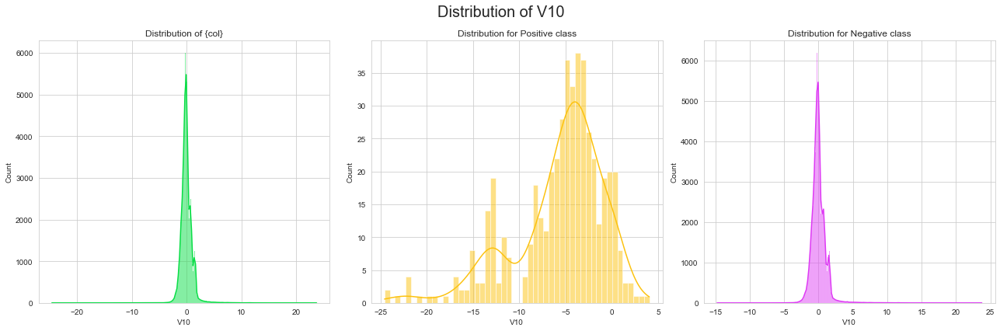

In [41]:
histogram('V10')

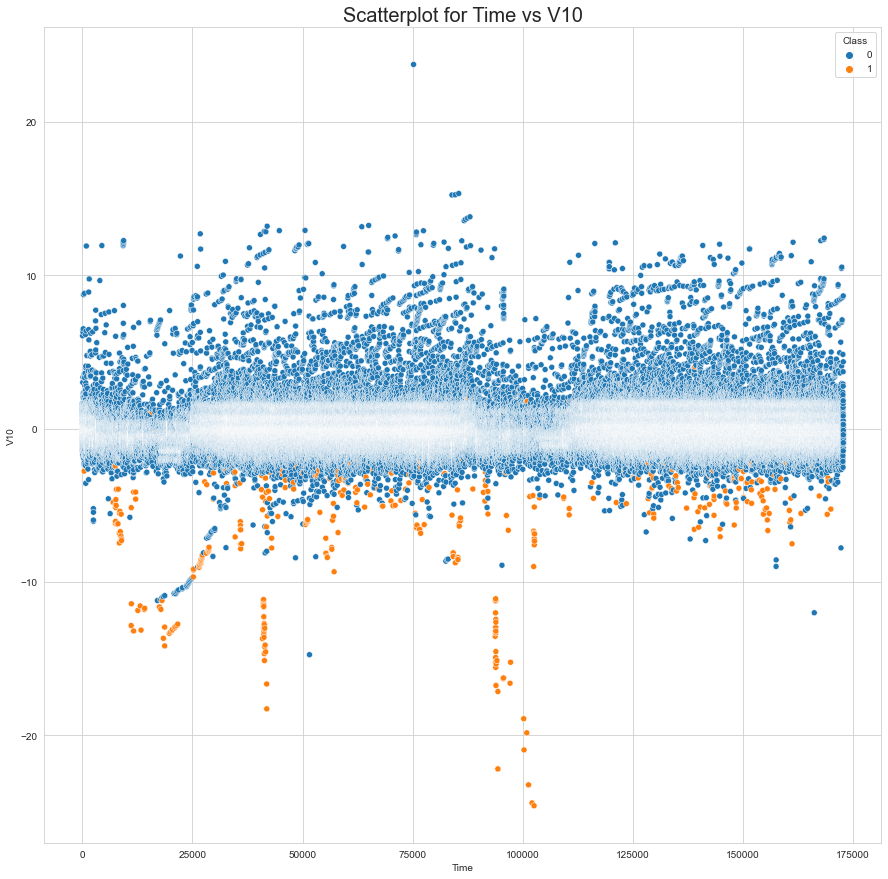

In [42]:
scatter('V10')

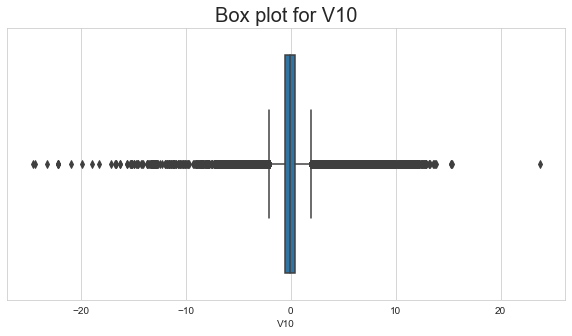

In [43]:
box('V10')

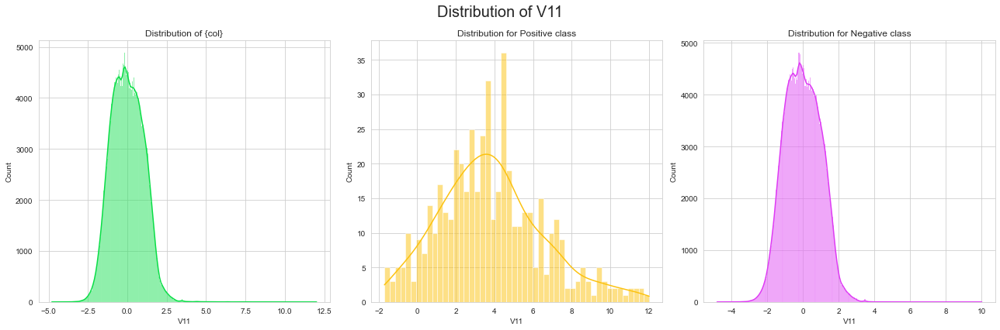

In [44]:
histogram('V11')

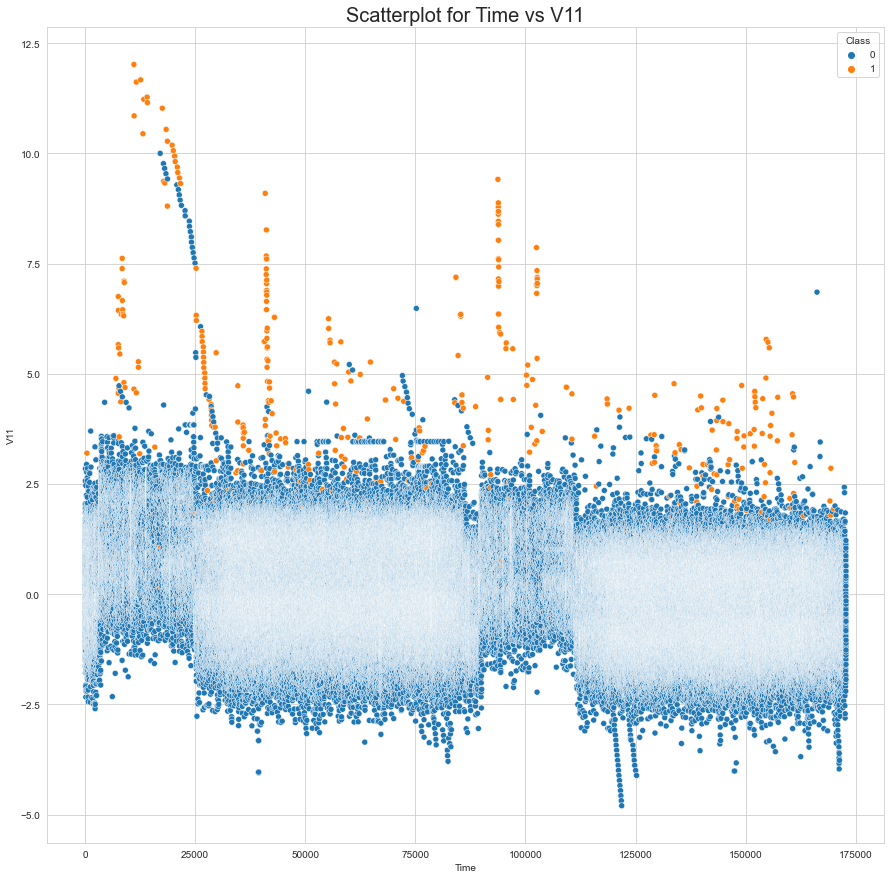

In [45]:
scatter('V11')

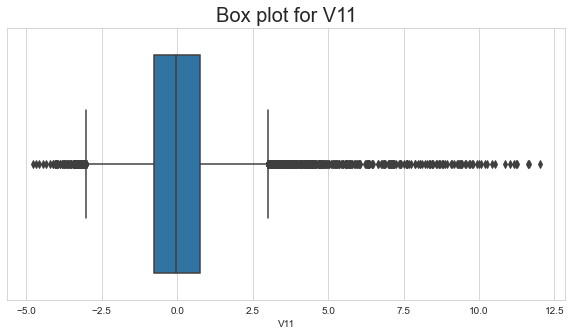

In [46]:
box('V11')

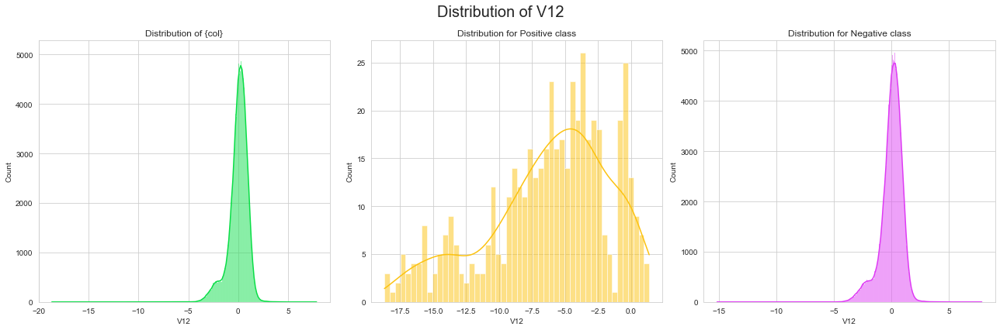

In [47]:
histogram('V12')

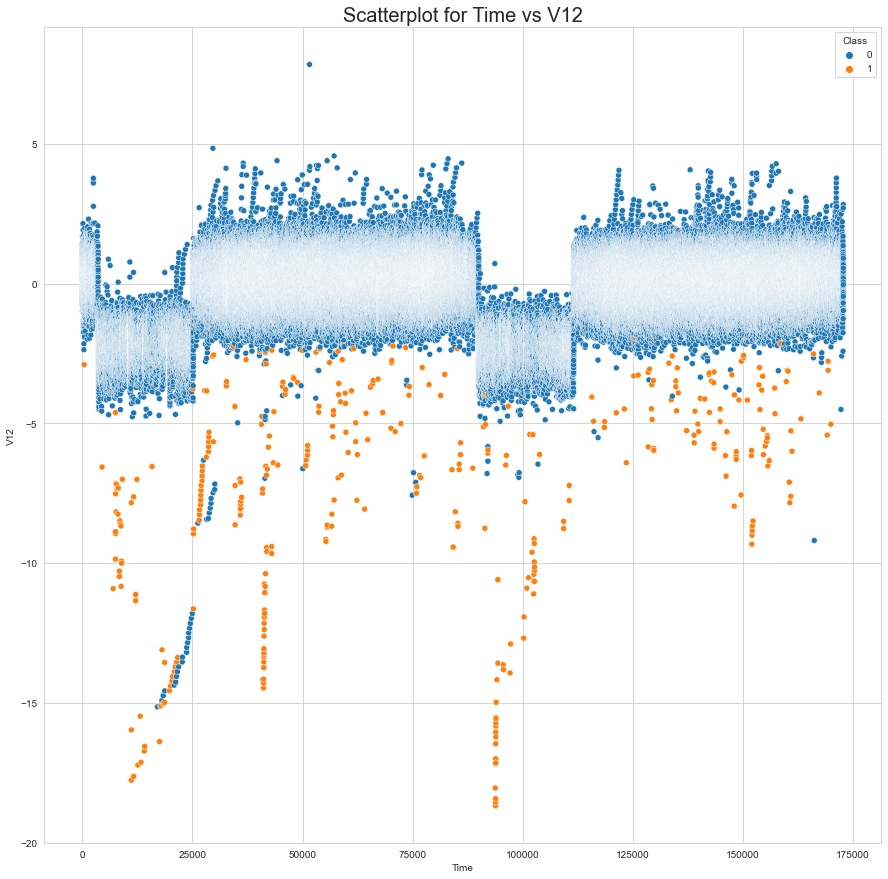

In [48]:
scatter('V12')

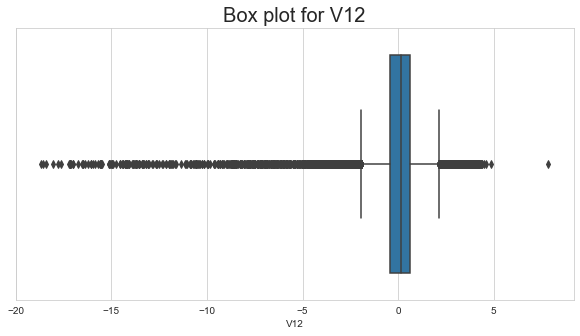

In [49]:
box('V12')

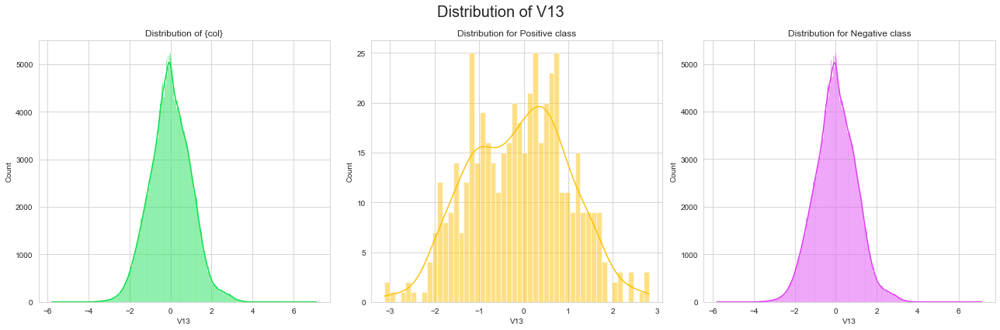

In [50]:
histogram('V13')

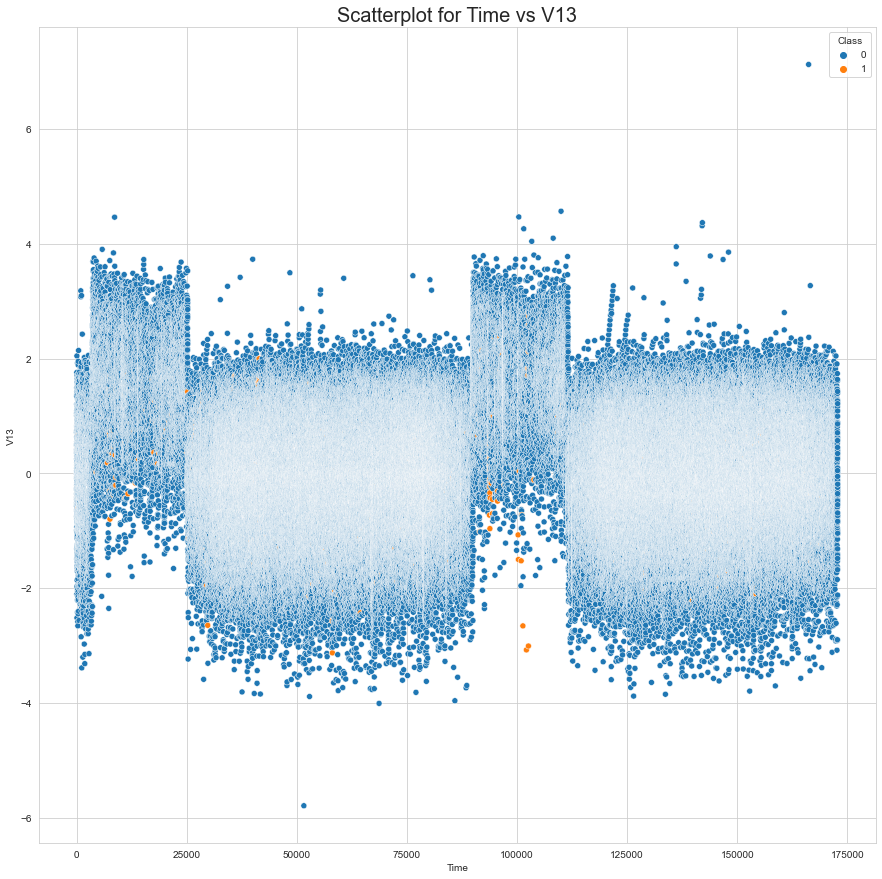

In [51]:
scatter('V13')

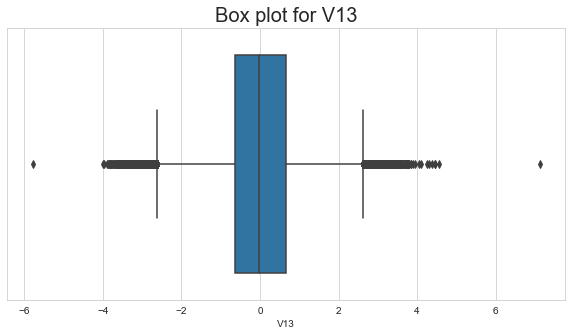

In [52]:
box('V13')

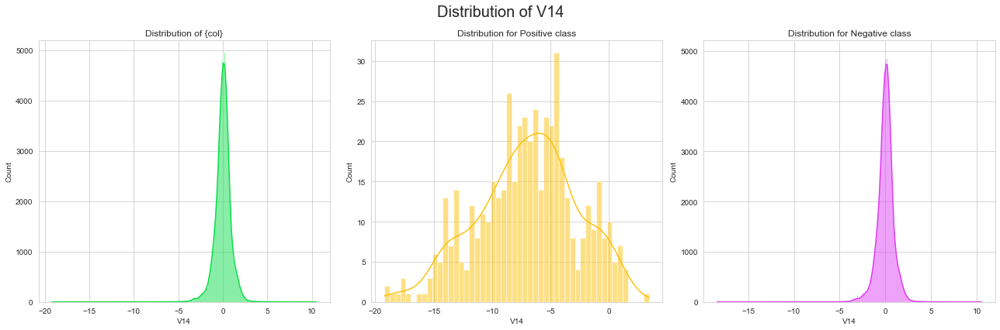

In [53]:
histogram('V14')

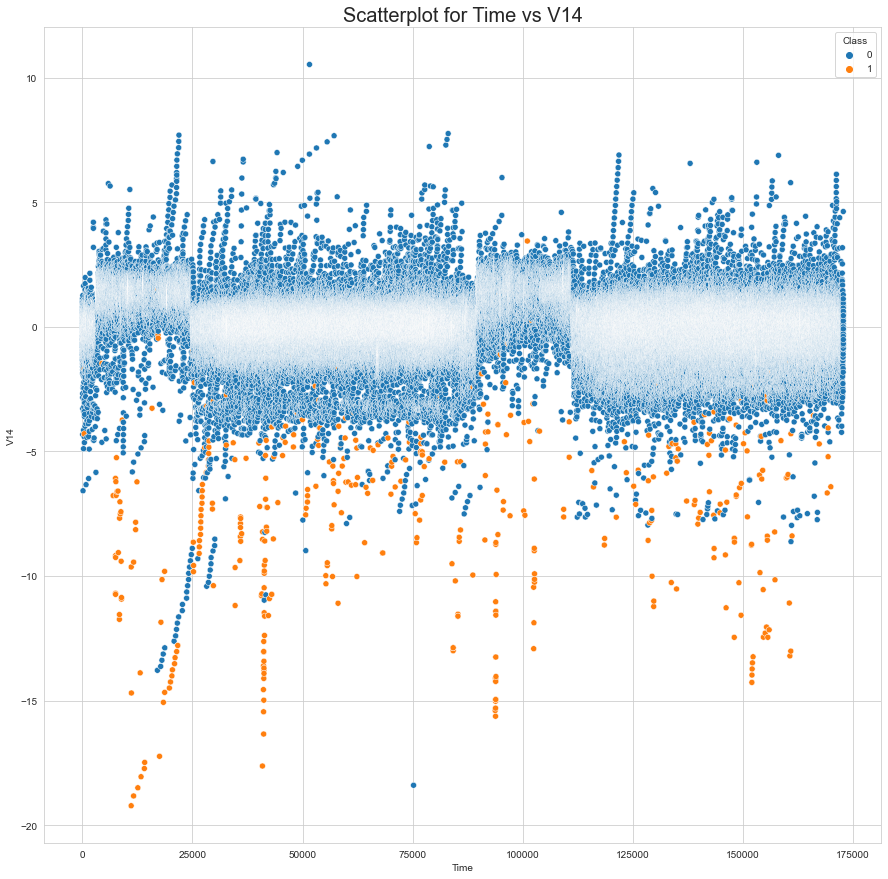

In [54]:
scatter('V14')

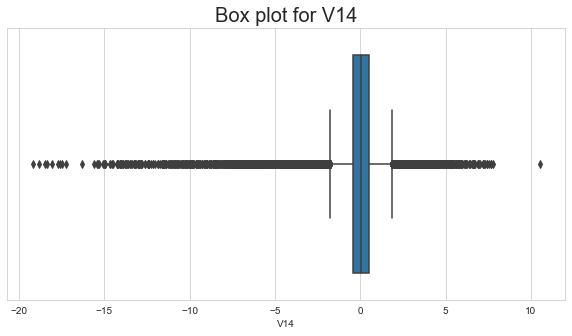

In [55]:
box('V14')

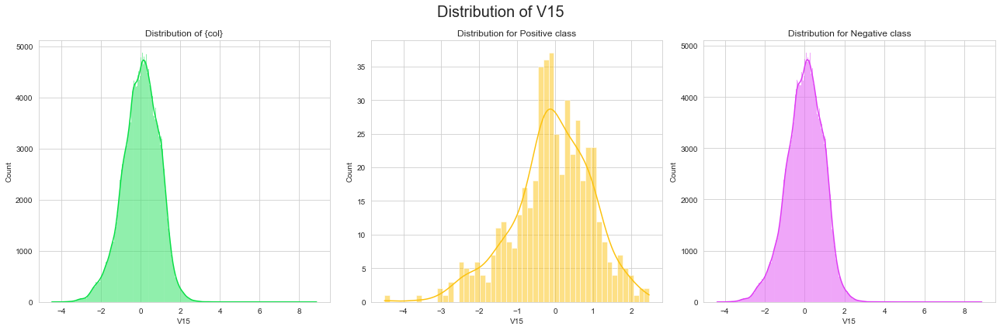

In [56]:
histogram('V15')

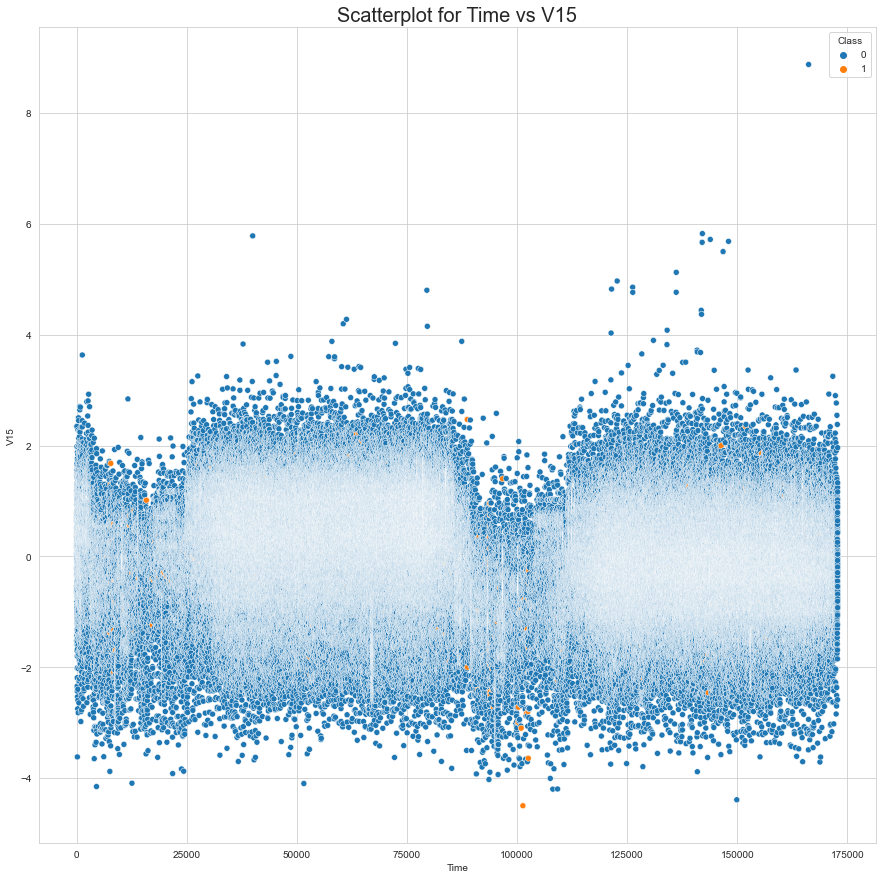

In [57]:
scatter('V15')

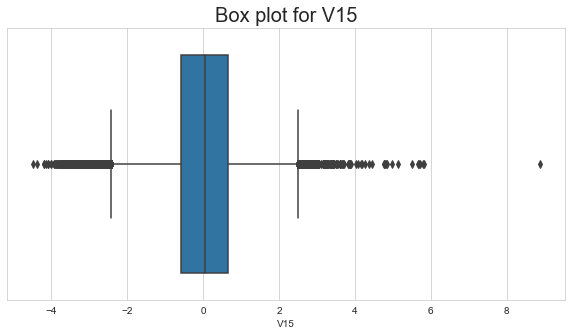

In [58]:
box('V15')

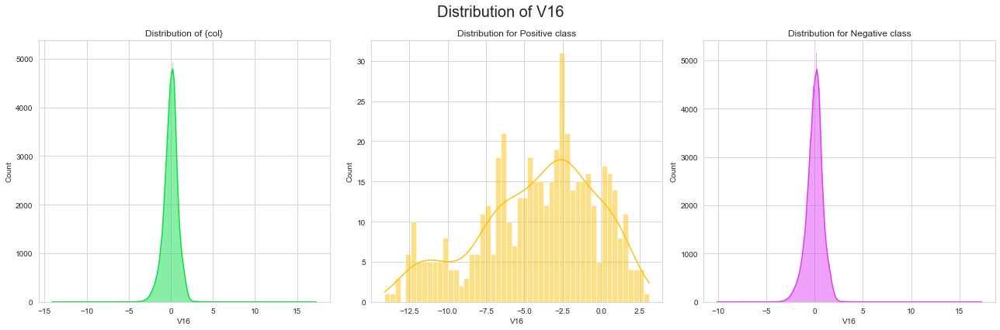

In [59]:
histogram('V16')

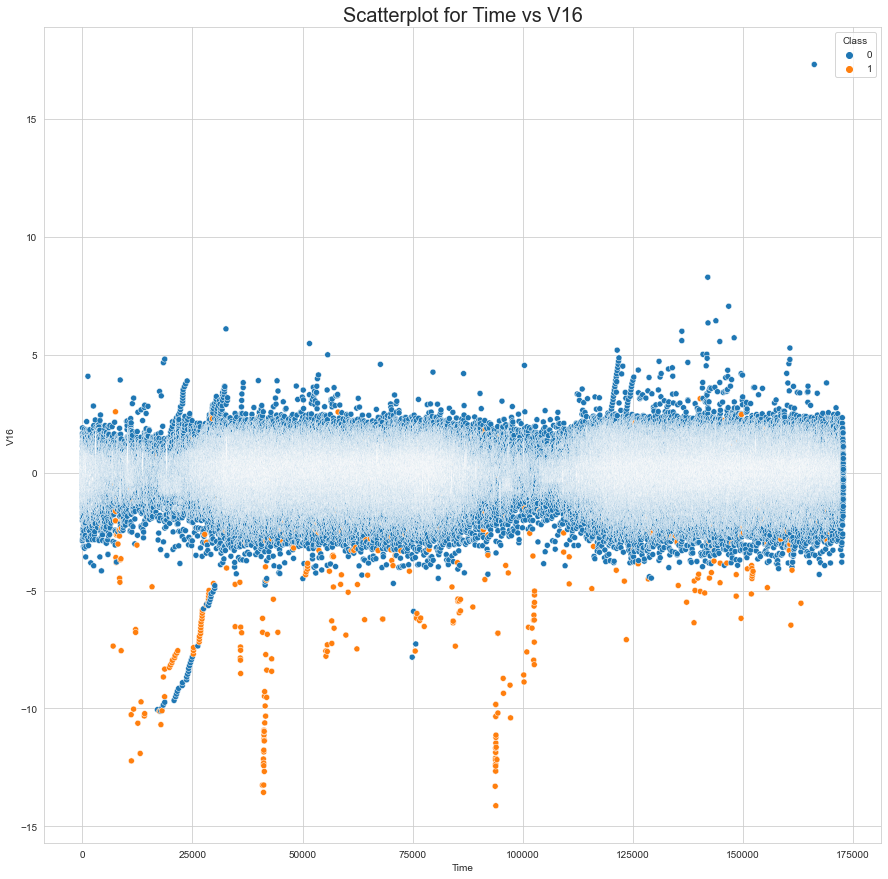

In [60]:
scatter('V16')

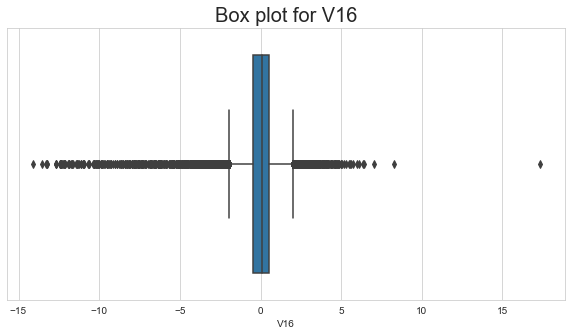

In [61]:
box('V16')

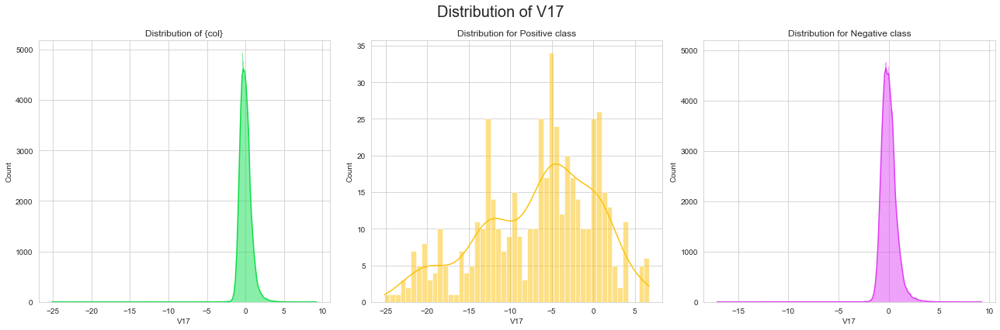

In [62]:
histogram('V17')

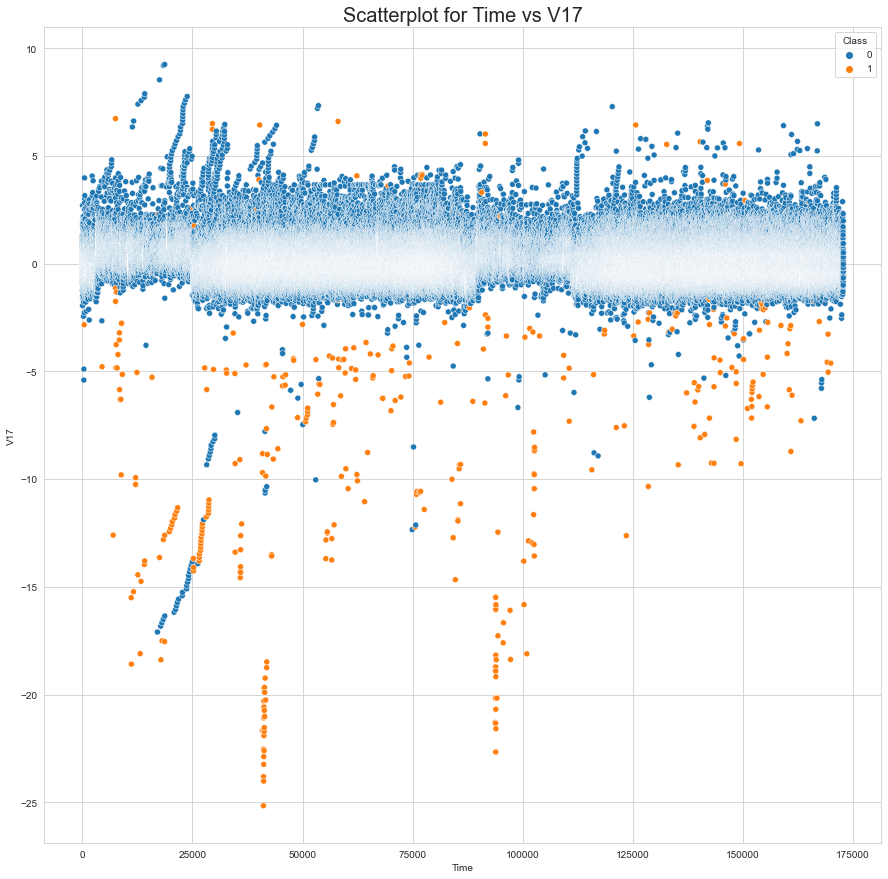

In [63]:
scatter('V17')

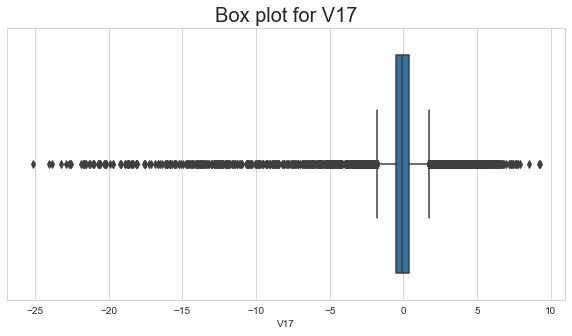

In [64]:
box('V17')

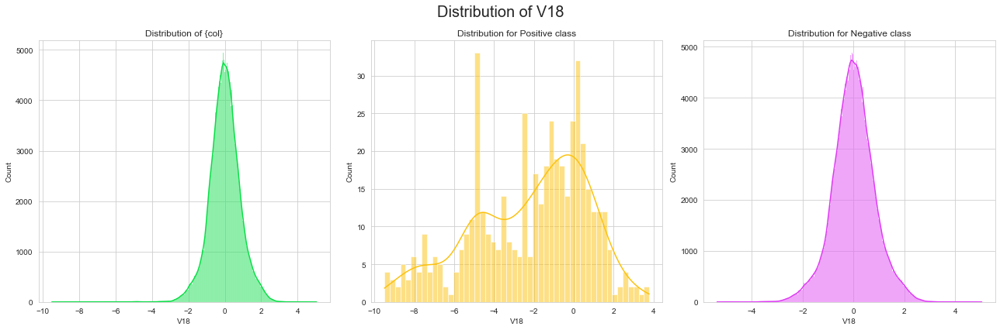

In [65]:
histogram('V18')

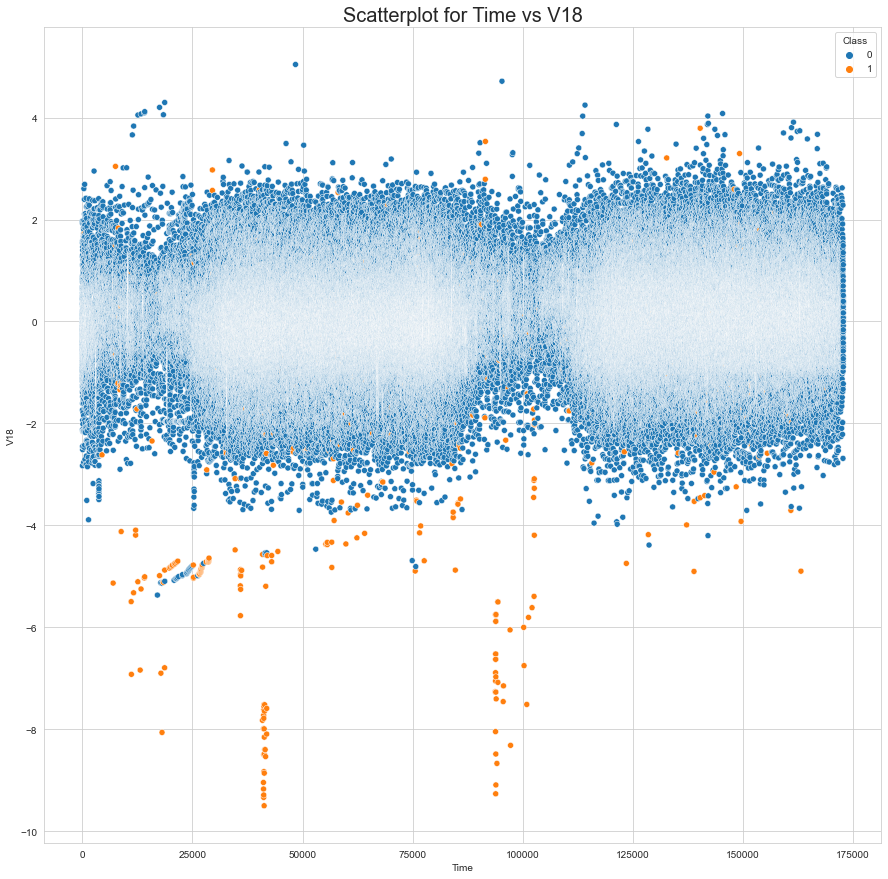

In [66]:
scatter('V18')

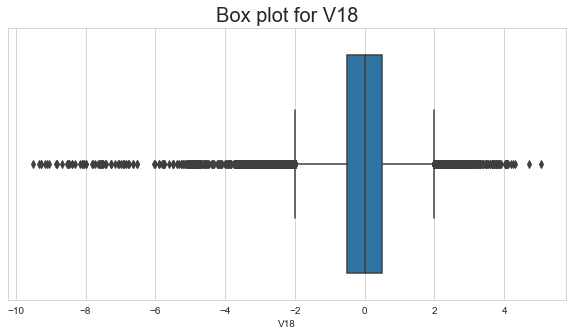

In [67]:
box('V18')

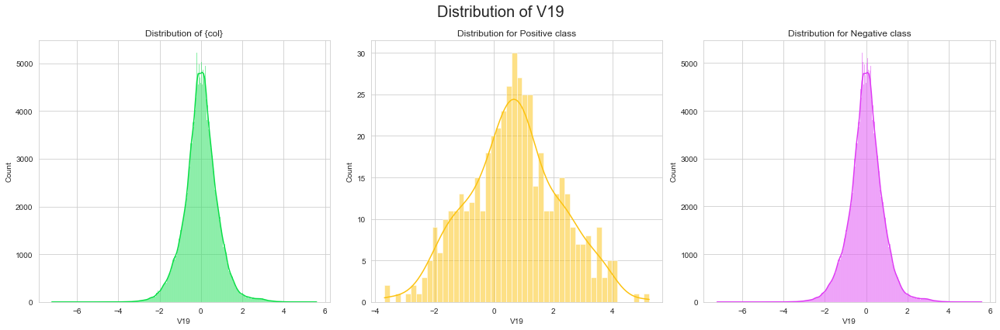

In [68]:
histogram('V19')

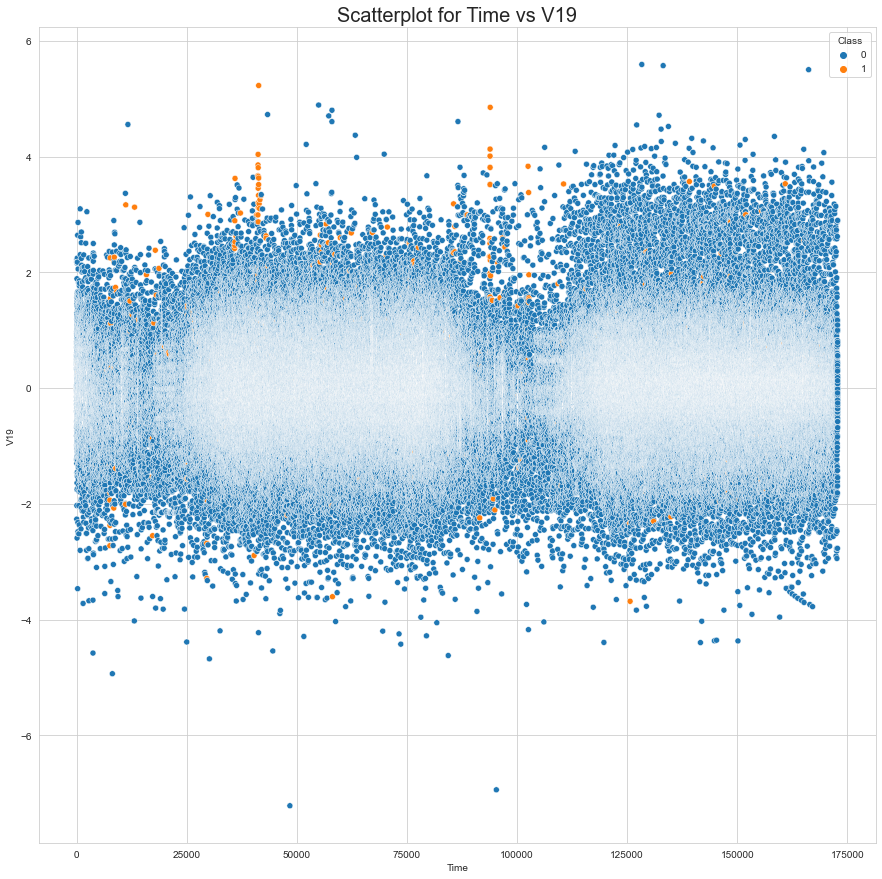

In [69]:
scatter('V19')

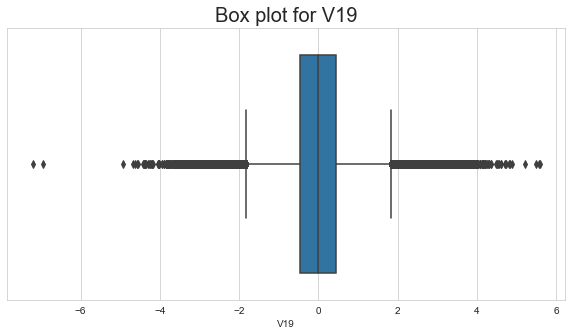

In [70]:
box('V19')

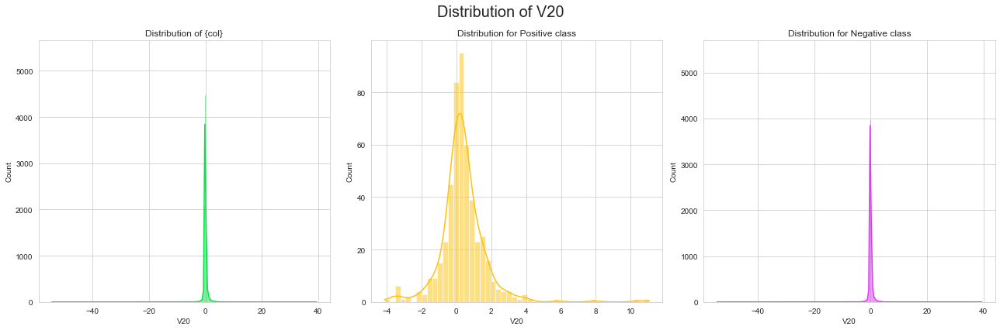

In [71]:
histogram('V20')

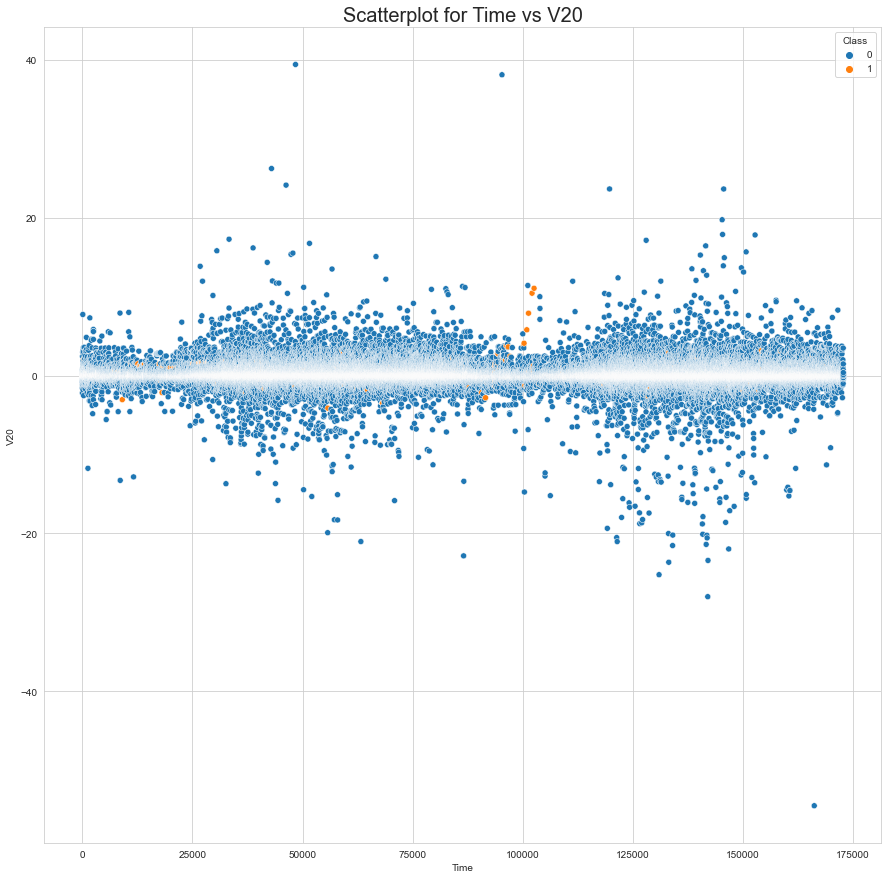

In [72]:
scatter('V20')

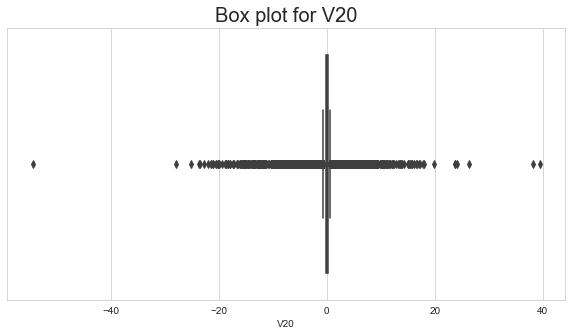

In [73]:
box('V20')

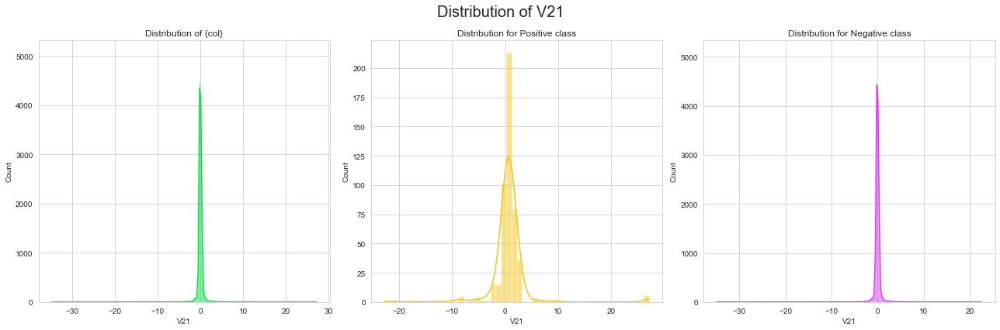

In [74]:
histogram('V21')

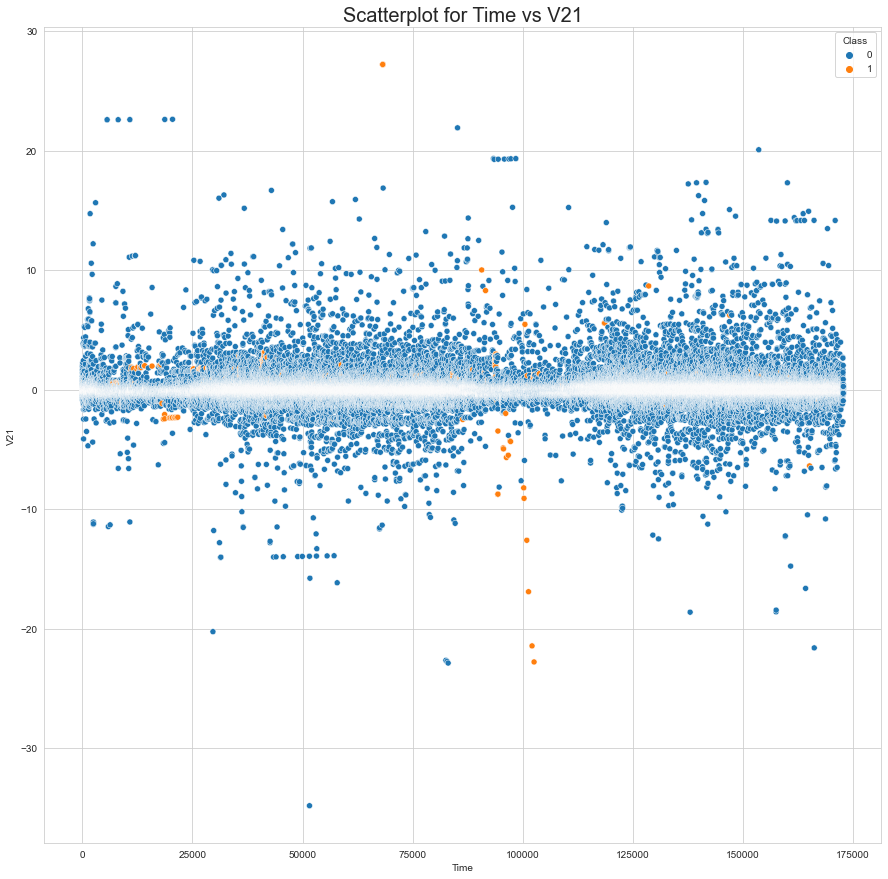

In [75]:
scatter('V21')

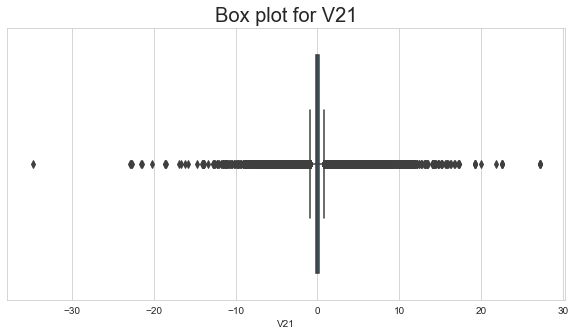

In [76]:
box('V21')

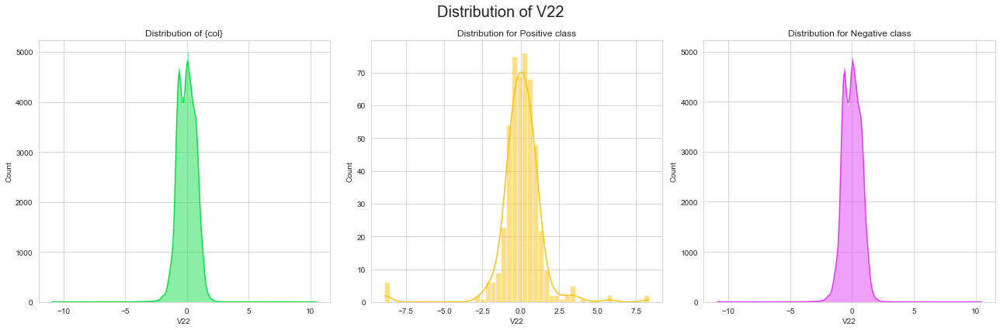

In [77]:
histogram('V22')

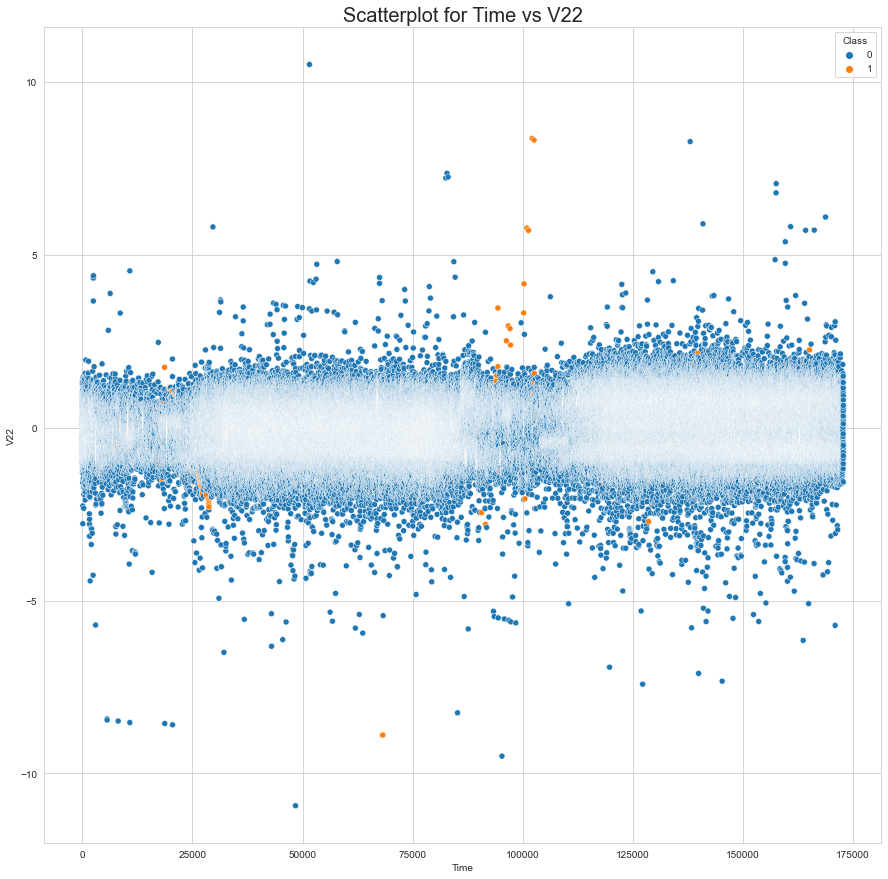

In [78]:
scatter('V22')

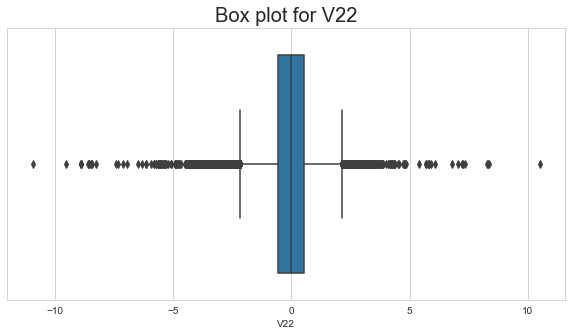

In [79]:
box('V22')

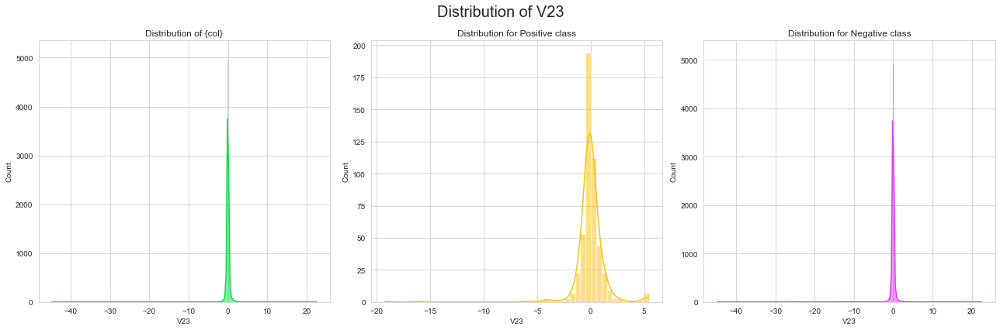

In [80]:
histogram('V23')

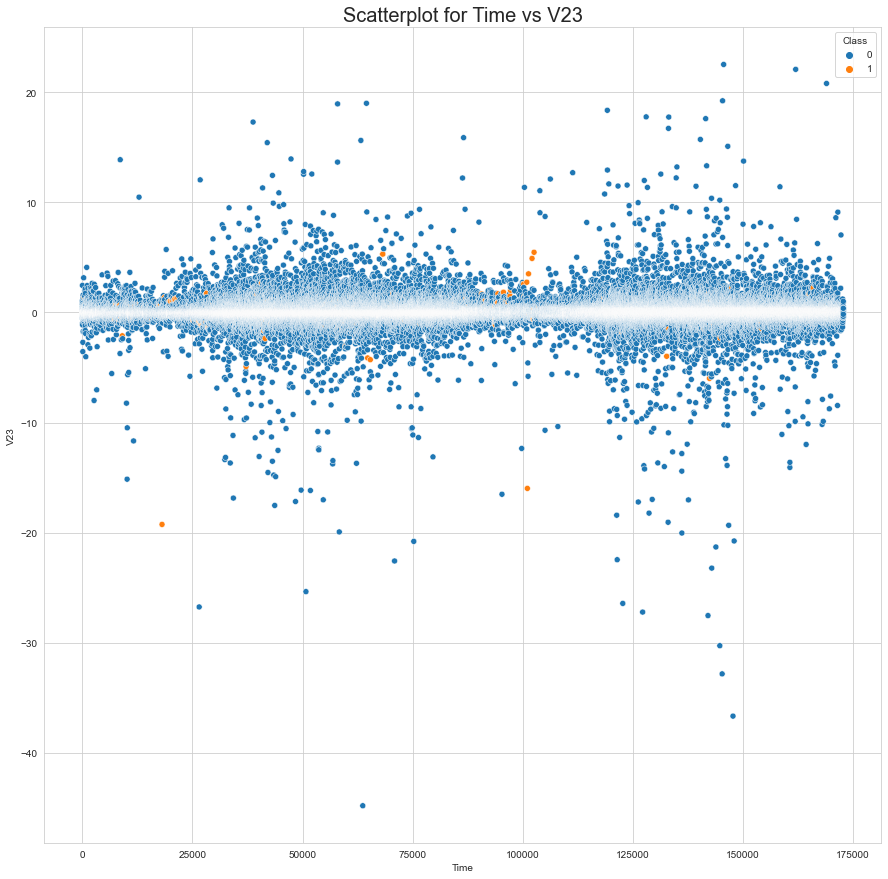

In [81]:
scatter('V23')

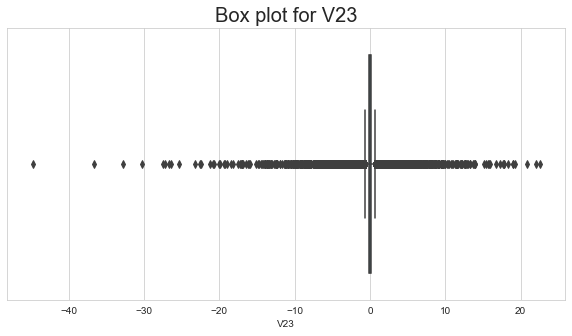

In [82]:
box('V23')

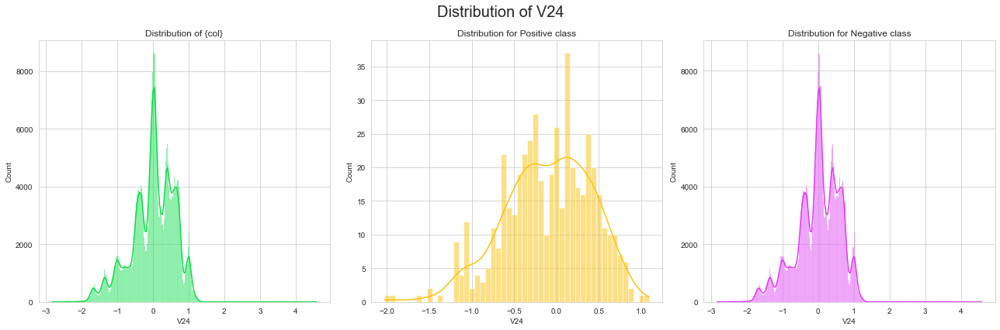

In [83]:
histogram('V24')

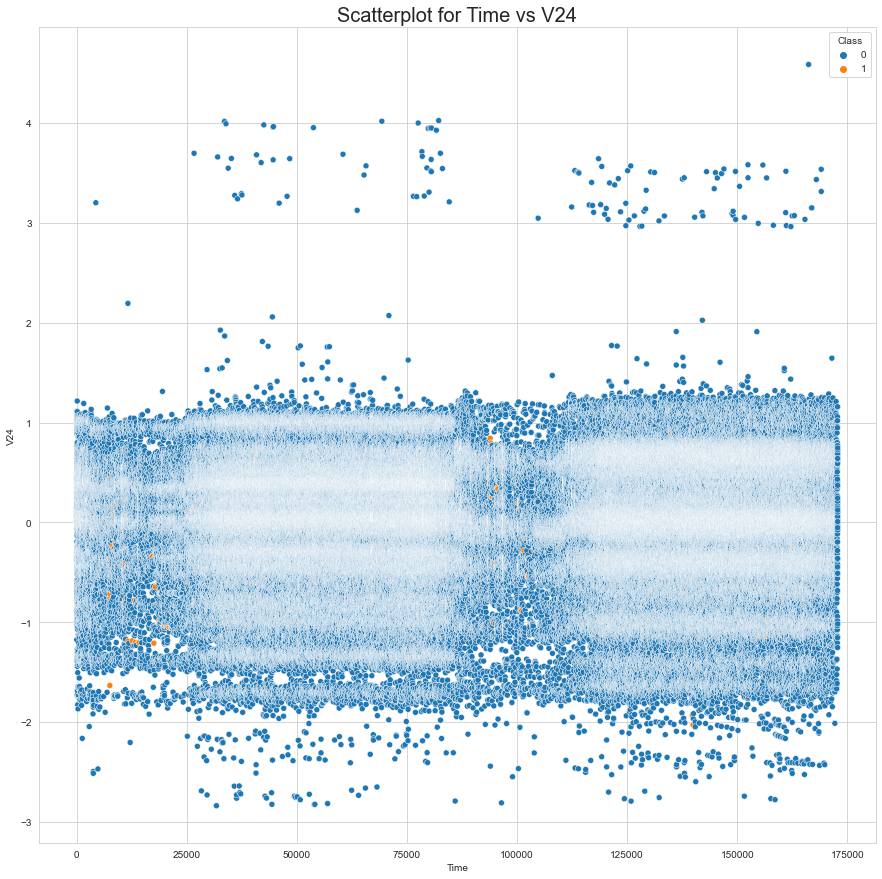

In [84]:
scatter('V24')

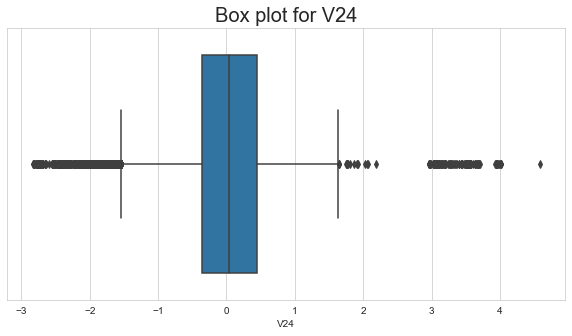

In [85]:
box('V24')

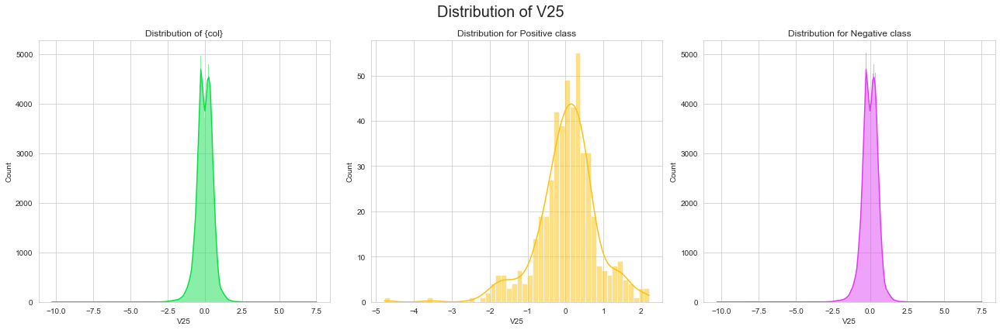

In [86]:
histogram('V25')

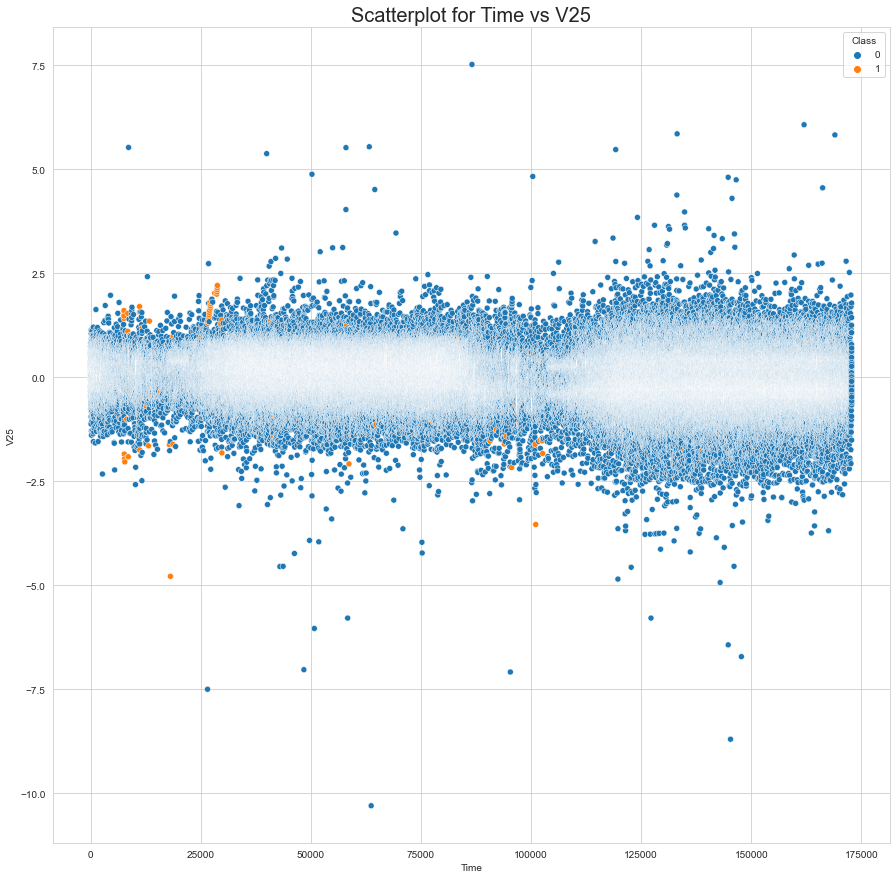

In [87]:
scatter('V25')

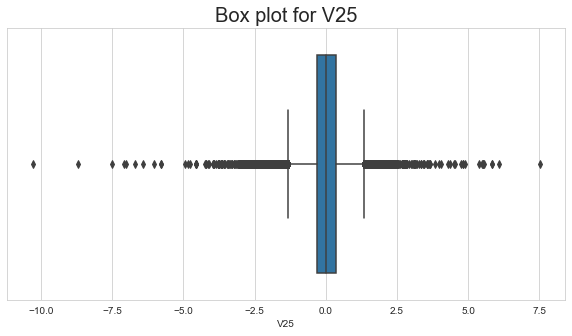

In [88]:
box('V25')

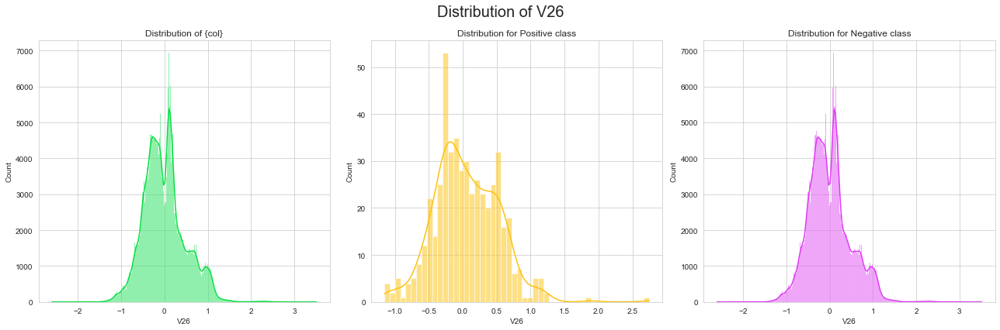

In [89]:
histogram('V26')

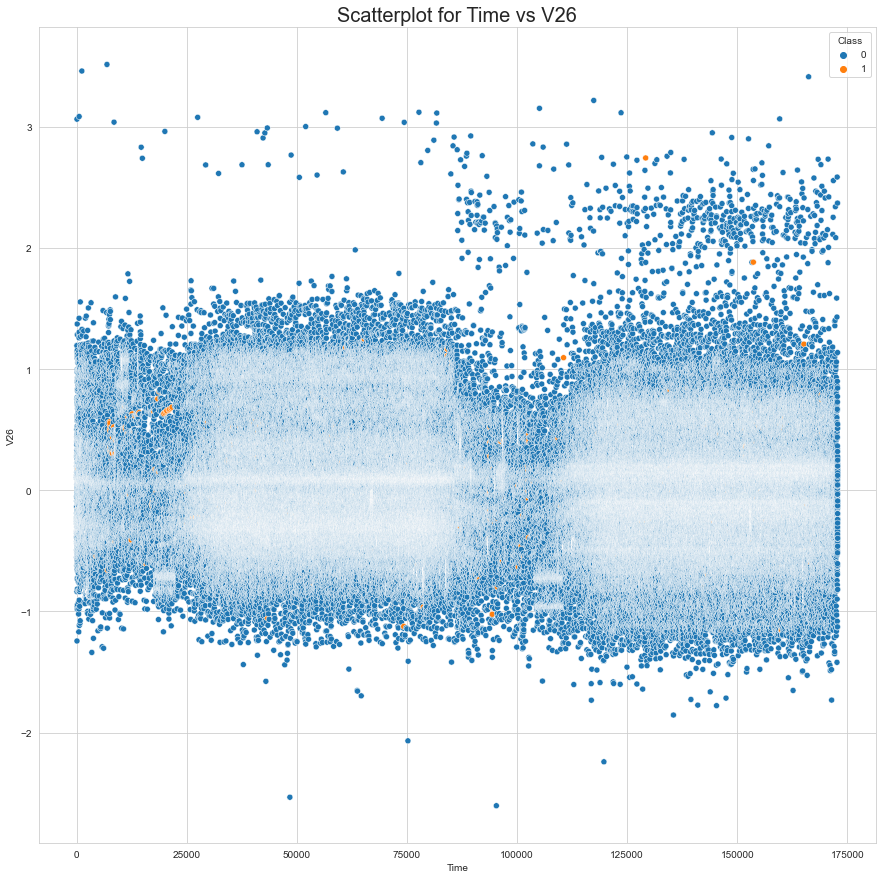

In [90]:
scatter('V26')

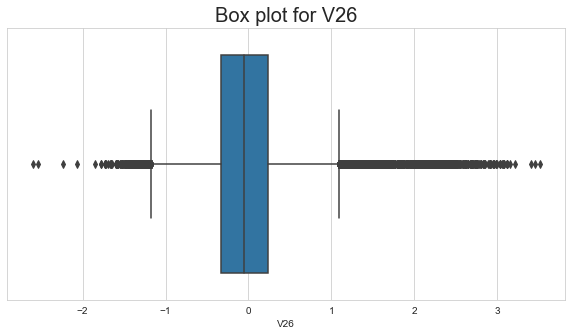

In [91]:
box('V26')

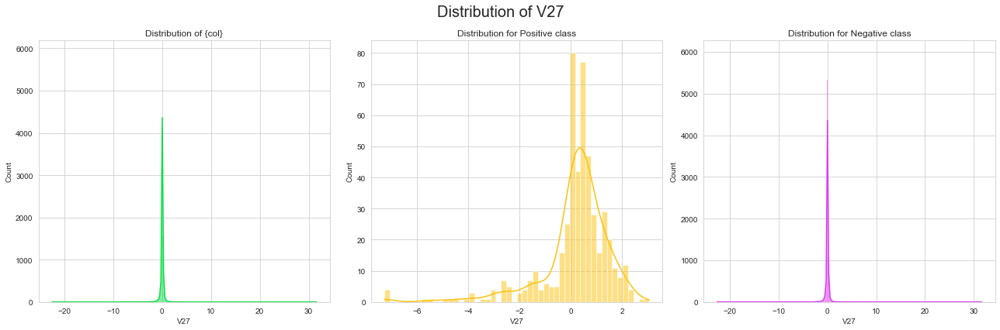

In [92]:
histogram('V27')

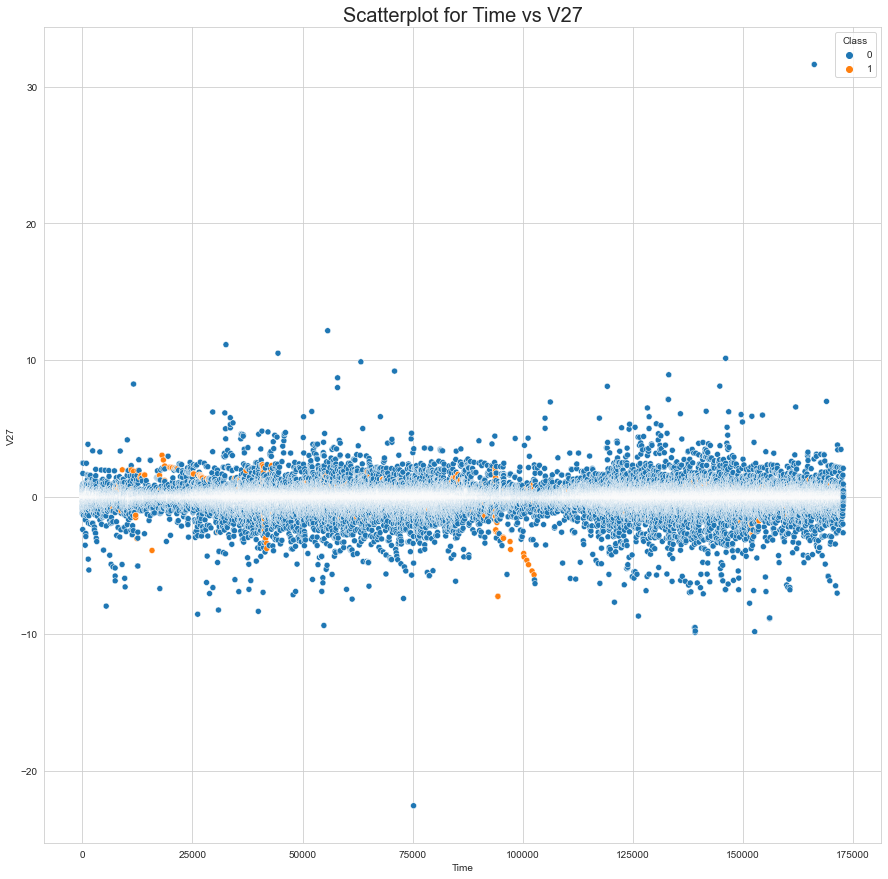

In [93]:
scatter('V27')

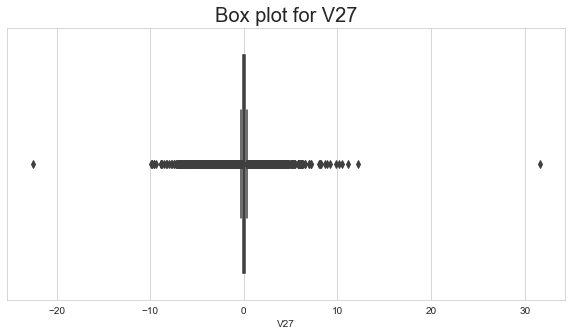

In [94]:
box('V27')

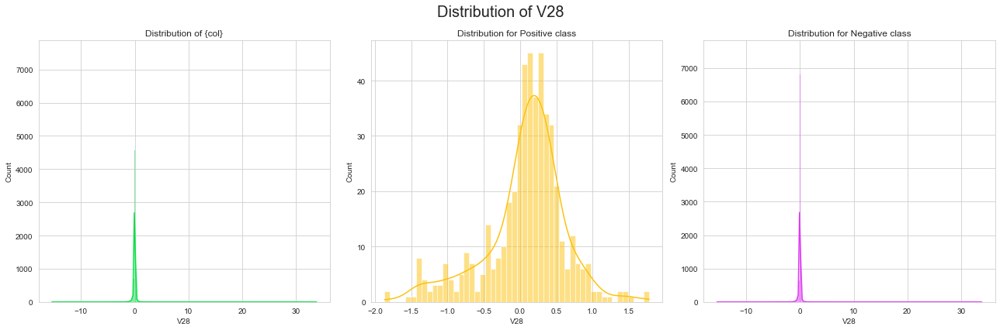

In [95]:
histogram('V28')

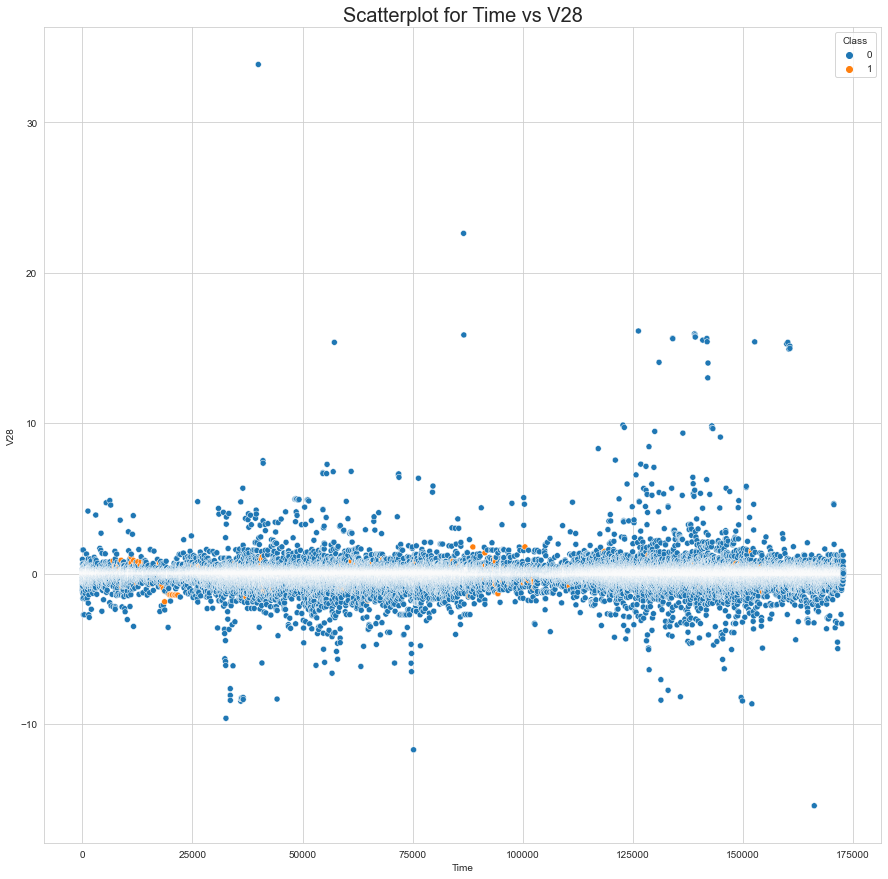

In [96]:
scatter('V28')

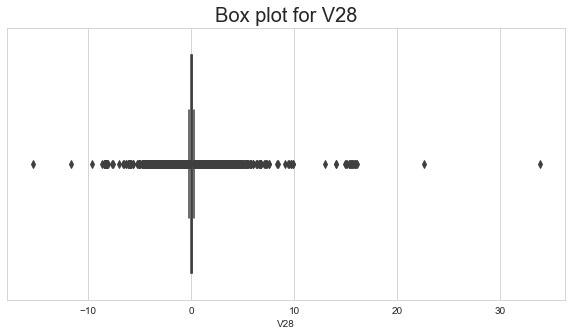

In [97]:
box('V28')

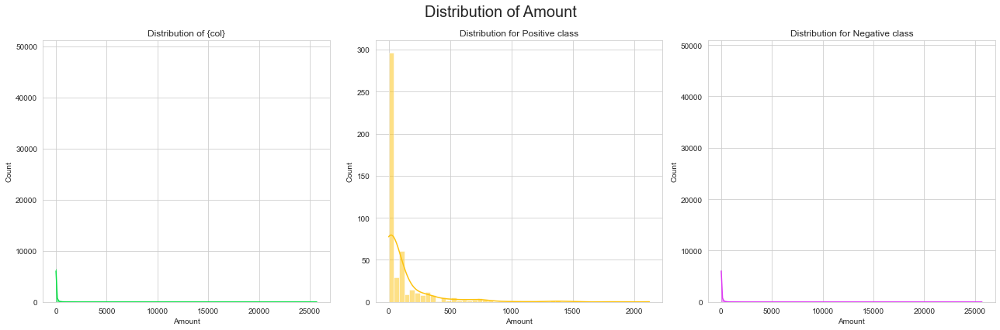

In [98]:
histogram('Amount')

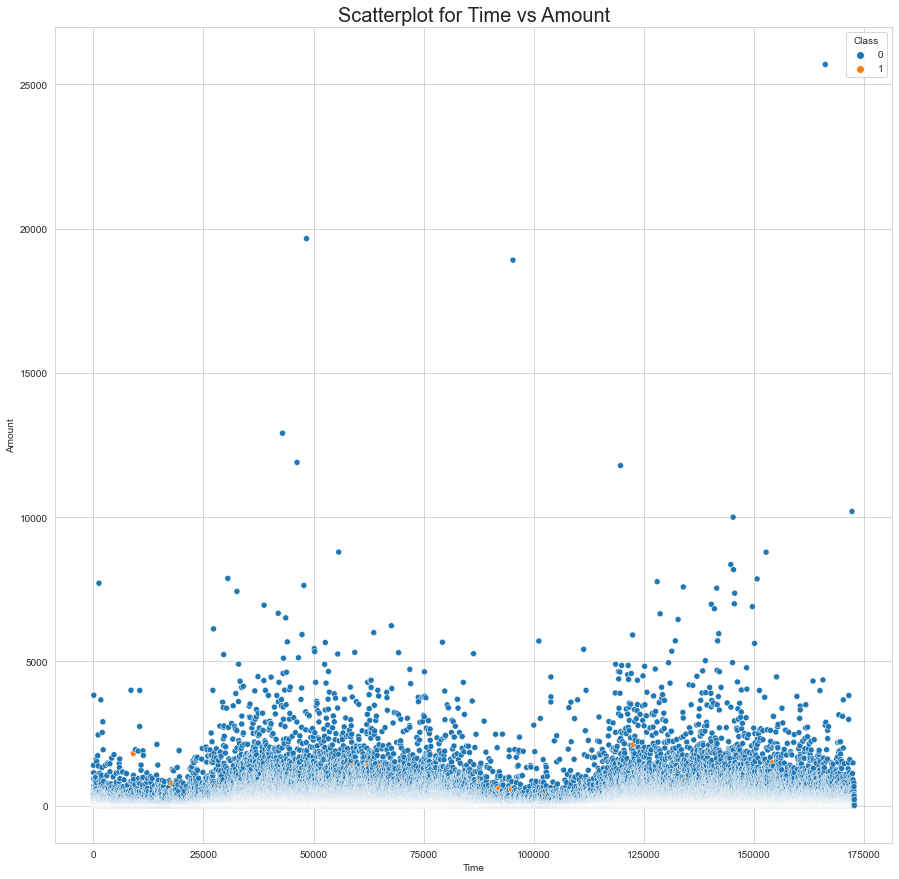

In [99]:
scatter('Amount')

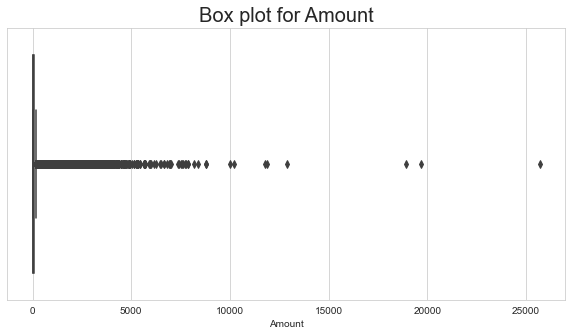

In [100]:
box('Amount')

1. After the exploratory data analysis of the CreditCard data set we find that almost all feature have no normal distribution. There is hardly any interpretation of features themselves as they are PCA transformed and bear no real world meaning.
2. Moreover there are huge number of outliers in the dataset. however if we drop the outliers, we will lose a very big portion of the dataset so we shall proceed without dropping any data.
3. Scatterplots show that most of the distribution is either spread out in some features or highly concentrated to a region in some variables. However there is no interpretation of any realation as there are hardly any visible patterns in the scatterplot. We have also use Class as the hue and hence the imbalance of the dataset is clearly visible where blue dots represent class <0> and orange dots represent class <1>.

<AxesSubplot:>

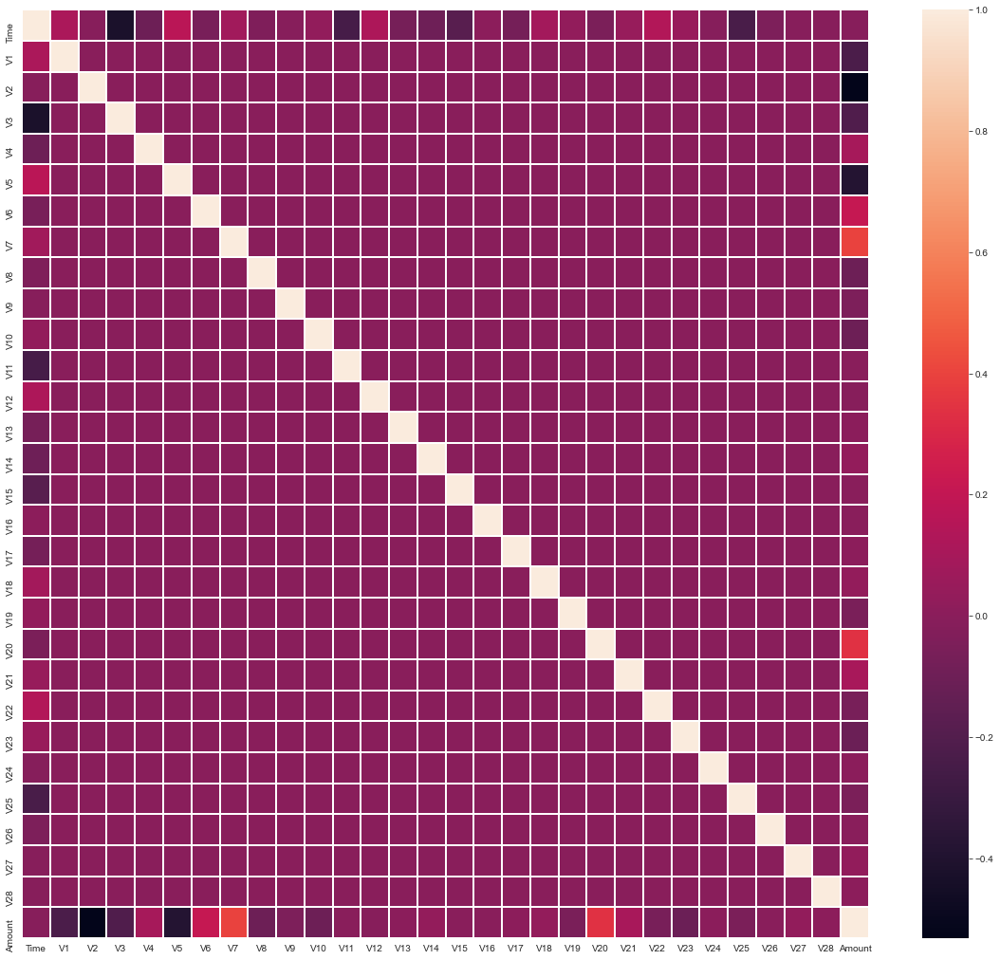

In [101]:
cols = [x for x in creditcard.columns if x not in ['Class']]
fig= plt.figure(figsize = (20,18))
sns.heatmap(creditcard[cols].corr(), linecolor= 'white', linewidths=1)

Variables have little or no correlation with each other, so there are minimal interdependencies. This is because the data is already transformed using Principal Component analysis. So, the features are now selected number of Principal components that are orthogonal to each other hence resemble no correlation amongst themselves.

# 3. Data processing for model building

In [3]:
from sklearn.preprocessing import RobustScaler
scaler = RobustScaler()
cols = ['Time', 'Amount']
creditcard[cols] = scaler.fit_transform(creditcard[cols])
creditcard.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,-0.994983,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,1.783274,0
1,-0.994983,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,-0.269825,0
2,-0.994972,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,4.983721,0
3,-0.994972,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,1.418291,0
4,-0.994960,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,0.670579,0


In [4]:
# splitting The data into testing and training sets
from sklearn.model_selection import train_test_split
df_train, df_test = train_test_split(creditcard, train_size = 0.7, test_size = 0.3, random_state = 0)
input_attrib = [x for x in creditcard.columns if x not in ['Class']]
ytrain = df_train.Class
xtrain = df_train[input_attrib]
ytest = df_test.Class
xtest = df_test[input_attrib]
dtrain = df_train.copy()
dtest = df_test.copy()

The data is featured reduced using with PCA with all the features being principle components of original variables. Since there are zero and negative values in data, we can't carry out BOX- COX transformation on it. So we will proceed with powertransforms using yeo johnson method

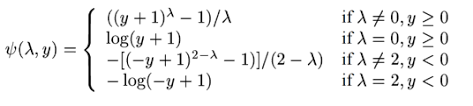

In [6]:
# transforming data using Yeo johnson power transform
from scipy import stats
cols = input_attrib # list of numerical columns to be normalized
for i in cols:
    dtrain[i], fit_lambda = stats.yeojohnson(dtrain[i])
    dtest[i] = stats.yeojohnson(dtest[i], fit_lambda) # transform test data with same lambda that is fitted on training data
ytrainyj = dtrain.Class
xtrainyj = dtrain[input_attrib]
ytestyj = dtest.Class
xtestyj = dtest[input_attrib]


In [7]:
import matplotlib.gridspec as gridspec
def distribution2(data, x = None, y = None):
    try:
        val = [data.Class.value_counts()[1], data.Class.value_counts()[0]]
    except:
        val = [data.Class.value_counts()[1], 0]
    labels = ['Positive', 'Negative']
    colors = sns.color_palette('flare')[0:5]
    gs = gridspec.GridSpec(2, 2)
    plt.figure(figsize = (16,16))
    
    ax1 = plt.subplot(gs[0, 0]) # row 0, col 0
    ax1.pie(val, labels = labels, colors = colors, shadow=True, startangle=90, autopct='%.4f%%')
    ax1.set_title('Pie Chart representation of Class labels.')
    
    ax2 = plt.subplot(gs[0, 1]) # row 0, col 1
    ax2.set_title('Frequency distribution bars for Class label')
    ax2 = sns.countplot(data.Class, palette = 'flare')
    i=0
    for p in ax2.patches:
        height = p.get_height()
        ax2.text(p.get_x()+p.get_width()/2., height + 0.1,
            data.Class.value_counts()[i],ha="center")
        i += 1
    ax2.set_yscale('log')
    
    
    ax3 = plt.subplot(gs[1, :]) # row 1, span all columns
    ax3 = sns.scatterplot(data.Time, data.V18, hue = data.Class)
    ax3.set_title("Scatterplot, Time vs V18")
    plt.tight_layout()

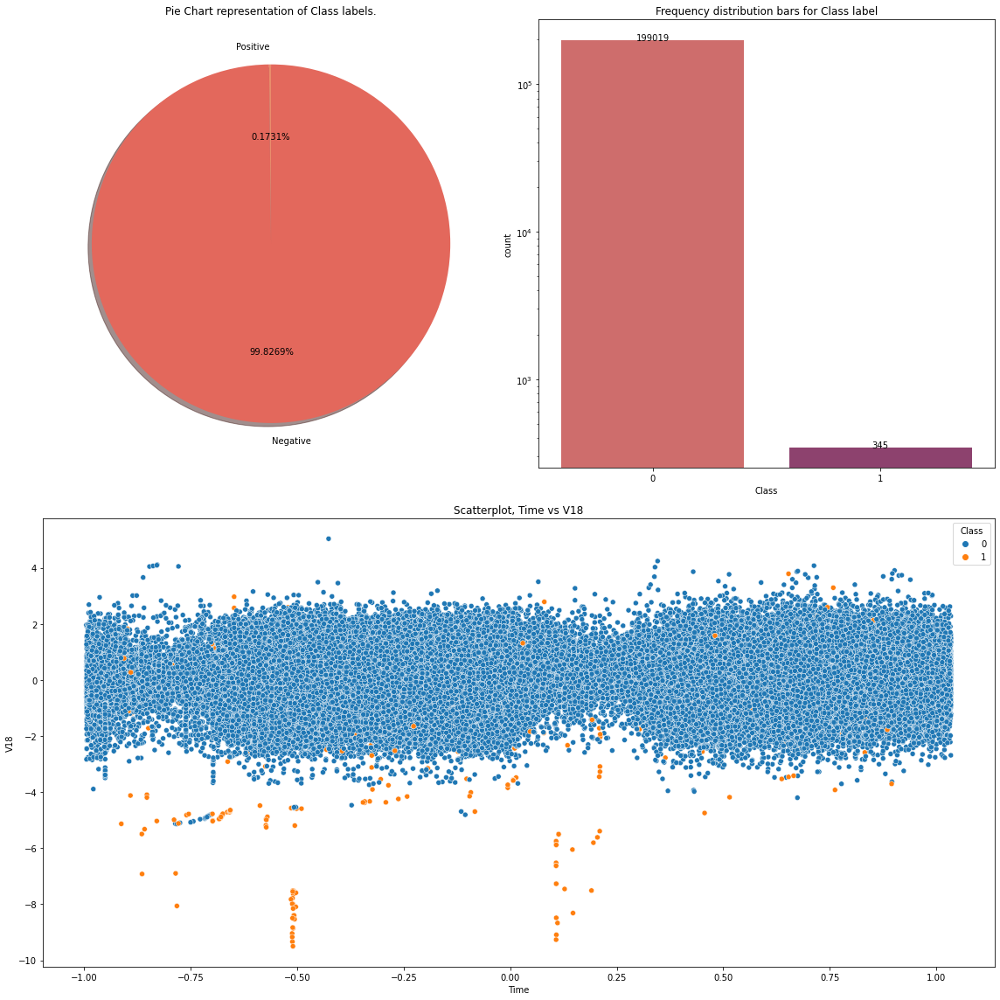

In [27]:
distribution2(df_train)

The extent if imbalance in the distribution is clearly visible in the above plots as class <1> has merely 0.1731% of the total instance in the dataset.

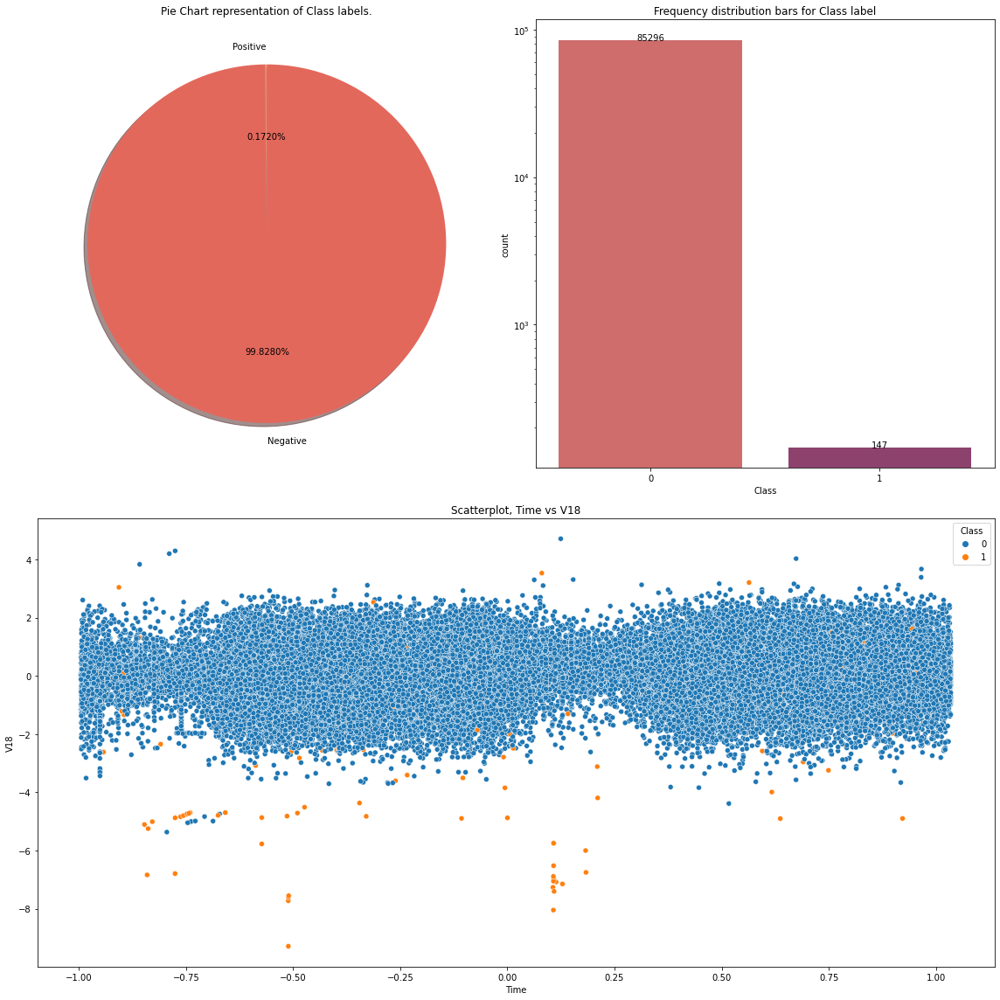

In [28]:
distribution2(df_test)

The test set has distribution which is almost similar to the training set with approximately same percentage of instances of the minority class.

The distribution is highly imbalanced in both test and training sets.



In [12]:
# model analysis functions
#Function for model evaluation
# Model analysis modules
import sklearn
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_curve, precision_recall_curve
from sklearn.metrics import roc_auc_score
from sklearn.metrics import log_loss
from sklearn.metrics import precision_score, recall_score, f1_score, fbeta_score # we will set beta to 2 to give more weight to recall
# Function For analysing model
def analyse(model, x_data, y_data, data_title):
    pred = model.predict(x_data)
    cm = confusion_matrix(y_data, pred)
    TP = cm[1,1]
    TN = cm[0,0]
    FP = cm[0,1]
    FN = cm[1,0]
    print(f'For {data_title} data')
    Accuracy  = (accuracy_score(y_data, pred)).round(4)
    Precision  = (TP/(TP+FP)).round(4)  
    Sensitivity = (TP/(TP+FN)).round(4)
    Specificity = (TN/(TN+FP)).round(4)
    F1 = f1_score(y_data, pred).round(4)
    fbeta = fbeta_score(y_data, pred, beta = 2).round(4)
   
    
    
    mat = pd.DataFrame(cm, index=[ 'Actual Negative','Actual Positive'], 
                                 columns=[ 'Predict Negative','Predict Positive'])
    
    print('Correct Predictions:' ,TP+TN)
    print('False Positives Type I error:', FP)
    print('False Negatives Type II error:', FN)
    print('Accuracy:',Accuracy)
    print('Precision:',Precision)
    print('Sensitivity:',Sensitivity)
    print('Specificity:',Specificity)
    print('F1:', F1)
    print('F_beta Recall Favoured', fbeta)
    try:
        logloss = log_loss(y_data, pred).round(4)
        print('Log_loss', logloss)
    except: pass
    
    mat = pd.DataFrame(cm, index=[ 'Actual Negative','Actual Positive'], 
                                 columns=[ 'Predict Negative','Predict Positive'])
    try:
        y_pred = model.predict_proba(x_data)[:,1]
        fpr, tpr, thresholds = roc_curve(y_data, y_pred)
    except: pass
    try:
        print('ROC AUC score' ,roc_auc_score(y_data, y_pred).round(4))
    except: pass
    
    precision, recall, thresholds = precision_recall_curve( y_data, pred)
    
    fig, axs = plt.subplots(1,3, figsize = (15,5))
    fig.suptitle(f'Model Evaluation {data_title} data' , fontsize=30)
    axs[0].set_title('Confusion Matrix')
    sns.heatmap(mat, annot = True, fmt = 'd', ax = axs[0], linewidths=5)
    axs[1].set_title('Roc Auc Curve')
    sns.lineplot([0,1], [0,1], ax = axs[1], palette = 'rocket_r')
    sns.lineplot(fpr, tpr, ax = axs[1], palette = 'rocket_r' )
    axs[1].set_xlabel('False Positive Rate')
    axs[1].set_ylabel('True Positive Rate')
    axs[2].set_title('Precision Recall Curve')
    sns.lineplot(recall, precision, ax = axs[2], palette = 'rocket_r' )
    axs[2].set_xlabel('Recall')
    axs[2].set_ylabel('Precision')
    plt.tight_layout()

In [13]:
# Function to carryout hyperparameter optimization using Gridsearch CV
# Function For hyper parameter tuning of the model
from sklearn.model_selection import GridSearchCV, StratifiedKFold  #Performing grid search

import pandas as pd
def bestvalues(model, x, y, parameters ,cvrounds = 5, scoring = 'recall'):
    sf = StratifiedKFold(n_splits=cvrounds, shuffle=True, random_state=0)
    grid_search = GridSearchCV(estimator = model,  
                           param_grid = parameters,
                           scoring = scoring,
                           cv = sf,
                           verbose=0, 
                            refit = True)
    
    grid_search.fit(x,y)
    # best score achieved during the GridSearchCV
    results = grid_search.cv_results_
    res_df = pd.DataFrame(results)
    print('GridSearch CV best score : {:.4f}\n\n'.format(grid_search.best_score_))

# print parameters that give the best results
    print('Parameters that give the best results :','\n\n', (grid_search.best_params_))

# print estimator that was chosen by the GridSearch
    print('\n\nEstimator that was chosen by the search :','\n\n', (grid_search.best_estimator_))
    return grid_search.best_estimator_, res_df

# Creating base case using various models
Selected models: 
   1. Logistic Regressor
   2. Random Forest Classifier
   3. Xtreme Gradient Boosting Classifier
   4. ADA Boost Classifier
   5. Support Vector Machine Classifier # Dropped
   6. K Nearest Neighbour Classifier  # Dropped
   
Training and Testing for original data.

## Logistic Regression

For Training data
Correct Predictions: 199206
False Positives Type I error: 28
False Negatives Type II error: 130
Accuracy: 0.9992
Precision: 0.8848
Sensitivity: 0.6232
Specificity: 0.9999
F1: 0.7313
F_beta Recall Favoured 0.6624
Log_loss 0.0274
ROC AUC score 0.9789


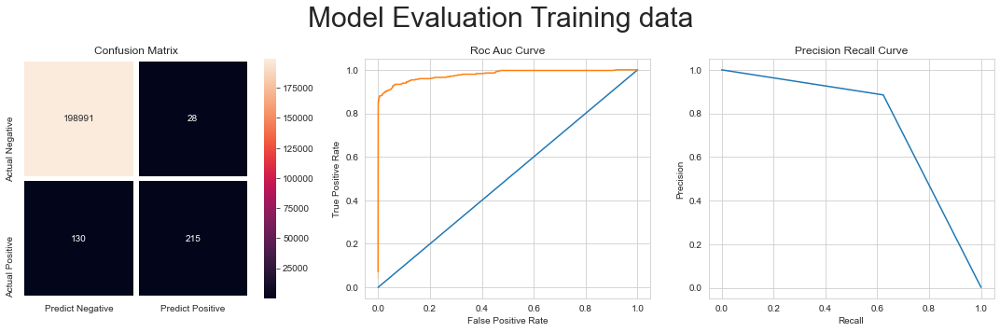

In [27]:
from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression()
logreg.fit(xtrain, ytrain)
analyse(logreg, xtrain, ytrain, 'Training')

For Testing data
Correct Predictions: 85375
False Positives Type I error: 12
False Negatives Type II error: 56
Accuracy: 0.9992
Precision: 0.8835
Sensitivity: 0.619
Specificity: 0.9999
F1: 0.728
F_beta Recall Favoured 0.6585
Log_loss 0.0275
ROC AUC score 0.9694


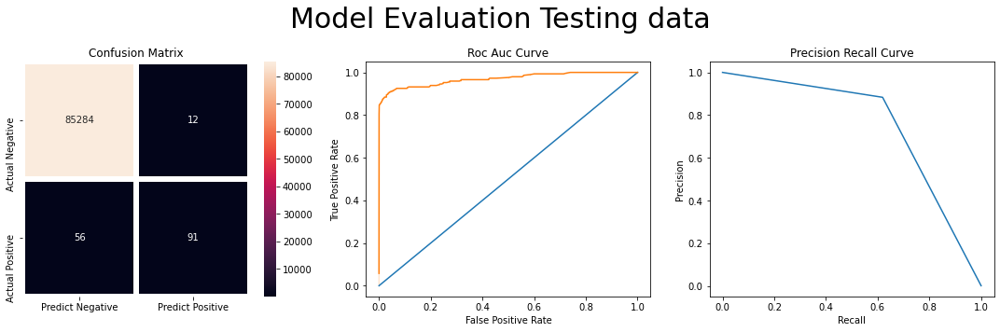

In [10]:
analyse(logreg, xtest, ytest, 'Testing')

In [28]:
# hyperparameter tuning of the model
params = {'C': [0.01, 0.1, 1, 10, 100]}
logreg, cv_results_logreg = bestvalues(logreg, xtrain, ytrain, params ,cvrounds = 5, scoring = 'recall')
cv_results_logreg

GridSearch CV best score : 0.6203


Parameters that give the best results : 

 {'C': 10}


Estimator that was chosen by the search : 

 LogisticRegression(C=10)


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,0.984482,0.142412,0.011610,0.001920,0.01,{'C': 0.01},0.507246,0.608696,0.594203,0.623188,0.579710,0.582609,0.040372,5
1,1.584863,0.130696,0.011732,0.001913,0.1,{'C': 0.1},0.536232,0.608696,0.623188,0.623188,0.637681,0.605797,0.035970,4
2,1.656899,0.036425,0.013236,0.002923,1,{'C': 1},0.594203,0.594203,0.637681,0.623188,0.637681,0.617391,0.019659,3
3,1.739532,0.069407,0.010494,0.000912,10,{'C': 10},0.594203,0.594203,0.637681,0.637681,0.637681,0.620290,0.021300,1
4,1.857459,0.144453,0.013685,0.004460,100,{'C': 100},0.594203,0.594203,0.637681,0.637681,0.637681,0.620290,0.021300,1


For Testing data
Correct Predictions: 85375
False Positives Type I error: 12
False Negatives Type II error: 56
Accuracy: 0.9992
Precision: 0.8835
Sensitivity: 0.619
Specificity: 0.9999
F1: 0.728
F_beta Recall Favoured 0.6585
Log_loss 0.0275
ROC AUC score 0.969


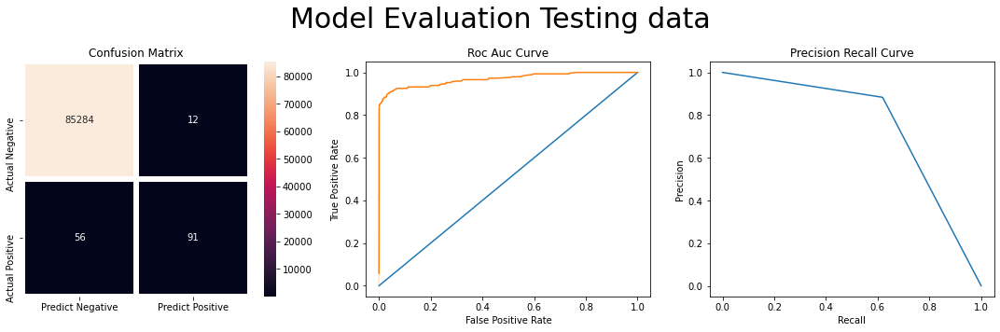

In [12]:
analyse(logreg, xtest, ytest, 'Testing')

For Training data
Correct Predictions: 199206
False Positives Type I error: 28
False Negatives Type II error: 130
Accuracy: 0.9992
Precision: 0.8848
Sensitivity: 0.6232
Specificity: 0.9999
F1: 0.7313
F_beta Recall Favoured 0.6624
Log_loss 0.0274
ROC AUC score 0.9793


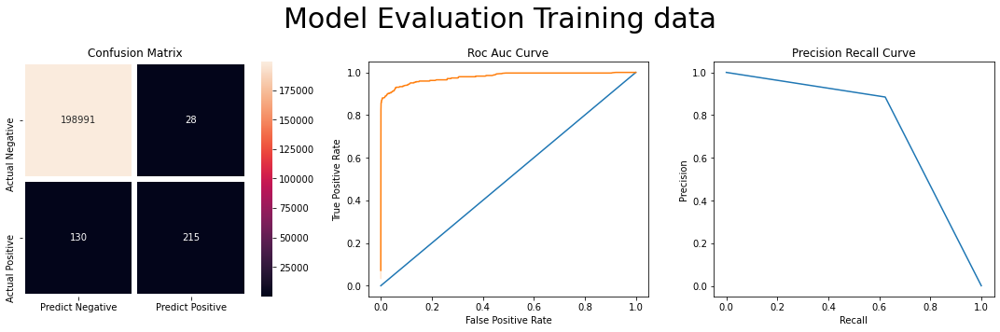

In [14]:
logregL1 = LogisticRegression(penalty='l1', solver='liblinear')
logregL1.fit(xtrain, ytrain)
analyse(logregL1, xtrain, ytrain, 'Training')

For Testing data
Correct Predictions: 85375
False Positives Type I error: 12
False Negatives Type II error: 56
Accuracy: 0.9992
Precision: 0.8835
Sensitivity: 0.619
Specificity: 0.9999
F1: 0.728
F_beta Recall Favoured 0.6585
Log_loss 0.0275
ROC AUC score 0.9701


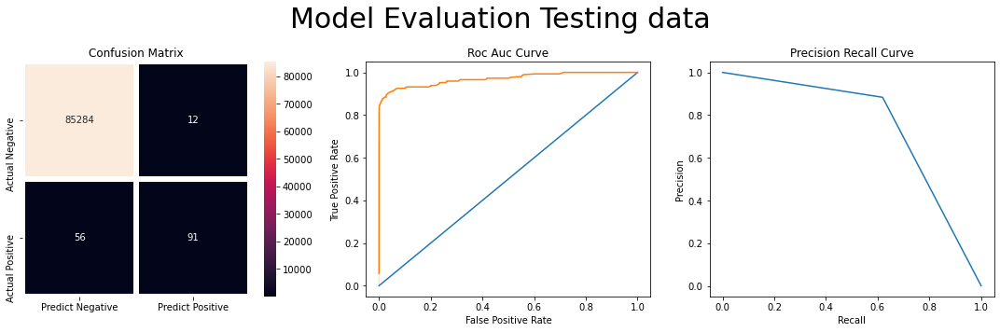

In [15]:
analyse(logregL1, xtest, ytest, 'Testing')

For Training data
Correct Predictions: 199197
False Positives Type I error: 33
False Negatives Type II error: 134
Accuracy: 0.9992
Precision: 0.8648
Sensitivity: 0.6116
Specificity: 0.9998
F1: 0.7165
F_beta Recall Favoured 0.6496
Log_loss 0.0289
ROC AUC score 0.9519


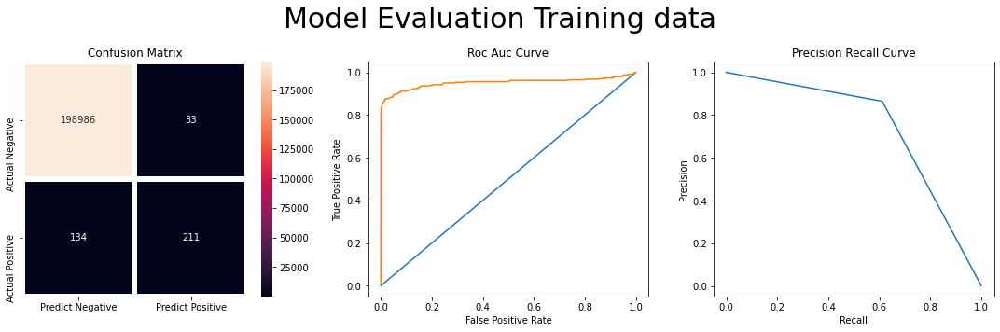

In [17]:
logreg_en = LogisticRegression(penalty='elasticnet', solver='saga', l1_ratio= 0.5)
logreg_en.fit(xtrain, ytrain)
analyse(logreg_en, xtrain, ytrain, 'Training')

For Testing data
Correct Predictions: 85370
False Positives Type I error: 13
False Negatives Type II error: 60
Accuracy: 0.9991
Precision: 0.87
Sensitivity: 0.5918
Specificity: 0.9998
F1: 0.7045
F_beta Recall Favoured 0.6323
Log_loss 0.0295
ROC AUC score 0.9319


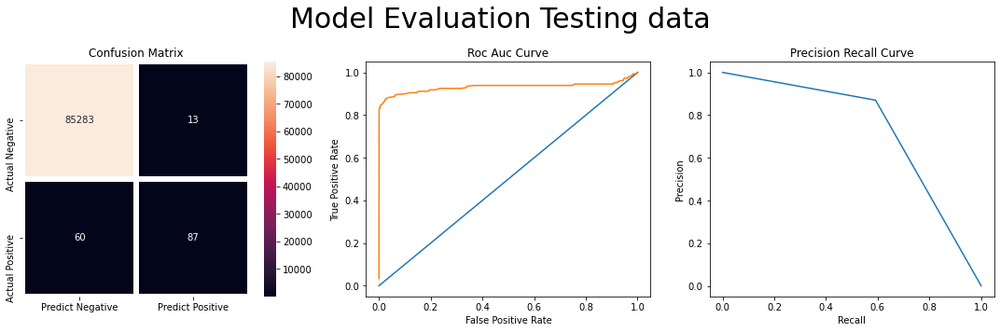

In [18]:
analyse(logreg_en, xtest, ytest, 'Testing')

Trying Logistic regression with elasticnet optimized.

In [22]:
# hyperparameter tuning of the model
params = {'l1_ratio': [i/10 for i in range(10)]}
logreg_en, cv_results_logreg_en = bestvalues(logreg_en, xtrain, ytrain, params ,cvrounds = 5, scoring = 'recall')
cv_results_logreg_en

GridSearch CV best score : 0.5942


Parameters that give the best results : 

 {'l1_ratio': 0.0}


Estimator that was chosen by the search : 

 LogisticRegression(l1_ratio=0.0, penalty='elasticnet', solver='saga')


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_l1_ratio,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,19.636268,0.277454,0.030779,0.001026,0.0,{'l1_ratio': 0.0},0.57971,0.623188,0.695652,0.57971,0.492754,0.594203,0.066097,1
1,26.071735,0.139003,0.030986,0.000791,0.1,{'l1_ratio': 0.1},0.57971,0.623188,0.695652,0.57971,0.492754,0.594203,0.066097,1
2,26.097782,0.185273,0.030735,0.001122,0.2,{'l1_ratio': 0.2},0.57971,0.623188,0.695652,0.57971,0.492754,0.594203,0.066097,1
3,26.026651,0.085252,0.032403,0.004983,0.3,{'l1_ratio': 0.3},0.57971,0.623188,0.695652,0.57971,0.492754,0.594203,0.066097,1
4,26.002776,0.148476,0.027627,0.003784,0.4,{'l1_ratio': 0.4},0.57971,0.623188,0.695652,0.57971,0.492754,0.594203,0.066097,1
5,25.905397,0.309056,0.030829,0.000736,0.5,{'l1_ratio': 0.5},0.57971,0.623188,0.695652,0.57971,0.492754,0.594203,0.066097,1
6,25.932011,0.337490,0.027080,0.003830,0.6,{'l1_ratio': 0.6},0.57971,0.623188,0.695652,0.57971,0.492754,0.594203,0.066097,1
7,25.986643,0.242084,0.030469,0.000563,0.7,{'l1_ratio': 0.7},0.57971,0.623188,0.695652,0.57971,0.492754,0.594203,0.066097,1
8,25.838744,0.167502,0.030544,0.000104,0.8,{'l1_ratio': 0.8},0.57971,0.623188,0.695652,0.57971,0.492754,0.594203,0.066097,1
9,25.806225,0.143343,0.033602,0.007514,0.9,{'l1_ratio': 0.9},0.57971,0.623188,0.695652,0.57971,0.492754,0.594203,0.066097,1


For Testing data
Correct Predictions: 85370
False Positives Type I error: 13
False Negatives Type II error: 60
Accuracy: 0.9991
Precision: 0.87
Sensitivity: 0.5918
Specificity: 0.9998
F1: 0.7045
F_beta Recall Favoured 0.6323
Log_loss 0.0295
ROC AUC score 0.9319


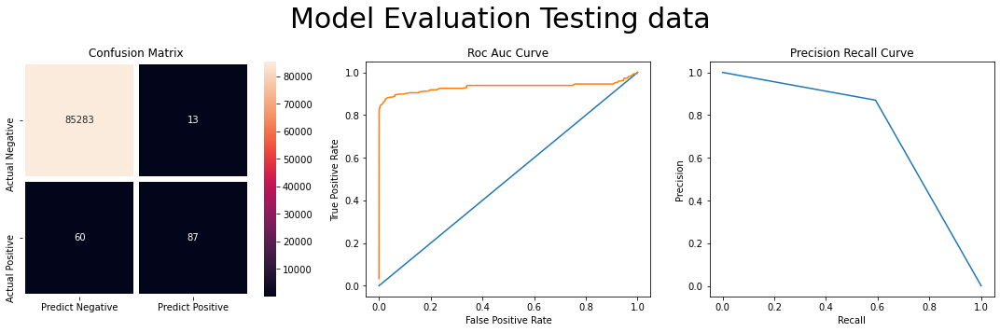

In [23]:
analyse(logreg_en, xtest, ytest, 'Testing')

Among all above variations of Logistic Regression Classifier, we finf that Logistic regression with linear solver C = 10 and penalty l1 has best performance so we will use this model for further analysis.

## Random Forest Classifier

For Training data
Correct Predictions: 199278
False Positives Type I error: 9
False Negatives Type II error: 77
Accuracy: 0.9996
Precision: 0.9675
Sensitivity: 0.7768
Specificity: 1.0
F1: 0.8617
F_beta Recall Favoured 0.8087
Log_loss 0.0149
ROC AUC score 0.978


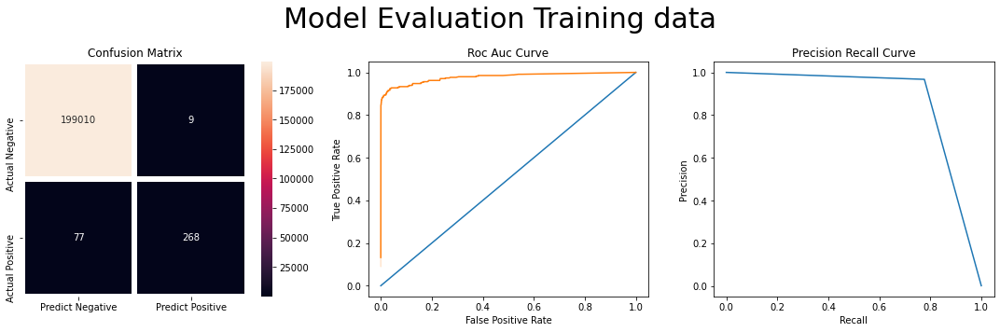

In [29]:
from sklearn.ensemble import RandomForestClassifier
rforest_gini = RandomForestClassifier(max_depth = 5)
 
rforest_gini.fit(xtrain, ytrain)
analyse(rforest_gini, xtrain, ytrain, 'Training')

For Testing data
Correct Predictions: 85392
False Positives Type I error: 7
False Negatives Type II error: 44
Accuracy: 0.9994
Precision: 0.9364
Sensitivity: 0.7007
Specificity: 0.9999
F1: 0.8016
F_beta Recall Favoured 0.7378
Log_loss 0.0206
ROC AUC score 0.9598


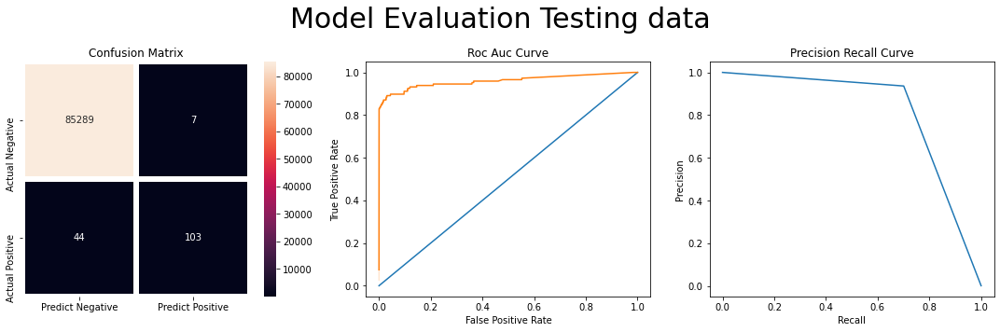

In [30]:
analyse(rforest_gini, xtest, ytest, 'Testing')

For Training data
Correct Predictions: 199282
False Positives Type I error: 10
False Negatives Type II error: 72
Accuracy: 0.9996
Precision: 0.9647
Sensitivity: 0.7913
Specificity: 0.9999
F1: 0.8694
F_beta Recall Favoured 0.8208
Log_loss 0.0142
ROC AUC score 0.9953


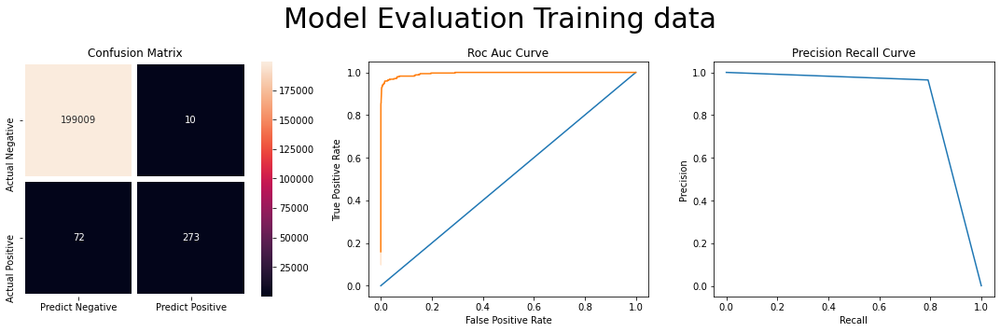

In [8]:
from sklearn.ensemble import RandomForestClassifier
rforest_ent = RandomForestClassifier(max_depth = 5, criterion='entropy')
 
rforest_ent.fit(xtrain, ytrain)
analyse(rforest_ent, xtrain, ytrain, 'Training')

For Testing data
Correct Predictions: 85395
False Positives Type I error: 7
False Negatives Type II error: 41
Accuracy: 0.9994
Precision: 0.9381
Sensitivity: 0.7211
Specificity: 0.9999
F1: 0.8154
F_beta Recall Favoured 0.7561
Log_loss 0.0194
ROC AUC score 0.9795


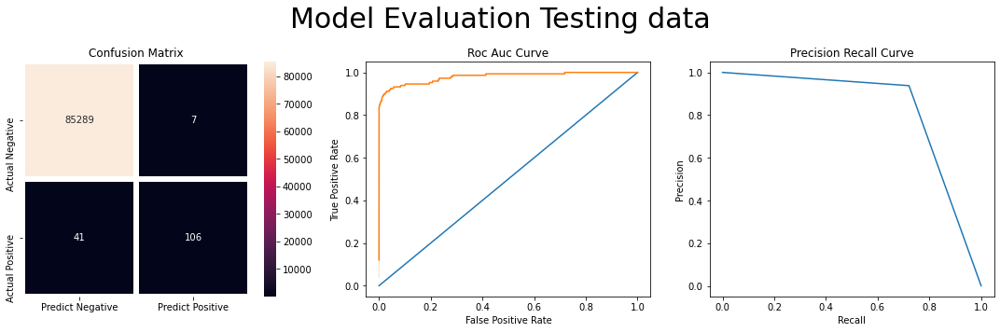

In [9]:
analyse(rforest_ent, xtest, ytest, 'Testing')

In [34]:
params = {'max_features': [i for i in range(5,11)]}
rforest_gini, cv_results_rforest_gini = bestvalues(rforest_gini, xtrain, ytrain, params ,cvrounds = 5, scoring = 'recall')
cv_results_rforest_gini

GridSearch CV best score : 0.7536


Parameters that give the best results : 

 {'max_features': 9}


Estimator that was chosen by the search : 

 RandomForestClassifier(max_depth=5, max_features=9)


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_features,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,53.385505,25.241134,0.218722,0.109472,5,{'max_features': 5},0.666667,0.739130,0.768116,0.768116,0.666667,0.721739,0.046195,6
1,47.283119,7.024974,0.183895,0.022440,6,{'max_features': 6},0.710145,0.739130,0.768116,0.768116,0.710145,0.739130,0.025925,5
2,62.602845,4.464151,0.214549,0.085141,7,{'max_features': 7},0.739130,0.753623,0.768116,0.768116,0.695652,0.744928,0.026880,3
3,65.920549,2.003699,0.199924,0.067245,8,{'max_features': 8},0.724638,0.753623,0.768116,0.753623,0.710145,0.742029,0.021300,4
4,66.506428,2.316570,0.204359,0.090469,9,{'max_features': 9},0.753623,0.739130,0.768116,0.782609,0.724638,0.753623,0.020496,1
5,74.502635,3.510259,0.215736,0.084629,10,{'max_features': 10},0.753623,0.753623,0.768116,0.782609,0.710145,0.753623,0.024251,1


In [35]:
params = {'max_depth': [i for i in range(5,11)]}
rforest_gini, cv_results_rforest_gini = bestvalues(rforest_gini, xtrain, ytrain, params ,cvrounds = 5, scoring = 'recall')
cv_results_rforest_gini

GridSearch CV best score : 0.7855


Parameters that give the best results : 

 {'max_depth': 10}


Estimator that was chosen by the search : 

 RandomForestClassifier(max_depth=10, max_features=9)


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_depth,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,68.362267,3.303766,0.158641,0.004723,5,{'max_depth': 5},0.753623,0.739130,0.782609,0.782609,0.724638,0.756522,0.023188,6
1,80.298646,2.529157,0.226237,0.113030,6,{'max_depth': 6},0.753623,0.739130,0.797101,0.782609,0.753623,0.765217,0.021300,5
2,89.544603,1.777626,0.183532,0.009711,7,{'max_depth': 7},0.739130,0.753623,0.797101,0.797101,0.753623,0.768116,0.024251,4
3,104.883627,3.223902,0.245333,0.100841,8,{'max_depth': 8},0.768116,0.768116,0.797101,0.797101,0.739130,0.773913,0.021691,3
4,112.221982,2.889429,0.204029,0.003491,9,{'max_depth': 9},0.739130,0.782609,0.811594,0.811594,0.768116,0.782609,0.027498,2
5,124.342542,4.647321,0.220467,0.007901,10,{'max_depth': 10},0.753623,0.782609,0.811594,0.826087,0.753623,0.785507,0.029560,1


For Testing data
Correct Predictions: 85404
False Positives Type I error: 6
False Negatives Type II error: 33
Accuracy: 0.9995
Precision: 0.95
Sensitivity: 0.7755
Specificity: 0.9999
F1: 0.8539
F_beta Recall Favoured 0.8051
Log_loss 0.0158
ROC AUC score 0.9743


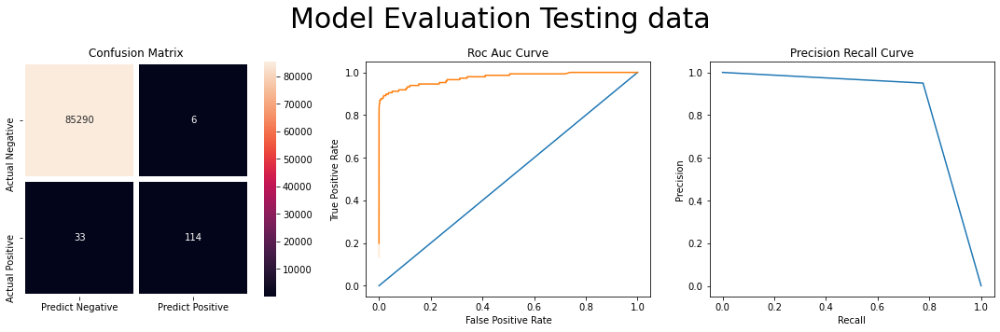

In [36]:
analyse(rforest_gini, xtest, ytest, 'Testing')

In [10]:
params = {'max_features': [i for i in range(7,11)]}
rforest_ent, cv_results_rforest_ent = bestvalues(rforest_ent, xtrain, ytrain, params ,cvrounds = 3, scoring = 'recall')
cv_results_rforest_ent

GridSearch CV best score : 0.7623


Parameters that give the best results : 

 {'max_features': 8}


Estimator that was chosen by the search : 

 RandomForestClassifier(criterion='entropy', max_depth=5, max_features=8)


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_features,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,137.871574,1.000101,0.831492,0.005738,7,{'max_features': 7},0.747826,0.773913,0.756522,0.759420,0.010845,2
1,155.787484,0.341635,0.836387,0.007630,8,{'max_features': 8},0.747826,0.773913,0.765217,0.762319,0.010845,1
2,173.588256,1.080369,0.840435,0.004648,9,{'max_features': 9},0.721739,0.773913,0.773913,0.756522,0.024595,3
3,194.184053,1.100584,0.831008,0.009147,10,{'max_features': 10},0.730435,0.765217,0.773913,0.756522,0.018785,3


In [11]:
params = {'max_depth': [i for i in range(7,12)]}
rforest_ent, cv_results_rforest_ent = bestvalues(rforest_ent, xtrain, ytrain, params ,cvrounds = 3, scoring = 'recall')
cv_results_rforest_ent

GridSearch CV best score : 0.7797


Parameters that give the best results : 

 {'max_depth': 11}


Estimator that was chosen by the search : 

 RandomForestClassifier(criterion='entropy', max_depth=11, max_features=8)


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_depth,params,split0_test_score,split1_test_score,split2_test_score,mean_test_score,std_test_score,rank_test_score
0,84.642543,1.463825,0.364873,0.004778,7,{'max_depth': 7},0.747826,0.800000,0.773913,0.773913,0.021300,3
1,90.704468,2.635407,0.372038,0.008216,8,{'max_depth': 8},0.730435,0.791304,0.791304,0.771014,0.028694,5
2,93.472202,2.776154,0.383564,0.003592,9,{'max_depth': 9},0.730435,0.800000,0.791304,0.773913,0.030948,3
3,99.419255,1.563182,0.518890,0.159150,10,{'max_depth': 10},0.773913,0.765217,0.791304,0.776812,0.010845,2
4,96.568960,2.254741,0.386476,0.006129,11,{'max_depth': 11},0.765217,0.782609,0.791304,0.779710,0.010845,1


For Training data
Correct Predictions: 199320
False Positives Type I error: 0
False Negatives Type II error: 44
Accuracy: 0.9998
Precision: 1.0
Sensitivity: 0.8725
Specificity: 1.0
F1: 0.9319
F_beta Recall Favoured 0.8953
Log_loss 0.0076
ROC AUC score 1.0


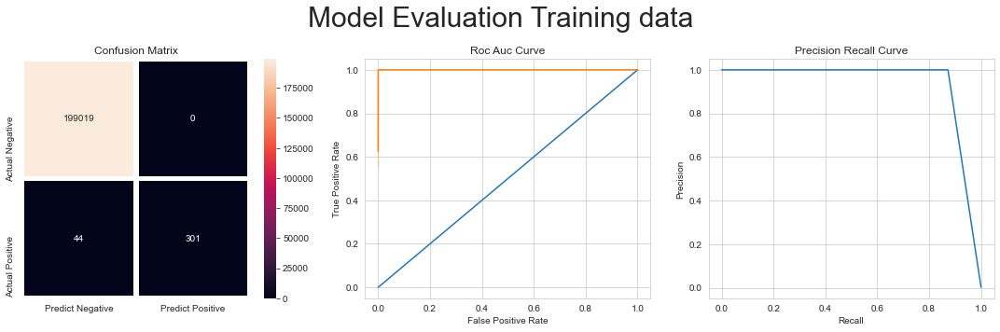

In [41]:
from sklearn.ensemble import RandomForestClassifier
rforest_ent = RandomForestClassifier(criterion='entropy', max_depth=11, max_features=8)
 
rforest_ent.fit(xtrain, ytrain)
analyse(rforest_ent, xtrain, ytrain, 'Training')

For Testing data
Correct Predictions: 85405
False Positives Type I error: 7
False Negatives Type II error: 31
Accuracy: 0.9996
Precision: 0.9431
Sensitivity: 0.7891
Specificity: 0.9999
F1: 0.8593
F_beta Recall Favoured 0.8158
Log_loss 0.0154
ROC AUC score 0.9787


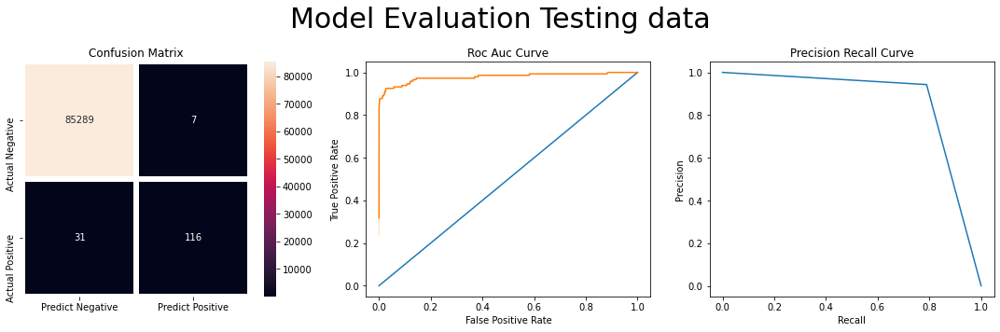

In [11]:
analyse(rforest_ent, xtest, ytest, 'Testing')

Among the above analysed variants of Random Forest classifer, RandomForestClassifier(criterion='entropy', max_depth=11, max_features=8) performs the best.

## XGBoost

In [20]:
import xgboost as xgb
from xgboost.sklearn import XGBClassifier
params = {
            'booster':'gbtree',
            'objective':'binary:logistic',
            'max_depth': 3,
            'alpha': 10,
            'learning_rate': 10,
            'n_estimators':500,
            "eval_metric"      : ['logloss']
        }         
           
          
# instantiate the classifier 
xgb_clf_gbtree = XGBClassifier(**params)
xgb_clf_gbtree.fit(xtrain, ytrain)

XGBClassifier(alpha=10, base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, eval_metric=['logloss'],
              gamma=0, gpu_id=-1, importance_type='gain',
              interaction_constraints='', learning_rate=10, max_delta_step=0,
              max_depth=3, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=500, n_jobs=8,
              num_parallel_tree=1, random_state=0, reg_alpha=10, reg_lambda=1,
              scale_pos_weight=1, subsample=1, tree_method='exact',
              validate_parameters=1, verbosity=None)

For Training data
Correct Predictions: 199160
False Positives Type I error: 90
False Negatives Type II error: 114
Accuracy: 0.999
Precision: 0.7196
Sensitivity: 0.6696
Specificity: 0.9995
F1: 0.6937
F_beta Recall Favoured 0.679
Log_loss 0.0353
ROC AUC score 0.8737


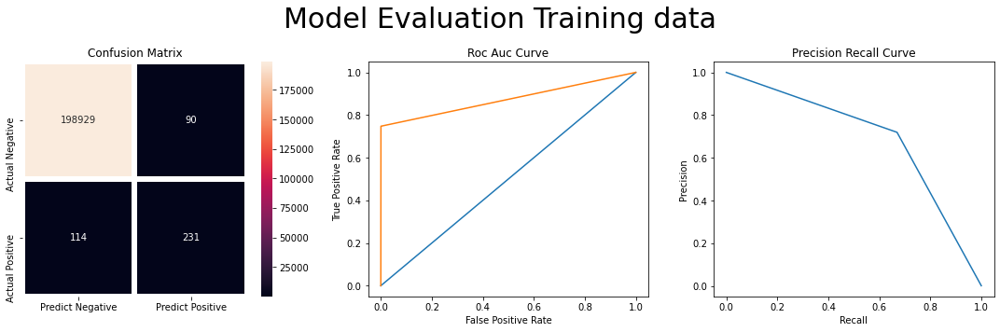

In [21]:
analyse(xgb_clf_gbtree, xtrain, ytrain, 'Training')

For Testing data
Correct Predictions: 85358
False Positives Type I error: 35
False Negatives Type II error: 50
Accuracy: 0.999
Precision: 0.7348
Sensitivity: 0.6599
Specificity: 0.9996
F1: 0.6953
F_beta Recall Favoured 0.6736
Log_loss 0.0344
ROC AUC score 0.8637


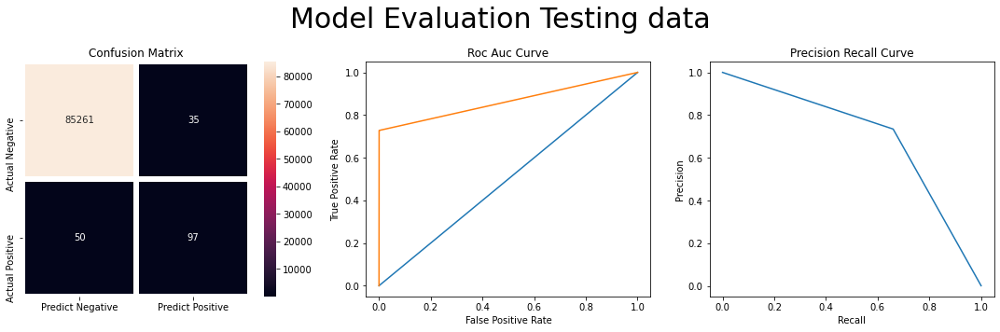

In [22]:
analyse(xgb_clf_gbtree, xtest, ytest, 'Testing')

In [15]:
params = {
            'booster':'gblinear',
            'objective':'binary:logistic',
            'max_depth': 5,
            'alpha': 10,
            'learning_rate': 1,
            'n_estimators':500,
            "eval_metric"      : ['logloss']
        }         
           
          
# instantiate the classifier 
xgb_clf_gblinear = XGBClassifier(**params)
xgb_clf_gblinear.fit(xtrain, ytrain)

[18:40:19] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "max_depth" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.




XGBClassifier(alpha=10, base_score=0.5, booster='gblinear',
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, eval_metric=['logloss'], gamma=None,
              gpu_id=-1, importance_type='gain', interaction_constraints=None,
              learning_rate=1, max_delta_step=None, max_depth=5,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=500, n_jobs=8, num_parallel_tree=None,
              random_state=0, reg_alpha=0, reg_lambda=0, scale_pos_weight=1,
              subsample=None, tree_method=None, validate_parameters=1,
              verbosity=None)

For Training data
Correct Predictions: 199019
False Positives Type I error: 0
False Negatives Type II error: 345
Accuracy: 0.9983
Precision: nan
Sensitivity: 0.0
Specificity: 1.0
F1: 0.0
F_beta Recall Favoured 0.0
Log_loss 0.0598
ROC AUC score 0.5


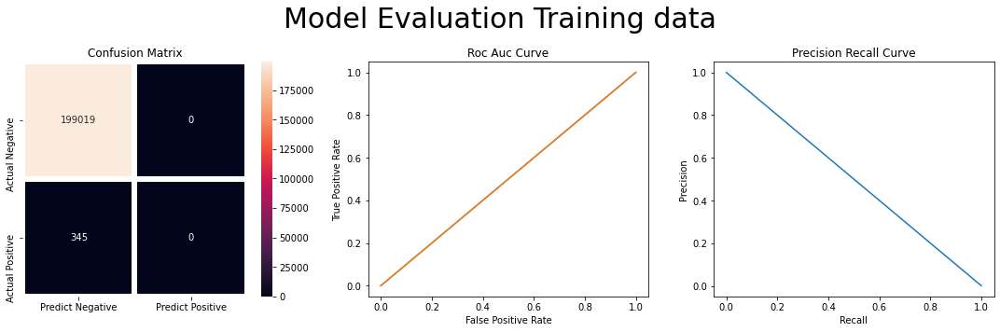

In [16]:
analyse(xgb_clf_gblinear, xtrain, ytrain, 'Training')

For Testing data
Correct Predictions: 85296
False Positives Type I error: 0
False Negatives Type II error: 147
Accuracy: 0.9983
Precision: nan
Sensitivity: 0.0
Specificity: 1.0
F1: 0.0
F_beta Recall Favoured 0.0
Log_loss 0.0594
ROC AUC score 0.5


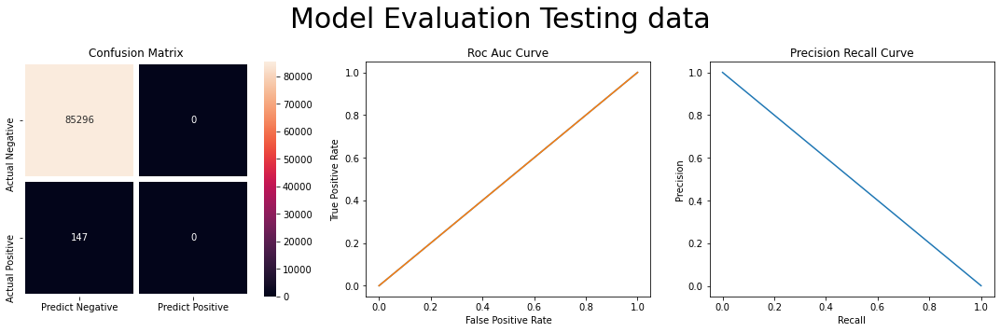

In [17]:
analyse(xgb_clf_gblinear, xtest, ytest, 'Testing')

In [24]:
params = {
            'booster':'gbtree',
            'objective':'binary:logistic',
            'max_depth': 5,
            'alpha': 10,
            'learning_rate': 1000,
            'n_estimators':500,
            "eval_metric"      : ['logloss']
        }         
           
          
# instantiate the classifier 
xgb_clf_gbtree = XGBClassifier(**params)
xgb_clf_gbtree.fit(xtrain, ytrain)

XGBClassifier(alpha=10, base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, eval_metric=['logloss'],
              gamma=0, gpu_id=-1, importance_type='gain',
              interaction_constraints='', learning_rate=1000, max_delta_step=0,
              max_depth=5, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=500, n_jobs=8,
              num_parallel_tree=1, random_state=0, reg_alpha=10, reg_lambda=1,
              scale_pos_weight=1, subsample=1, tree_method='exact',
              validate_parameters=1, verbosity=None)

In [25]:
params = {'max_depth': [i for i in range(5,12)]}
xgb_clf_gbtree, cv_results_xgb_clf = bestvalues(xgb_clf_gbtree, xtrain, ytrain, params ,cvrounds = 4, scoring = 'recall')
cv_results_xgb_clf

GridSearch CV best score : 0.7158


Parameters that give the best results : 

 {'max_depth': 5}


Estimator that was chosen by the search : 

 XGBClassifier(alpha=10, base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, eval_metric=['logloss'],
              gamma=0, gpu_id=-1, importance_type='gain',
              interaction_constraints='', learning_rate=1000, max_delta_step=0,
              max_depth=5, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=500, n_jobs=8,
              num_parallel_tree=1, random_state=0, reg_alpha=10, reg_lambda=1,
              scale_pos_weight=1, subsample=1, tree_method='exact',
              validate_parameters=1, verbosity=None)


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_depth,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,mean_test_score,std_test_score,rank_test_score
0,20.145961,0.423299,0.066690,0.003627,5,{'max_depth': 5},0.569767,0.813953,0.709302,0.770115,0.715785,0.092130,1
1,20.066764,0.568077,0.069937,0.004253,6,{'max_depth': 6},0.569767,0.627907,0.709302,0.666667,0.643411,0.051347,2
2,20.231078,0.361270,0.079019,0.002428,7,{'max_depth': 7},0.569767,0.627907,0.709302,0.666667,0.643411,0.051347,2
3,20.008080,0.108381,0.075010,0.005008,8,{'max_depth': 8},0.569767,0.627907,0.709302,0.666667,0.643411,0.051347,2
4,20.146198,0.117085,0.072025,0.002291,9,{'max_depth': 9},0.569767,0.627907,0.709302,0.666667,0.643411,0.051347,2
5,23.510940,2.285555,0.082974,0.006163,10,{'max_depth': 10},0.569767,0.627907,0.709302,0.666667,0.643411,0.051347,2
6,21.195718,2.079916,0.074581,0.013329,11,{'max_depth': 11},0.569767,0.627907,0.709302,0.666667,0.643411,0.051347,2


In [26]:
params = {'min_child_weight': [i for i in range(1,12,2)]}
xgb_clf_gbtree, cv_results_xgb_clf = bestvalues(xgb_clf_gbtree, xtrain, ytrain, params ,cvrounds = 4, scoring = 'recall')
cv_results_xgb_clf

GridSearch CV best score : 0.7158


Parameters that give the best results : 

 {'min_child_weight': 1}


Estimator that was chosen by the search : 

 XGBClassifier(alpha=10, base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, eval_metric=['logloss'],
              gamma=0, gpu_id=-1, importance_type='gain',
              interaction_constraints='', learning_rate=1000, max_delta_step=0,
              max_depth=5, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=500, n_jobs=8,
              num_parallel_tree=1, random_state=0, reg_alpha=10, reg_lambda=1,
              scale_pos_weight=1, subsample=1, tree_method='exact',
              validate_parameters=1, verbosity=None)


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_min_child_weight,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,mean_test_score,std_test_score,rank_test_score
0,20.086112,0.253271,0.074042,0.002609,1,{'min_child_weight': 1},0.569767,0.813953,0.709302,0.770115,0.715785,0.092130,1
1,19.763430,0.187966,0.070449,0.001371,3,{'min_child_weight': 3},0.000000,0.651163,0.000000,0.597701,0.312216,0.312788,5
2,19.919321,0.457080,0.071630,0.004778,5,{'min_child_weight': 5},0.000000,0.523256,0.290698,0.000000,0.203488,0.219472,6
3,19.825654,1.117014,0.075300,0.005092,7,{'min_child_weight': 7},0.860465,0.000000,0.848837,0.000000,0.427326,0.427345,4
4,19.105294,0.806239,0.067539,0.001826,9,{'min_child_weight': 9},0.000000,0.930233,0.000000,0.942529,0.468190,0.468211,3
5,18.591418,0.566309,0.067001,0.001813,11,{'min_child_weight': 11},0.988372,0.953488,0.802326,0.000000,0.686047,0.402215,2


In [27]:
params = {'n_estimators': [i for i in range(100,1000,200)]}
xgb_clf_gbtree, cv_results_xgb_clf = bestvalues(xgb_clf_gbtree, xtrain, ytrain, params ,cvrounds = 4, scoring = 'recall')
cv_results_xgb_clf

GridSearch CV best score : 0.7158


Parameters that give the best results : 

 {'n_estimators': 100}


Estimator that was chosen by the search : 

 XGBClassifier(alpha=10, base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, eval_metric=['logloss'],
              gamma=0, gpu_id=-1, importance_type='gain',
              interaction_constraints='', learning_rate=1000, max_delta_step=0,
              max_depth=5, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=100, n_jobs=8,
              num_parallel_tree=1, random_state=0, reg_alpha=10, reg_lambda=1,
              scale_pos_weight=1, subsample=1, tree_method='exact',
              validate_parameters=1, verbosity=None)


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_estimators,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,mean_test_score,std_test_score,rank_test_score
0,4.850809,0.104629,0.062596,0.003692,100,{'n_estimators': 100},0.569767,0.813953,0.709302,0.770115,0.715785,0.09213,1
1,12.371869,0.152584,0.059599,0.004145,300,{'n_estimators': 300},0.569767,0.813953,0.709302,0.770115,0.715785,0.09213,1
2,20.393353,0.723210,0.071348,0.008566,500,{'n_estimators': 500},0.569767,0.813953,0.709302,0.770115,0.715785,0.09213,1
3,27.724502,0.467951,0.083409,0.000954,700,{'n_estimators': 700},0.569767,0.813953,0.709302,0.770115,0.715785,0.09213,1
4,35.291595,0.440264,0.092475,0.006470,900,{'n_estimators': 900},0.569767,0.813953,0.709302,0.770115,0.715785,0.09213,1


In [28]:
params = {'gamma': [0.001, 0.01, 0.1, 1, 10, 100, 1000]}
xgb_clf_gbtree, cv_results_xgb_clf = bestvalues(xgb_clf_gbtree, xtrain, ytrain, params ,cvrounds = 4, scoring = 'recall')
cv_results_xgb_clf

GridSearch CV best score : 0.7187


Parameters that give the best results : 

 {'gamma': 0.01}


Estimator that was chosen by the search : 

 XGBClassifier(alpha=10, base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, eval_metric=['logloss'],
              gamma=0.01, gpu_id=-1, importance_type='gain',
              interaction_constraints='', learning_rate=1000, max_delta_step=0,
              max_depth=5, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=100, n_jobs=8,
              num_parallel_tree=1, random_state=0, reg_alpha=10, reg_lambda=1,
              scale_pos_weight=1, subsample=1, tree_method='exact',
              validate_parameters=1, verbosity=None)


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_gamma,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,mean_test_score,std_test_score,rank_test_score
0,4.784734,0.137363,0.058651,0.002744,0.001,{'gamma': 0.001},0.569767,0.813953,0.709302,0.770115,0.715785,0.092130,2
1,5.071693,0.267094,0.062129,0.008200,0.01,{'gamma': 0.01},0.569767,0.813953,0.720930,0.770115,0.718692,0.092063,1
2,4.853971,0.114048,0.058134,0.005568,0.1,{'gamma': 0.1},0.569767,0.813953,0.697674,0.770115,0.712878,0.092472,3
3,5.070093,0.101219,0.054986,0.004830,1,{'gamma': 1},0.511628,0.558140,0.697674,0.000000,0.441860,0.264135,6
4,4.869462,0.321355,0.062015,0.002968,10,{'gamma': 10},0.604651,0.779070,0.348837,0.632184,0.591186,0.154835,5
5,4.491799,0.049873,0.056420,0.006710,100,{'gamma': 100},0.720930,0.709302,0.697674,0.666667,0.698643,0.020210,4
6,4.451853,0.019501,0.059194,0.004496,1000,{'gamma': 1000},0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,7


In [29]:
params = {'gamma': [0.005 , 0.009, 0.01,0.05,0.09]}
xgb_clf_gbtree, cv_results_xgb_clf = bestvalues(xgb_clf_gbtree, xtrain, ytrain, params ,cvrounds = 4, scoring = 'recall')
cv_results_xgb_clf

GridSearch CV best score : 0.7187


Parameters that give the best results : 

 {'gamma': 0.009}


Estimator that was chosen by the search : 

 XGBClassifier(alpha=10, base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, eval_metric=['logloss'],
              gamma=0.009, gpu_id=-1, importance_type='gain',
              interaction_constraints='', learning_rate=1000, max_delta_step=0,
              max_depth=5, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=100, n_jobs=8,
              num_parallel_tree=1, random_state=0, reg_alpha=10, reg_lambda=1,
              scale_pos_weight=1, subsample=1, tree_method='exact',
              validate_parameters=1, verbosity=None)


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_gamma,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,mean_test_score,std_test_score,rank_test_score
0,2.686142,0.440078,0.024580,0.004564,0.005,{'gamma': 0.005},0.569767,0.813953,0.709302,0.770115,0.715785,0.092130,3
1,2.919185,0.165143,0.023075,0.004131,0.009,{'gamma': 0.009},0.569767,0.813953,0.720930,0.770115,0.718692,0.092063,1
2,2.937551,0.146859,0.020561,0.000865,0.01,{'gamma': 0.01},0.569767,0.813953,0.720930,0.770115,0.718692,0.092063,1
3,2.945360,0.168576,0.047181,0.010402,0.05,{'gamma': 0.05},0.569767,0.813953,0.697674,0.770115,0.712878,0.092472,4
4,2.899125,0.116869,0.032673,0.004323,0.09,{'gamma': 0.09},0.569767,0.813953,0.697674,0.770115,0.712878,0.092472,4


In [30]:
params = {'colsample_bytree': [i/10 for i in range(1,10,2)]}
xgb_clf_gbtree, cv_results_xgb_clf = bestvalues(xgb_clf_gbtree, xtrain, ytrain, params ,cvrounds = 4, scoring = 'recall')
cv_results_xgb_clf

GridSearch CV best score : 0.5767


Parameters that give the best results : 

 {'colsample_bytree': 0.5}


Estimator that was chosen by the search : 

 XGBClassifier(alpha=10, base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.5, eval_metric=['logloss'],
              gamma=0.009, gpu_id=-1, importance_type='gain',
              interaction_constraints='', learning_rate=1000, max_delta_step=0,
              max_depth=5, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=100, n_jobs=8,
              num_parallel_tree=1, random_state=0, reg_alpha=10, reg_lambda=1,
              scale_pos_weight=1, subsample=1, tree_method='exact',
              validate_parameters=1, verbosity=None)


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_colsample_bytree,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,mean_test_score,std_test_score,rank_test_score
0,1.667802,0.054219,0.034159,0.004077,0.1,{'colsample_bytree': 0.1},0.000000,0.000000,0.581395,0.252874,0.208567,0.238728,5
1,1.988902,0.088312,0.039128,0.001022,0.3,{'colsample_bytree': 0.3},0.000000,0.895349,0.000000,0.218391,0.278435,0.367165,4
2,2.144711,0.043595,0.030607,0.000876,0.5,{'colsample_bytree': 0.5},0.465116,0.686047,0.523256,0.632184,0.576651,0.087095,1
3,2.579615,0.151899,0.035113,0.004140,0.7,{'colsample_bytree': 0.7},0.581395,0.651163,0.000000,0.494253,0.431703,0.255368,3
4,2.828966,0.134319,0.035128,0.004136,0.9,{'colsample_bytree': 0.9},0.581395,0.406977,0.627907,0.643678,0.564989,0.094058,2


For Training data
Correct Predictions: 199238
False Positives Type I error: 14
False Negatives Type II error: 112
Accuracy: 0.9994
Precision: 0.9433
Sensitivity: 0.6754
Specificity: 0.9999
F1: 0.7872
F_beta Recall Favoured 0.716
Log_loss 0.0218
ROC AUC score 0.9214


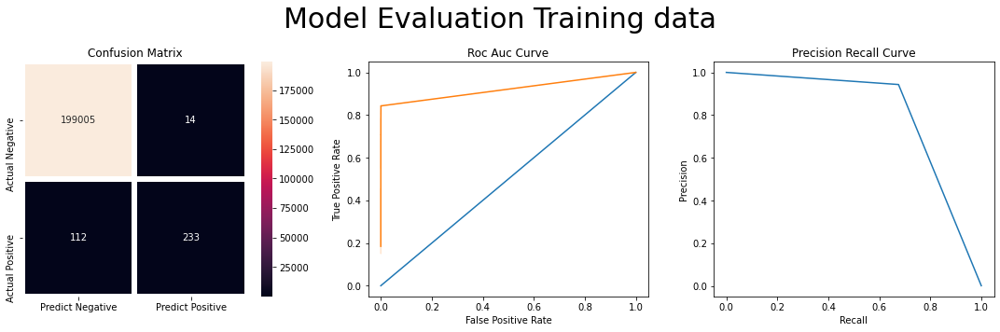

In [36]:
xgb_clf_gbtree = XGBClassifier(alpha=10, base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.5, eval_metric=['logloss'],
              gamma=0.009, gpu_id=-1, importance_type='gain',
              interaction_constraints='', learning_rate=0.001, max_delta_step=0,
              max_depth=5, min_child_weight=1, 
              monotone_constraints='()', n_estimators=100, n_jobs=8,
              num_parallel_tree=1, random_state=0, reg_alpha=10, reg_lambda=1,
              scale_pos_weight=1, subsample=1, tree_method='exact',
              validate_parameters=1, verbosity=None)
xgb_clf_gbtree.fit(xtrain, ytrain)
analyse(xgb_clf_gbtree, xtrain, ytrain, 'Training')

For Testing data
Correct Predictions: 85379
False Positives Type I error: 9
False Negatives Type II error: 55
Accuracy: 0.9993
Precision: 0.9109
Sensitivity: 0.6259
Specificity: 0.9999
F1: 0.7419
F_beta Recall Favoured 0.6676
Log_loss 0.0259
ROC AUC score 0.918


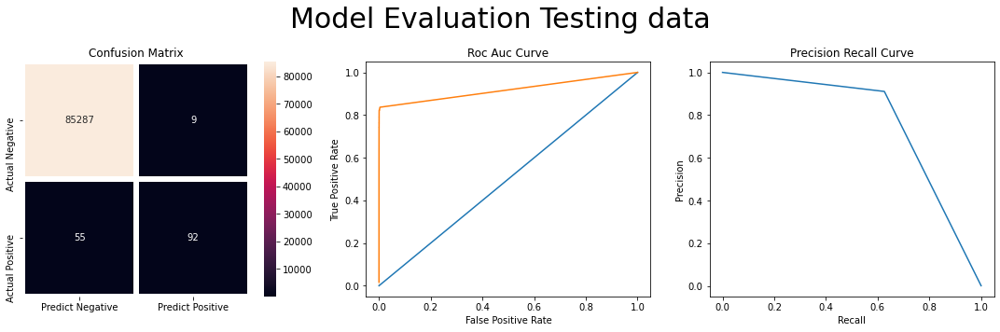

In [37]:
analyse(xgb_clf_gbtree, xtest, ytest, 'Testing')

The basic Model of XGBoost has high overfitting and after Hyperparameter tuning Results have declined significantly. So we wont use XGBoost with original data.

## Adaptive Boosting

For Training data
Correct Predictions: 199210
False Positives Type I error: 63
False Negatives Type II error: 91
Accuracy: 0.9992
Precision: 0.8013
Sensitivity: 0.7362
Specificity: 0.9997
F1: 0.7674
F_beta Recall Favoured 0.7484
Log_loss 0.0267
ROC AUC score 0.9989


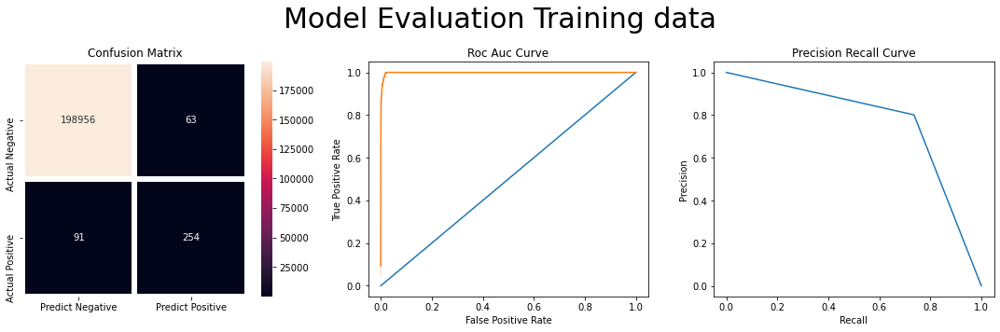

In [13]:
from sklearn.ensemble import AdaBoostClassifier
ada_clf = AdaBoostClassifier(n_estimators=50, learning_rate=1.0) # Base Estimator Decision Tree classifier
ada_clf.fit(xtrain, ytrain)
analyse(ada_clf, xtrain, ytrain, 'Training')

For Testing data
Correct Predictions: 85366
False Positives Type I error: 27
False Negatives Type II error: 50
Accuracy: 0.9991
Precision: 0.7823
Sensitivity: 0.6599
Specificity: 0.9997
F1: 0.7159
F_beta Recall Favoured 0.6812
Log_loss 0.0311
ROC AUC score 0.9697


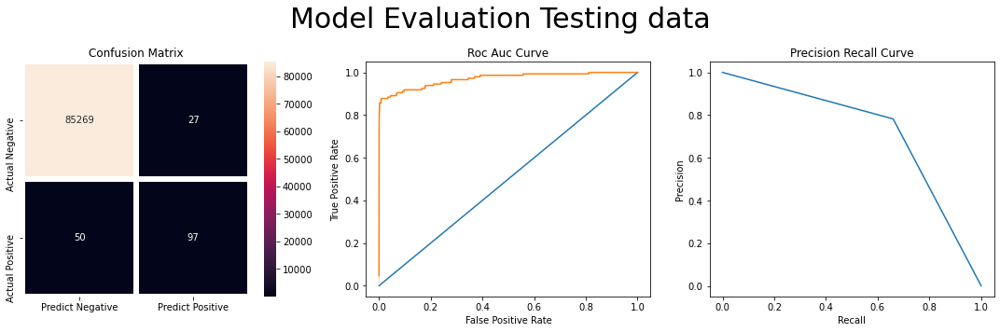

In [14]:
analyse(ada_clf, xtest, ytest, 'Testing')

Adaptive Boosting using Decision Tree estimator has high overfit and using Higher algorithms will make it computationally expensive so we won't use it.

# Oversampling the dataset to counter imbalance

Applied methods:

1. Synthetic Minority Oversampling Technique
2. Adaptive Synthetic Minority Oversampling Technique
3. Support Vector Machine Synthetic Minority Oversampling Technique

# SMOTE

In [26]:
# here we will oversample the positive class using SMOTE
from imblearn.over_sampling import SMOTE 
sm = SMOTE(random_state=0,  k_neighbors=17)  #k_neighbours = sqrt(training size(minority))
x, y = sm.fit_resample(xtrain, ytrain)
sm_df = pd.concat([x, y], axis = 1)
sm_df.shape

(398038, 31)

In [25]:
imb = sm_df[sm_df['Class'] == 1].shape[0]/sm_df.shape[0]
print(f'Percentage of dataset for target class <1> is {round(imb * 100, 4)} %')
print(f'Percentage of dataset for target class <0> is {round((1-imb)*100, 4)} %')

Percentage of dataset for target class <1> is 50.0 %
Percentage of dataset for target class <0> is 50.0 %


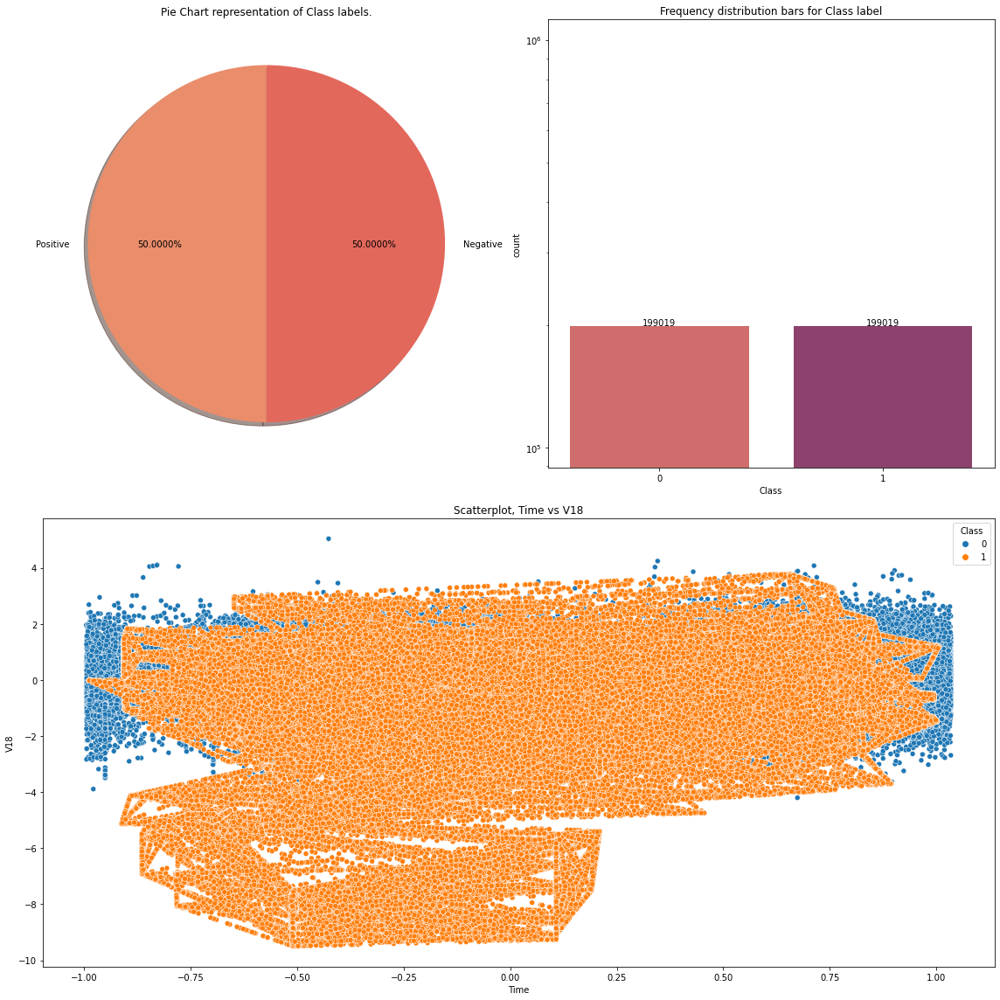

In [29]:
distribution2(sm_df)

After oversampling the data is now balanced so we shall be seeing a balanaced model which gives similar weight to both the classes. There is a possibility though of Greater number of False positive errors then before, affecting the Precision and F1 score so, we shall select the models which give sufficient recall score without much compromise in precision score.

For Testing data
Correct Predictions: 83375
False Positives Type I error: 2056
False Negatives Type II error: 12
Accuracy: 0.9758
Precision: 0.0616
Sensitivity: 0.9184
Specificity: 0.9759
F1: 0.1155
F_beta Recall Favoured 0.2429
Log_loss 0.836
ROC AUC score 0.9827


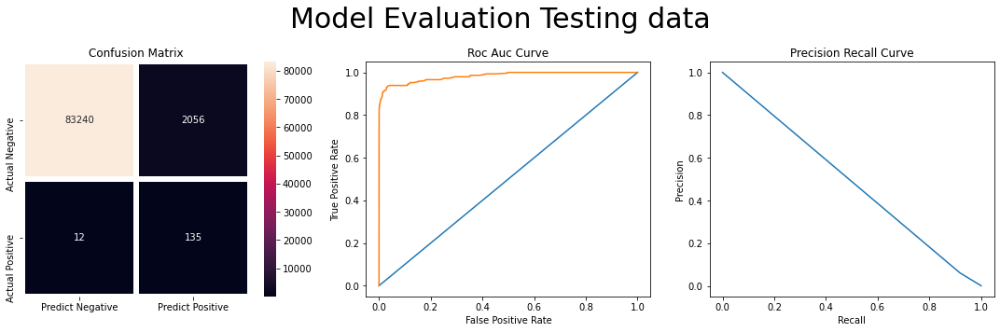

In [38]:
from sklearn.linear_model import LogisticRegression
logreg_smote = LogisticRegression()
logreg_smote.fit(x, y)
analyse(logreg_smote, xtest, ytest, 'Testing')

For Testing data
Correct Predictions: 84852
False Positives Type I error: 571
False Negatives Type II error: 20
Accuracy: 0.9931
Precision: 0.1819
Sensitivity: 0.8639
Specificity: 0.9933
F1: 0.3006
F_beta Recall Favoured 0.4938
Log_loss 0.2389
ROC AUC score 0.978


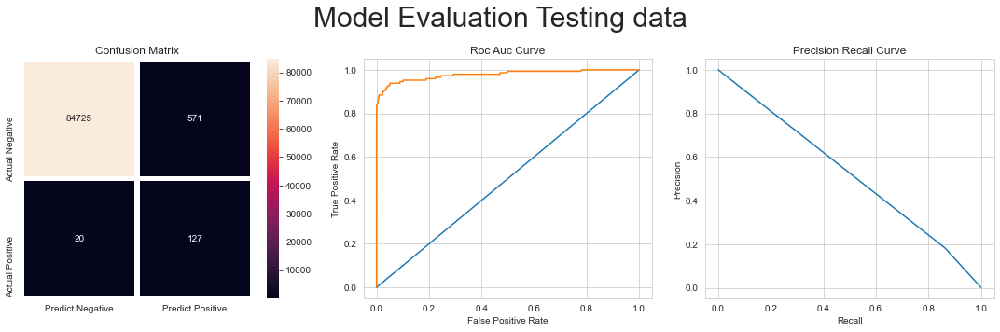

In [27]:
from sklearn.ensemble import RandomForestClassifier
rforest_smote = RandomForestClassifier(n_estimators = 50, max_depth=5, max_features=9)
rforest_smote.fit(x, y)
analyse(rforest_smote, xtest, ytest, 'Testing')

For Testing data
Correct Predictions: 85335
False Positives Type I error: 84
False Negatives Type II error: 24
Accuracy: 0.9987
Precision: 0.5942
Sensitivity: 0.8367
Specificity: 0.999
F1: 0.6949
F_beta Recall Favoured 0.7736
Log_loss 0.0437
ROC AUC score 0.9645


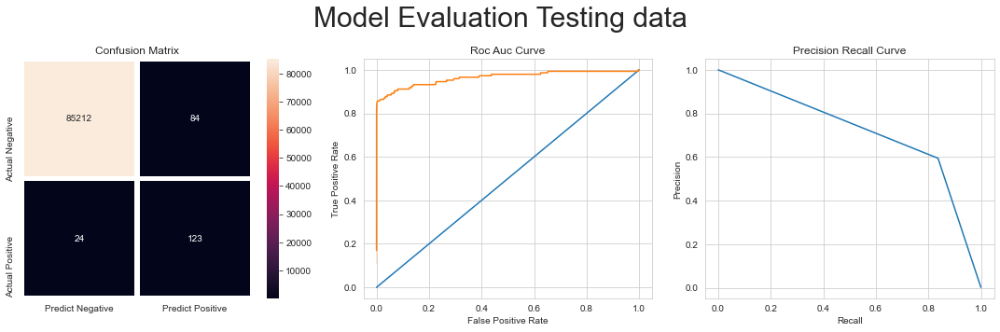

In [30]:
from xgboost.sklearn import XGBClassifier
params = {
            'booster':'gbtree',
            'objective':'binary:logistic',
            'max_depth': 5,
            'alpha': 10,
            'learning_rate': 1,
            'n_estimators':500,
            "eval_metric"      : ['logloss']
        }
xgb_clf_smote = XGBClassifier(**params)
xgb_clf_smote.fit(x,y)
analyse(xgb_clf_smote, xtest, ytest, 'Testing')

For Testing data
Correct Predictions: 83909
False Positives Type I error: 1514
False Negatives Type II error: 20
Accuracy: 0.982
Precision: 0.0774
Sensitivity: 0.8639
Specificity: 0.9823
F1: 0.1421
F_beta Recall Favoured 0.2849
Log_loss 0.6201
ROC AUC score 0.9677


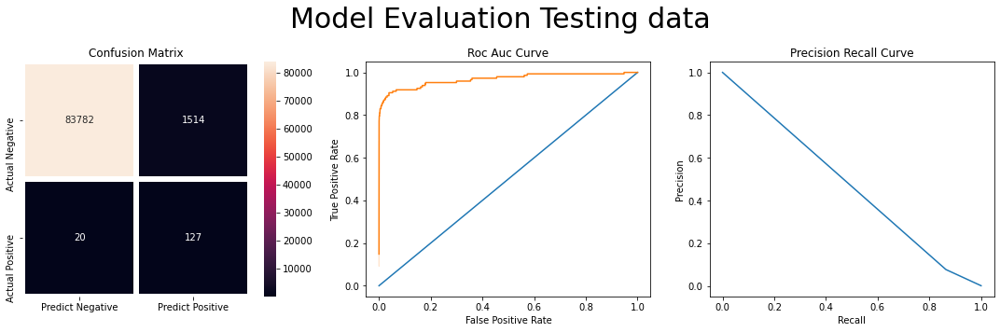

In [41]:
ada_clf_smote = AdaBoostClassifier(n_estimators=50, learning_rate=1.0)
ada_clf_smote.fit(x,y)
analyse(ada_clf_smote, xtest, ytest, 'Testing')

# ADASYN

In [31]:
from imblearn.over_sampling import ADASYN 
ada = ADASYN(random_state=0, n_neighbors=100)
xada, yada = ada.fit_resample(xtrain, ytrain)
ada_df = pd.concat([xada, yada], axis = 1)
ada_df.shape

(398059, 31)

In [32]:
imb = ada_df[ada_df['Class'] == 1].shape[0]/ada_df.shape[0]
print(f'Percentage of dataset for target class <1> is {round(imb * 100, 4)} %')
print(f'Percentage of dataset for target class <0> is {round((1-imb)*100, 4)} %')

Percentage of dataset for target class <1> is 50.0026 %
Percentage of dataset for target class <0> is 49.9974 %


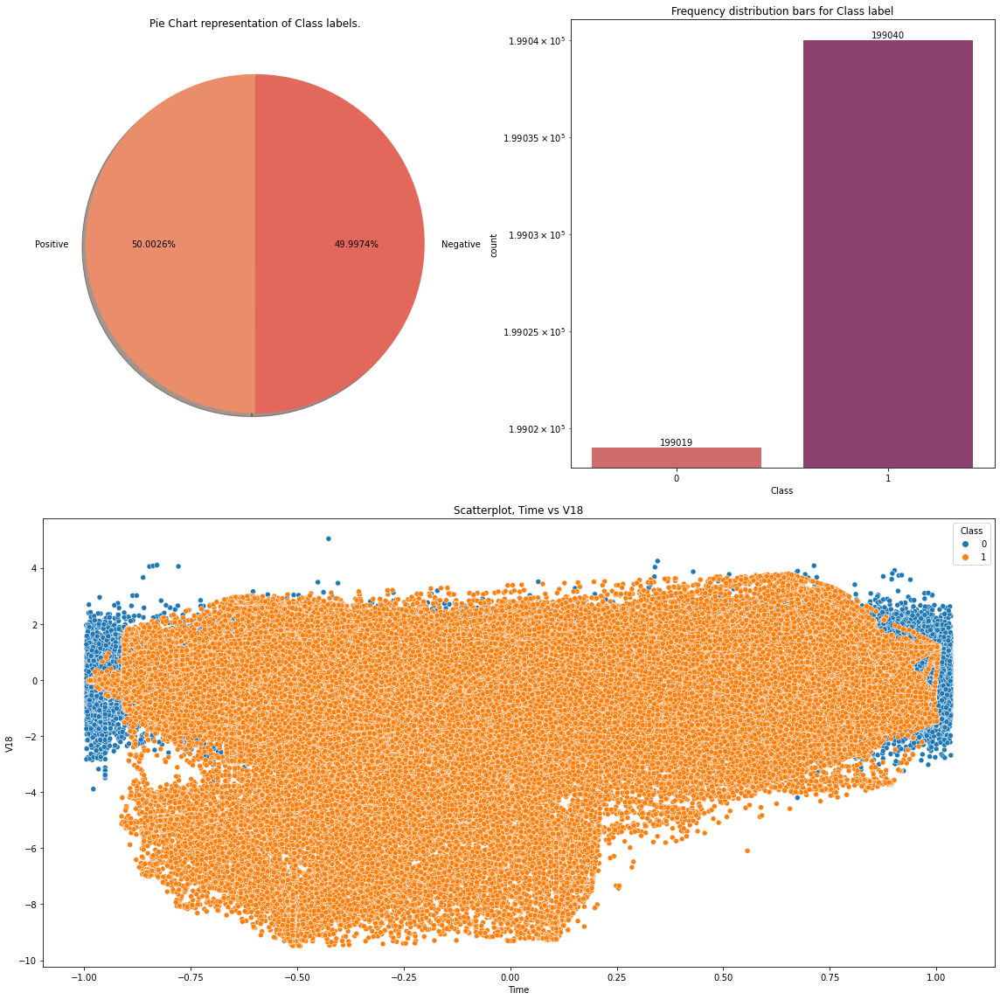

In [33]:
distribution2(ada_df)

The data is now balance using ADASYN oversampling, the distributrion of synthetic samples is different than in case of SMOTE.Moreover instead of creating equal number of instances in each class, it made slightly more for the class which was formarly minority class.

For Testing data
Correct Predictions: 82502
False Positives Type I error: 2931
False Negatives Type II error: 10
Accuracy: 0.9656
Precision: 0.0447
Sensitivity: 0.932
Specificity: 0.9656
F1: 0.0852
F_beta Recall Favoured 0.1874
Log_loss 1.1889
ROC AUC score 0.9837


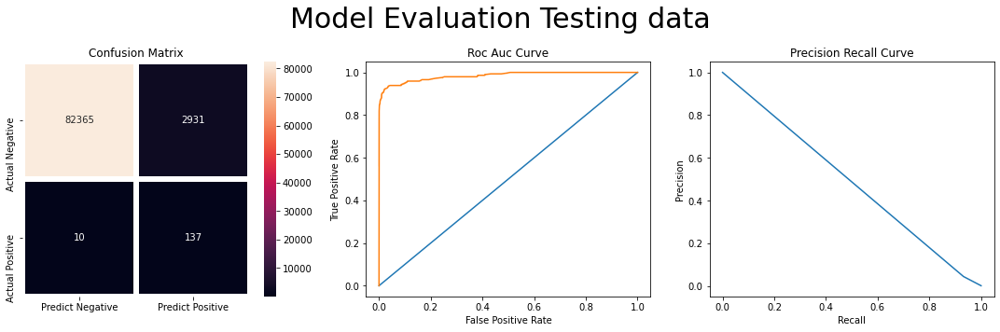

In [42]:
from sklearn.linear_model import LogisticRegression
logreg_adasyn = LogisticRegression()
logreg_adasyn.fit(xada, yada)
analyse(logreg_adasyn, xtest, ytest, 'Testing')

For Testing data
Correct Predictions: 84709
False Positives Type I error: 714
False Negatives Type II error: 20
Accuracy: 0.9914
Precision: 0.151
Sensitivity: 0.8639
Specificity: 0.9916
F1: 0.2571
F_beta Recall Favoured 0.4444
Log_loss 0.2967
ROC AUC score 0.9819


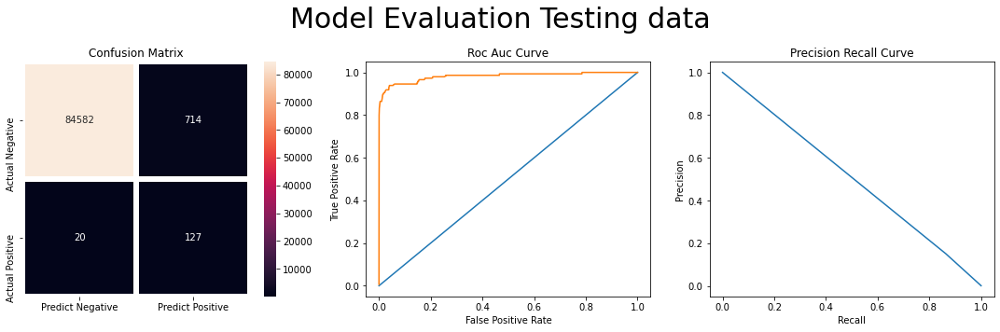

In [43]:
rforest_adasyn = RandomForestClassifier(max_depth=10, max_features=9)
rforest_adasyn.fit(xada, yada)
analyse(rforest_adasyn, xtest, ytest, 'Testing')

For Testing data
Correct Predictions: 85311
False Positives Type I error: 107
False Negatives Type II error: 25
Accuracy: 0.9985
Precision: 0.5328
Sensitivity: 0.8299
Specificity: 0.9987
F1: 0.6489
F_beta Recall Favoured 0.7466
Log_loss 0.0534
ROC AUC score 0.967


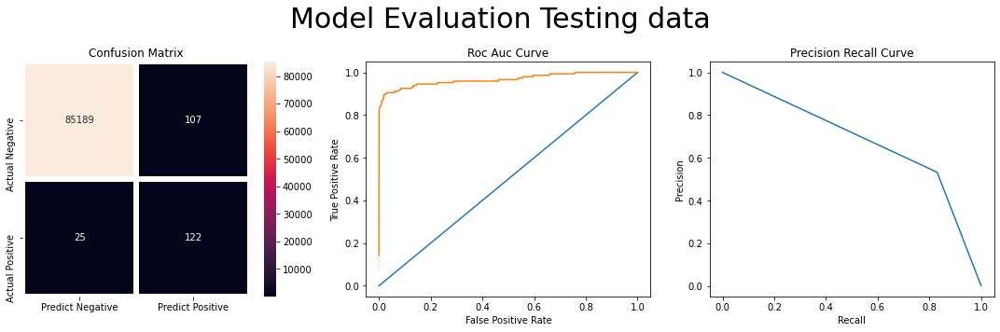

In [44]:
from xgboost.sklearn import XGBClassifier
params = {
            'booster':'gbtree',
            'objective':'binary:logistic',
            'max_depth': 5,
            'alpha': 10,
            'learning_rate': 1,
            'n_estimators':500,
            "eval_metric"      : ['logloss']
        }
xgb_clf_adasyn = XGBClassifier(**params)
xgb_clf_adasyn.fit(xada, yada)
analyse(xgb_clf_adasyn, xtest, ytest, 'Testing')

For Testing data
Correct Predictions: 83251
False Positives Type I error: 2174
False Negatives Type II error: 18
Accuracy: 0.9743
Precision: 0.056
Sensitivity: 0.8776
Specificity: 0.9745
F1: 0.1053
F_beta Recall Favoured 0.2231
Log_loss 0.8861
ROC AUC score 0.9652


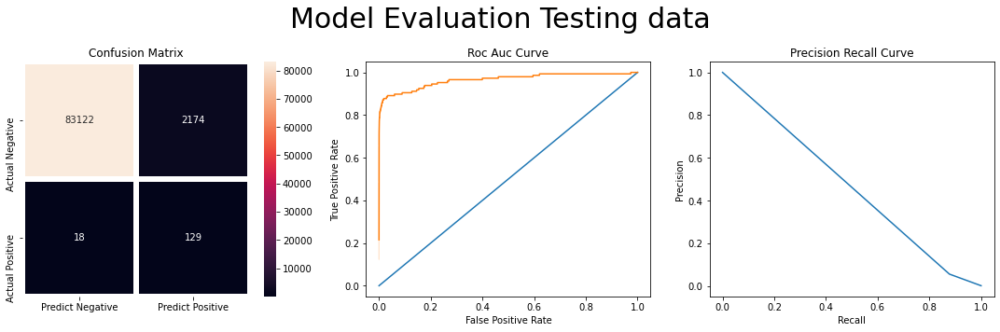

In [45]:
ada_clf_adasyn = AdaBoostClassifier(n_estimators=50, learning_rate=1.0)
ada_clf_adasyn.fit(xada,yada)
analyse(ada_clf_adasyn, xtest, ytest, 'Testing')

# SVM Smote

In [35]:
from imblearn.over_sampling import SVMSMOTE 
ssm = SVMSMOTE(random_state=0, k_neighbors=50)
xssm, yssm = ssm.fit_resample(xtrain, ytrain)
ssm_df = pd.concat([xssm, yssm], axis = 1)
ssm_df.shape

(398038, 31)

In [10]:
imb = ssm_df[ssm_df['Class'] == 1].shape[0]/ssm_df.shape[0]
print(f'Percentage of dataset for target class <1> is {round(imb * 100, 4)} %')
print(f'Percentage of dataset for target class <0> is {round((1-imb)*100, 4)} %')

Percentage of dataset for target class <1> is 50.0 %
Percentage of dataset for target class <0> is 50.0 %


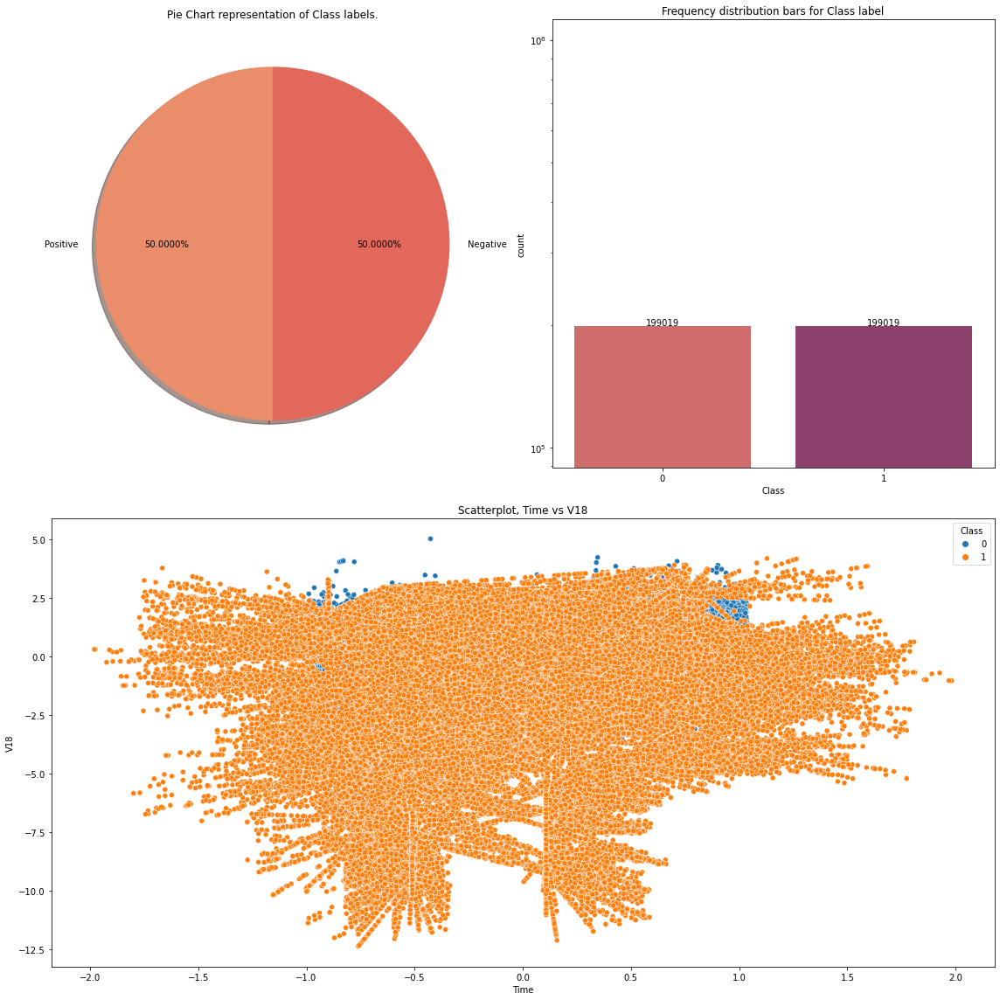

In [11]:
distribution2(ssm_df)

The distribution is balanced using oversampling via SVM based Smote. Although the oversampling technique is computationally expensive, vivid distribution of minority class oversamples was achieved and since it densifies the boundries between classes, tree based algorithms would easily distinguish between classes.

For Testing data
Correct Predictions: 84097
False Positives Type I error: 1330
False Negatives Type II error: 16
Accuracy: 0.9842
Precision: 0.0897
Sensitivity: 0.8912
Specificity: 0.9844
F1: 0.1629
F_beta Recall Favoured 0.3197
Log_loss 0.5441
ROC AUC score 0.9745


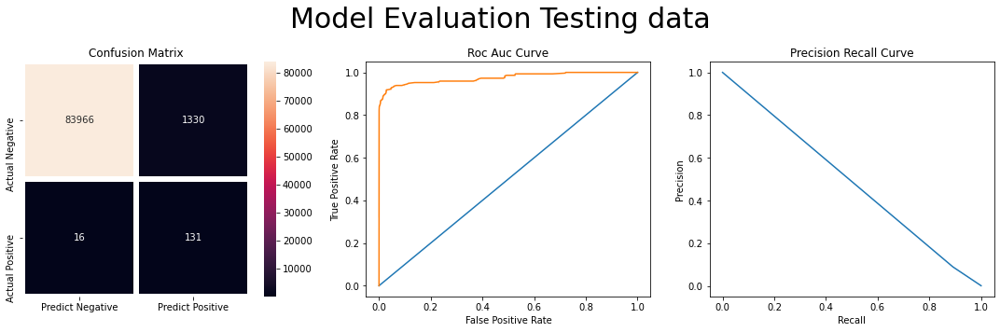

In [12]:
from sklearn.linear_model import LogisticRegression
logreg_svm = LogisticRegression()
logreg_svm.fit(xssm, yssm)
analyse(logreg_svm, xtest, ytest, 'Testing')

For Testing data
Correct Predictions: 85179
False Positives Type I error: 244
False Negatives Type II error: 20
Accuracy: 0.9969
Precision: 0.3423
Sensitivity: 0.8639
Specificity: 0.9971
F1: 0.4903
F_beta Recall Favoured 0.6621
Log_loss 0.1067
ROC AUC score 0.9803


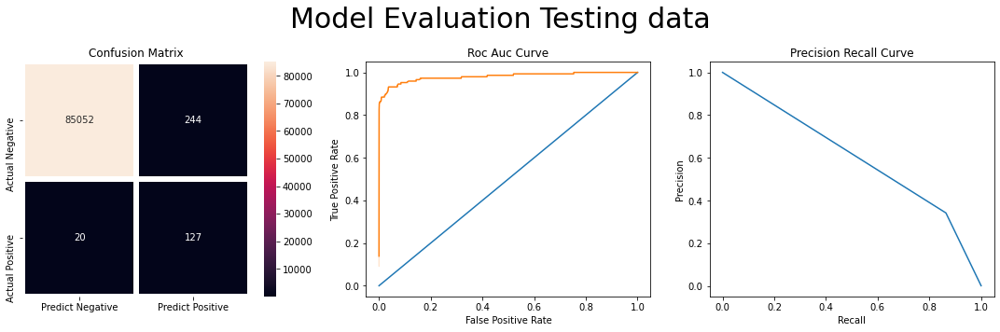

In [13]:
from sklearn.ensemble import RandomForestClassifier
rforest_svm = RandomForestClassifier(max_depth=10, max_features=9)
rforest_svm.fit(xssm, yssm)
analyse(rforest_svm, xtest, ytest, 'Testing')

For Testing data
Correct Predictions: 85344
False Positives Type I error: 76
False Negatives Type II error: 23
Accuracy: 0.9988
Precision: 0.62
Sensitivity: 0.8435
Specificity: 0.9991
F1: 0.7147
F_beta Recall Favoured 0.7868
Log_loss 0.04
ROC AUC score 0.9746


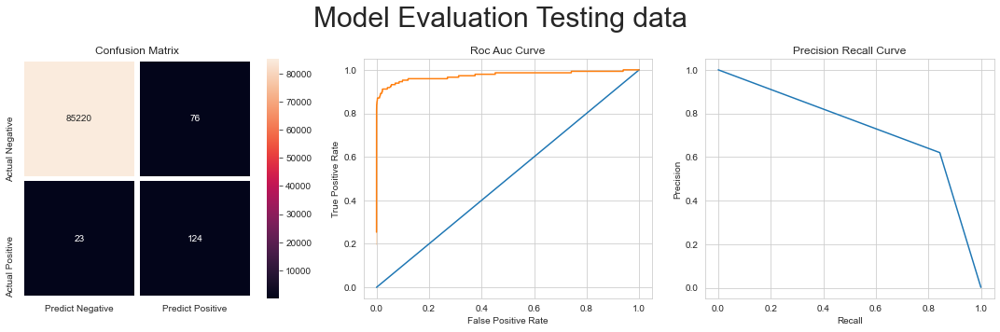

In [36]:
from xgboost.sklearn import XGBClassifier
params = {
            'booster':'gbtree',
            'objective':'binary:logistic',
            'max_depth': 5,
            'alpha': 10,
            'learning_rate': 1,
            'n_estimators':500,
            "eval_metric"      : ['logloss']
        }
xgb_clf_svm = XGBClassifier(**params)
xgb_clf_svm.fit(xssm, yssm)
analyse(xgb_clf_svm, xtest, ytest, 'Testing')

For Testing data
Correct Predictions: 84586
False Positives Type I error: 839
False Negatives Type II error: 18
Accuracy: 0.99
Precision: 0.1333
Sensitivity: 0.8776
Specificity: 0.9902
F1: 0.2314
F_beta Recall Favoured 0.4145
Log_loss 0.3464
ROC AUC score 0.9655


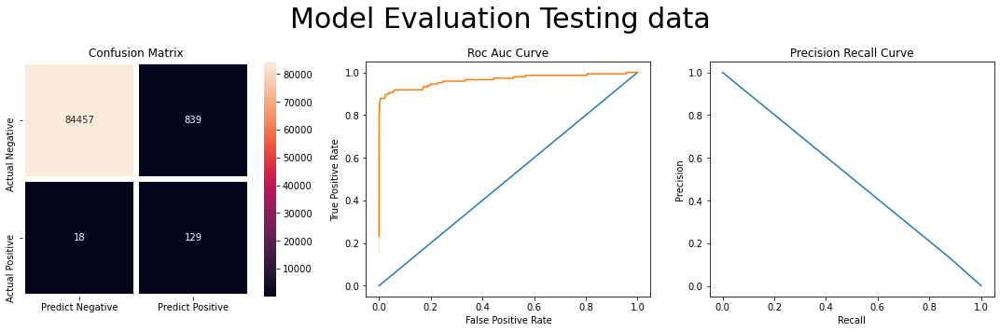

In [15]:
from sklearn.ensemble import AdaBoostClassifier
ada_clf_svm = AdaBoostClassifier(n_estimators=50, learning_rate=1.0)
ada_clf_svm.fit(xssm,yssm)
analyse(ada_clf_svm, xtest, ytest, 'Testing')

Here we have seen effects of three oversmapling techniques namely, SMOTE, ADASYN and SVM-Smote.
1. Good results can be seen in case of XGBoost trained on data oversampled using SMOTE and SVM Smote
2. ADASYN has no good advantage over others as Type one errors are very high fo models trained on this data.
3. Random Forest Classifier Works good with SMOTE oversampled data so we will also include it for further analysis.

# Using Class weight hyperparameter instead of Over Sampling

Manual method of calculating Class Wights
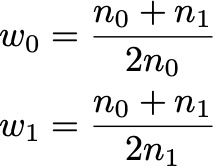

In [16]:
ytrain.shape[0]

199364

In [17]:
w0 = ytrain.shape[0]/(2* ytrain.value_counts()[0]) # weight of Class <0>
w1 = ytrain.shape[0]/(2* ytrain.value_counts()[1]) # weight of Class <1>
print('weight of Class <0>', w0)
print('weight of Class <1>', w1)

weight of Class <0> 0.500866751415694
weight of Class <1> 288.93333333333334


In [18]:
# Scaling weights
scale = 1/w0
w1 = scale * w1
w0 = 1 
print('weight of Class <0>', w0)
print('weight of Class <1>', w1)

weight of Class <0> 1
weight of Class <1> 576.8666666666666


For Training data
Correct Predictions: 194723
False Positives Type I error: 4613
False Negatives Type II error: 28
Accuracy: 0.9767
Precision: 0.0643
Sensitivity: 0.9188
Specificity: 0.9768
F1: 0.1202
F_beta Recall Favoured 0.2512
Log_loss 0.804
ROC AUC score 0.9877


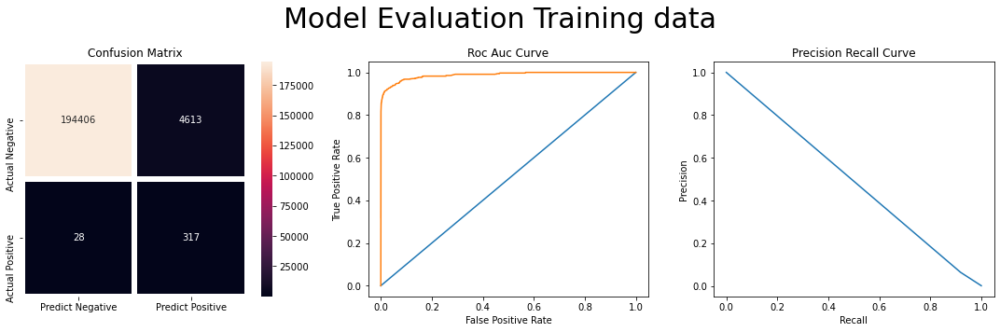

In [19]:
from sklearn.linear_model import LogisticRegression
logreg_weighted_manual = LogisticRegression(class_weight={0: 1, 1: 576.86})
logreg_weighted_manual.fit(xtrain, ytrain)
analyse(logreg_weighted_manual, xtrain, ytrain, 'Training')

For Testing data
Correct Predictions: 83516
False Positives Type I error: 1915
False Negatives Type II error: 12
Accuracy: 0.9774
Precision: 0.0659
Sensitivity: 0.9184
Specificity: 0.9775
F1: 0.1229
F_beta Recall Favoured 0.2559
Log_loss 0.779
ROC AUC score 0.9838


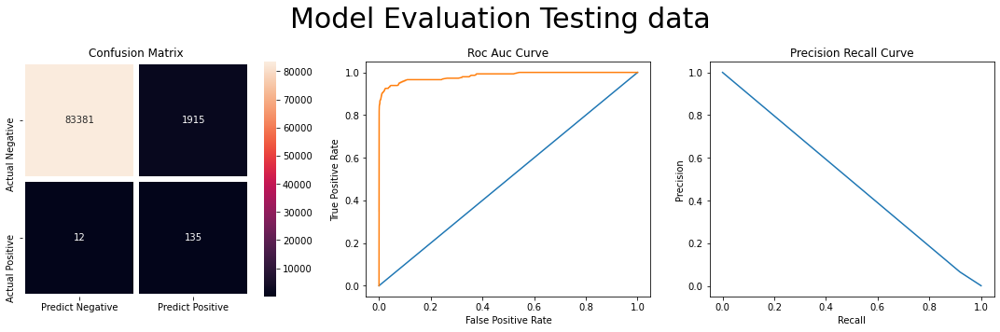

In [20]:
analyse(logreg_weighted_manual, xtest, ytest, 'Testing')

Logestic regression has high sensitivity without any visible overfitting. Despite the fact that False Positive errors have become prominent, we will use it.

For Training data
Correct Predictions: 194726
False Positives Type I error: 4610
False Negatives Type II error: 28
Accuracy: 0.9767
Precision: 0.0643
Sensitivity: 0.9188
Specificity: 0.9768
F1: 0.1203
F_beta Recall Favoured 0.2513
Log_loss 0.8035
ROC AUC score 0.9877


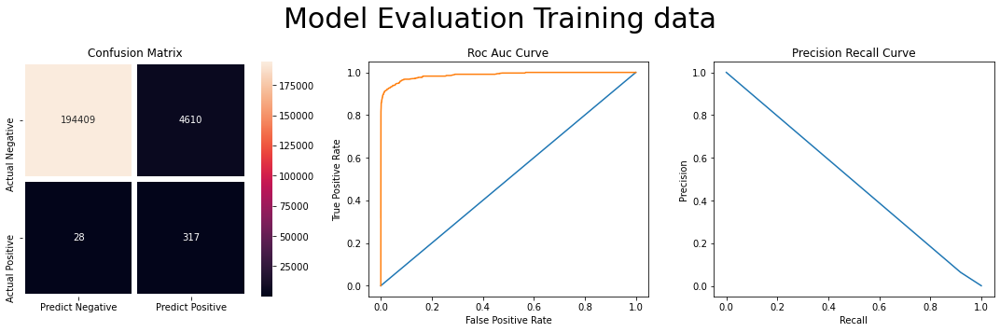

In [21]:
from sklearn.linear_model import LogisticRegression
logreg_weighted_balanced = LogisticRegression(class_weight= 'balanced')
logreg_weighted_balanced.fit(xtrain, ytrain)
analyse(logreg_weighted_balanced, xtrain, ytrain, 'Training')

For Testing data
Correct Predictions: 83517
False Positives Type I error: 1914
False Negatives Type II error: 12
Accuracy: 0.9775
Precision: 0.0659
Sensitivity: 0.9184
Specificity: 0.9776
F1: 0.123
F_beta Recall Favoured 0.256
Log_loss 0.7786
ROC AUC score 0.9838


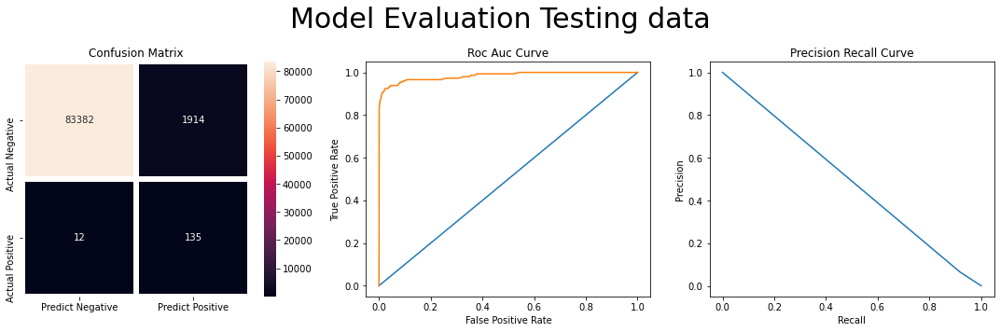

In [22]:
analyse(logreg_weighted_balanced, xtest, ytest, 'Testing')

We also have inbuilt parameters for class weights namely 'balanced' and 'balanced_subsample' we shall check them simultaneously with manually calculated class weights.

The “balanced” mode uses the values of y to automatically adjust weights inversely proportional to class frequencies in the input data as n_samples / (n_classes * np.bincount(y))

The “balanced_subsample” mode is the same as “balanced” except that weights are computed based on the bootstrap sample for every tree grown.

At first the calcuated class weightwas used with the algorithms and then its value was manually changed to deal with overfitting. the models that appear here are manually altered.

For Training data
Correct Predictions: 199072
False Positives Type I error: 244
False Negatives Type II error: 48
Accuracy: 0.9985
Precision: 0.549
Sensitivity: 0.8609
Specificity: 0.9988
F1: 0.6704
F_beta Recall Favoured 0.773
Log_loss 0.0506
ROC AUC score 0.9843


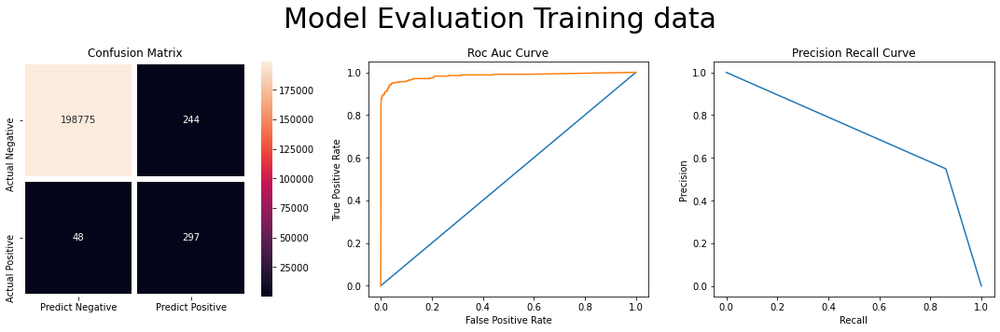

In [20]:
# checking performance of manually calculated class weights
from sklearn.ensemble import RandomForestClassifier
rforest_weighted_manual = RandomForestClassifier(max_depth=3, max_features=9,
                                                 class_weight={0: 1, 1: 300})
rforest_weighted_manual.fit(xtrain, ytrain)
analyse(rforest_weighted_manual, xtrain, ytrain, 'Training')

For Testing data
Correct Predictions: 85328
False Positives Type I error: 91
False Negatives Type II error: 24
Accuracy: 0.9987
Precision: 0.5748
Sensitivity: 0.8367
Specificity: 0.9989
F1: 0.6814
F_beta Recall Favoured 0.7668
Log_loss 0.0465
ROC AUC score 0.9674


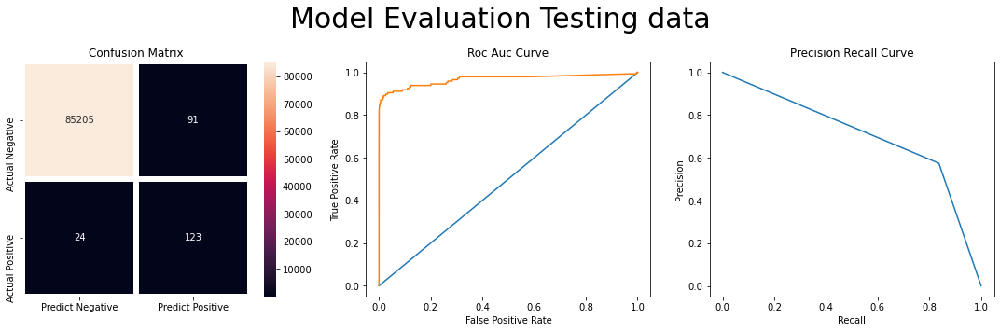

In [21]:
analyse(rforest_weighted_manual, xtest, ytest, 'Testing')

For Training data
Correct Predictions: 199322
False Positives Type I error: 39
False Negatives Type II error: 3
Accuracy: 0.9998
Precision: 0.8976
Sensitivity: 0.9913
Specificity: 0.9998
F1: 0.9421
F_beta Recall Favoured 0.971
Log_loss 0.0073
ROC AUC score 0.9999


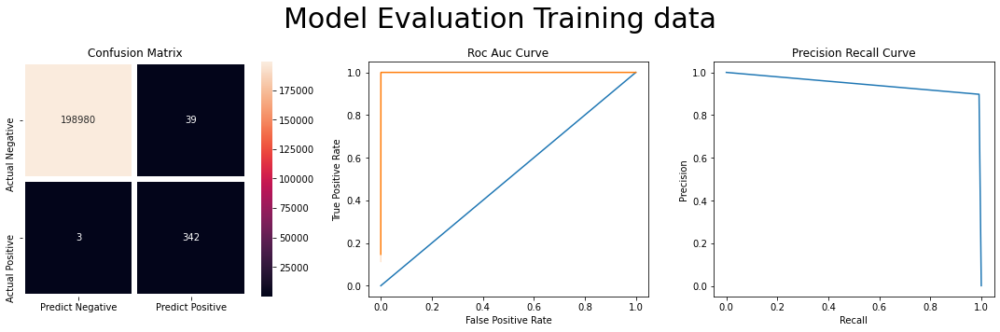

In [25]:
# checking performance of inbuilt parameter 'balanced' for class weights
from sklearn.ensemble import RandomForestClassifier
rforest_weighted_balanced = RandomForestClassifier(max_depth=10, max_features=9, class_weight='balanced')
rforest_weighted_balanced.fit(xtrain, ytrain)
analyse(rforest_weighted_balanced,  xtrain, ytrain, 'Training')

For Testing data
Correct Predictions: 85398
False Positives Type I error: 16
False Negatives Type II error: 29
Accuracy: 0.9995
Precision: 0.8806
Sensitivity: 0.8027
Specificity: 0.9998
F1: 0.8399
F_beta Recall Favoured 0.8172
Log_loss 0.0182
ROC AUC score 0.9808


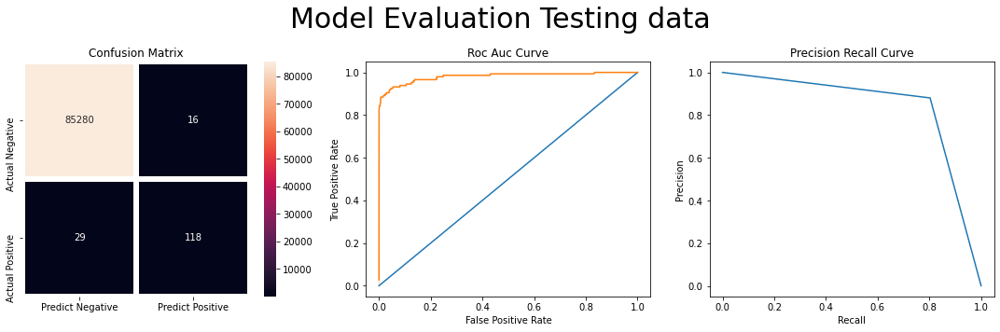

In [26]:
analyse(rforest_weighted_balanced, xtest, ytest, 'Testing')

For Training data
Correct Predictions: 199320
False Positives Type I error: 41
False Negatives Type II error: 3
Accuracy: 0.9998
Precision: 0.893
Sensitivity: 0.9913
Specificity: 0.9998
F1: 0.9396
F_beta Recall Favoured 0.9699
Log_loss 0.0076
ROC AUC score 0.9999


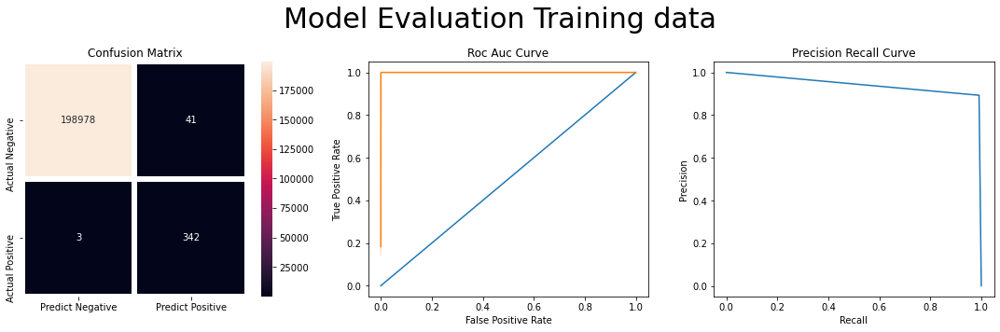

In [27]:
# checking performance of inbuilt parameter 'balanced_subsample' for class weights
from sklearn.ensemble import RandomForestClassifier
rforest_weighted_balanced_ss = RandomForestClassifier(max_depth=10, max_features=9, class_weight='balanced_subsample')
rforest_weighted_balanced_ss.fit(xtrain, ytrain)
analyse(rforest_weighted_balanced_ss,xtrain, ytrain, 'Training')

For Testing data
Correct Predictions: 85398
False Positives Type I error: 16
False Negatives Type II error: 29
Accuracy: 0.9995
Precision: 0.8806
Sensitivity: 0.8027
Specificity: 0.9998
F1: 0.8399
F_beta Recall Favoured 0.8172
Log_loss 0.0182
ROC AUC score 0.9729


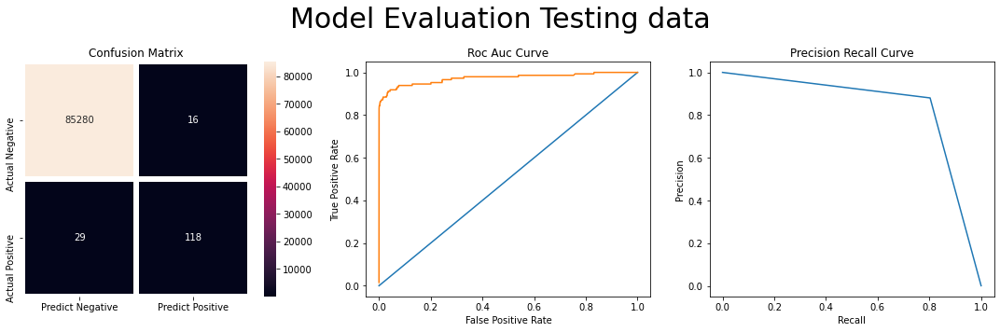

In [28]:
analyse(rforest_weighted_balanced_ss, xtest, ytest, 'Testing')

XGBoost has hyperparameter scale_pos_weight in its core library which takes in manually calculated weights.  
 
 Scaled weight of class 1

For Training data
Correct Predictions: 198053
False Positives Type I error: 1249
False Negatives Type II error: 62
Accuracy: 0.9934
Precision: 0.1847
Sensitivity: 0.8203
Specificity: 0.9937
F1: 0.3015
F_beta Recall Favoured 0.4859
Log_loss 0.2271
ROC AUC score 0.907


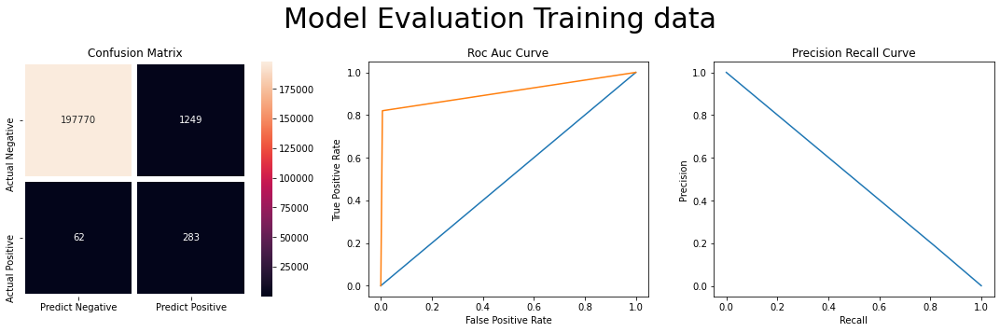

In [22]:
from xgboost.sklearn import XGBClassifier
params = {
            'objective':'binary:logistic',
            'max_depth': 5,
            'alpha': 10,
            'learning_rate': 10,
            'n_estimators':500,
            "eval_metric"      : ['logloss'],
            
        }         
           
          
# instantiate the classifier 
xgb_clf_weighted_manual = XGBClassifier(**params, scale_pos_weight= 400)
xgb_clf_weighted_manual.fit(xtrain, ytrain)
analyse(xgb_clf_weighted_manual, xtrain, ytrain, 'Training')

For Testing data
Correct Predictions: 84896
False Positives Type I error: 519
False Negatives Type II error: 28
Accuracy: 0.9936
Precision: 0.1865
Sensitivity: 0.8095
Specificity: 0.9939
F1: 0.3032
F_beta Recall Favoured 0.4853
Log_loss 0.2211
ROC AUC score 0.9017


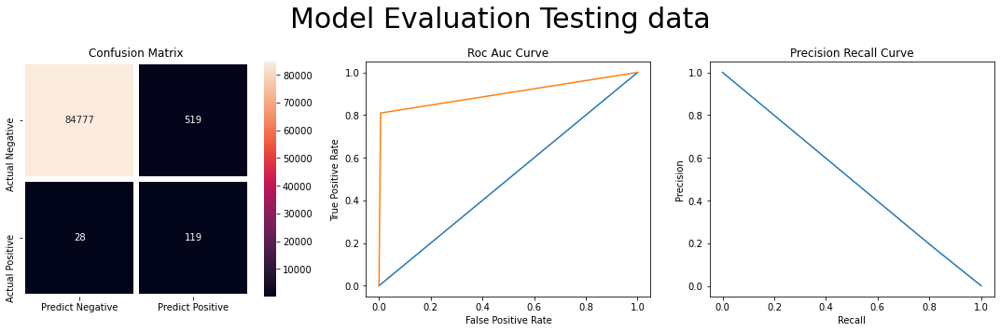

In [23]:
analyse(xgb_clf_weighted_manual, xtest, ytest, 'Testing')